## Data Analytics Capstone Project
## Education Success Rates based on Various factors 

## Introduction
This project focuses on Education. Education is often the most important pillar
of success in the world today. Success in the classroom can be a good indicator
of future success in employment, as well as be the beginning of a life of financial
fulfillment. The data problems that this project hopes to analyze, are the factors
that lead to student success in schools vs factors that lead to failure in schools.
This is significantly important in today’s world, because education is proven to
be very important in the future success of most people. This Project will attempt
to highlight the main factors that lead to student success and student failures,
so that people can be more aware of them.

## Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm
import matplotlib as mpl
import warnings 
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
%matplotlib inline

## Data Collection
<b>This data source is a source that contains information about academic success
and some variables that are connected to it. This source is found on Kaggle
Education Success Rates based on Various factors.
 and it is called ”Predict Student’s Dropout, Academic Success”

## Data Loading
<br><b> loading data from a CSV file named "data.csv" using the pandas library in Python.

In [2]:
## read a CSV file 
df = pd.read_csv("data.csv")
print(df)

      Marital status  Application mode  Application order  Course  \
0                  1                17                  5     171   
1                  1                15                  1    9254   
2                  1                 1                  5    9070   
3                  1                17                  2    9773   
4                  2                39                  1    8014   
...              ...               ...                ...     ...   
4419               1                 1                  6    9773   
4420               1                 1                  2    9773   
4421               1                 1                  1    9500   
4422               1                 1                  1    9147   
4423               1                10                  1    9773   

      Daytime/evening attendance\t  Previous qualification  \
0                                1                       1   
1                                1             

# Exploratory Data Analysis

<b>
Exploratory Data Analysis (EDA) is a critical initial step in the data analysis process. It involves examining and visualizing the dataset to gain a <b>better understanding of its characteristics, structure, and relationships between variables.

## Data Summary:
<b> Start by obtaining a general overview of the dataset using functions like head(), info(), tail(), dtypes, counts() and describe() to look at the first few rows, data types, and summary statistics.

In [3]:
# View all of the data
# View all of the Rows of the DataFrame:
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


In [4]:
# View the data
# View the First Few Rows of the DataFrame:
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate


In [5]:
# display the last few rows of DataFrame
df.tail()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate
4423,1,10,1,9773,1,1,152.0,22,38,37,...,0,6,6,6,13.000000,0,12.7,3.7,-1.70,Graduate


In [6]:
# check the shape 
df.shape

(4424, 37)

In [7]:
# Check the Basic Information about the DataFrame:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4424 entries, 0 to 4423
Data columns (total 37 columns):
 #   Column                                          Non-Null Count  Dtype  
---  ------                                          --------------  -----  
 0   Marital status                                  4424 non-null   int64  
 1   Application mode                                4424 non-null   int64  
 2   Application order                               4424 non-null   int64  
 3   Course                                          4424 non-null   int64  
 4   Daytime/evening attendance	                     4424 non-null   int64  
 5   Previous qualification                          4424 non-null   int64  
 6   Previous qualification (grade)                  4424 non-null   float64
 7   Nacionality                                     4424 non-null   int64  
 8   Mother's qualification                          4424 non-null   int64  
 9   Father's qualification                   

In [8]:
##  Display the type of DataFrame
df.dtypes

Marital status                                      int64
Application mode                                    int64
Application order                                   int64
Course                                              int64
Daytime/evening attendance\t                        int64
Previous qualification                              int64
Previous qualification (grade)                    float64
Nacionality                                         int64
Mother's qualification                              int64
Father's qualification                              int64
Mother's occupation                                 int64
Father's occupation                                 int64
Admission grade                                   float64
Displaced                                           int64
Educational special needs                           int64
Debtor                                              int64
Tuition fees up to date                             int64
Gender        

In [9]:
# Summary Statistics:
df.describe()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
count,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,...,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000
mean,1.178571,18.669078,1.727848,8856.642631,0.890823,4.577758,132.613314,1.873192,19.561935,22.275316,...,0.137658,0.541817,6.232143,8.063291,4.435805,10.230206,0.150316,11.566139,1.228029,0.001969
std,0.605747,17.484682,1.313793,2063.566416,0.311897,10.216592,13.188332,6.914514,15.603186,15.343108,...,0.690880,1.918546,2.195951,3.947951,3.014764,5.210808,0.753774,2.663850,1.382711,2.269935
min,1.000000,1.000000,0.000000,33.000000,0.000000,1.000000,95.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.600000,-0.800000,-4.060000
25%,1.000000,1.000000,1.000000,9085.000000,1.000000,1.000000,125.000000,1.000000,2.000000,3.000000,...,0.000000,0.000000,5.000000,6.000000,2.000000,10.750000,0.000000,9.400000,0.300000,-1.700000
50%,1.000000,17.000000,1.000000,9238.000000,1.000000,1.000000,133.100000,1.000000,19.000000,19.000000,...,0.000000,0.000000,6.000000,8.000000,5.000000,12.200000,0.000000,11.100000,1.400000,0.320000
75%,1.000000,39.000000,2.000000,9556.000000,1.000000,1.000000,140.000000,1.000000,37.000000,37.000000,...,0.000000,0.000000,7.000000,10.000000,6.000000,13.333333,0.000000,13.900000,2.600000,1.790000
max,6.000000,57.000000,9.000000,9991.000000,1.000000,43.000000,190.000000,109.000000,44.000000,44.000000,...,12.000000,19.000000,23.000000,33.000000,20.000000,18.571429,12.000000,16.200000,3.700000,3.510000


In [10]:
# Displaying the first 10 rows of DataFrame:
df.head(10)

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
5,2,39,1,9991,0,19,133.1,1,37,37,...,0,5,17,5,11.500000,5,16.2,0.3,-0.92,Graduate
6,1,1,1,9500,1,1,142.0,1,19,38,...,0,8,8,8,14.345000,0,15.5,2.8,-4.06,Graduate
7,1,18,4,9254,1,1,119.0,1,37,37,...,0,5,5,0,0.000000,0,15.5,2.8,-4.06,Dropout
8,1,1,3,9238,1,1,137.0,62,1,1,...,0,6,7,6,14.142857,0,16.2,0.3,-0.92,Graduate
9,1,1,1,9238,1,1,138.0,1,1,19,...,0,6,14,2,13.500000,0,8.9,1.4,3.51,Dropout


In [11]:
# view the column names of  DataFrame:
df.columns

Index(['Marital status', 'Application mode', 'Application order', 'Course',
       'Daytime/evening attendance\t', 'Previous qualification',
       'Previous qualification (grade)', 'Nacionality',
       'Mother's qualification', 'Father's qualification',
       'Mother's occupation', 'Father's occupation', 'Admission grade',
       'Displaced', 'Educational special needs', 'Debtor',
       'Tuition fees up to date', 'Gender', 'Scholarship holder',
       'Age at enrollment', 'International',
       'Curricular units 1st sem (credited)',
       'Curricular units 1st sem (enrolled)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (approved)',
       'Curricular units 1st sem (grade)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (enrolled)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (approved)',
       'Curricular units 2nd

In [12]:
#  count the unique values in a specific column called "Target" 
df.Target.value_counts()

Graduate    2209
Dropout     1421
Enrolled     794
Name: Target, dtype: int64

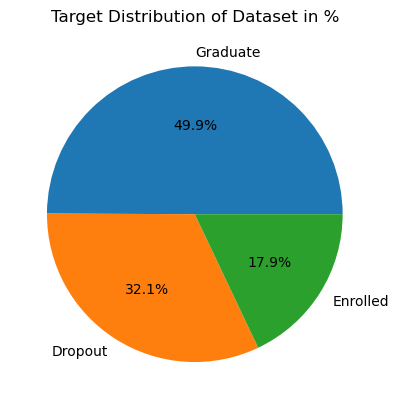

In [13]:
#store the value counts in a variable
students_target =df['Target'].value_counts()

#visualize the target variable
plt.pie(students_target, labels=students_target.index, autopct='%2.1f%%')
plt.title('Target Distribution of Dataset in %')
plt.show()

In [14]:
#  To count the number of unique values in each column of a DataFrame.
df.nunique()

Marital status                                      6
Application mode                                   18
Application order                                   8
Course                                             17
Daytime/evening attendance\t                        2
Previous qualification                             17
Previous qualification (grade)                    101
Nacionality                                        21
Mother's qualification                             29
Father's qualification                             34
Mother's occupation                                32
Father's occupation                                46
Admission grade                                   620
Displaced                                           2
Educational special needs                           2
Debtor                                              2
Tuition fees up to date                             2
Gender                                              2
Scholarship holder          

In [15]:
# To count the number of unique values in  column 'Age at enrollment' of a DataFrame.
df['Age at enrollment'].unique()

array([20, 19, 45, 50, 18, 22, 21, 34, 37, 43, 55, 39, 29, 24, 27, 23, 26,
       33, 35, 25, 44, 36, 47, 28, 38, 30, 31, 32, 40, 42, 48, 49, 46, 41,
       70, 60, 53, 51, 52, 54, 61, 58, 59, 17, 57, 62], dtype=int64)

##  Data Cleaning and Preprocessing

<b> Data cleaning and preprocessing are crucial steps in any data analysis or machine learning project, including those related to education success rates. These steps help ensure that data is accurate, consistent, and ready for analysis. Here are the key steps involved in data cleaning and preprocessing:

<b>1) Handling Missing Data:</b>

In [16]:
## Checking for null values
df.isnull().sum()

Marital status                                    0
Application mode                                  0
Application order                                 0
Course                                            0
Daytime/evening attendance\t                      0
Previous qualification                            0
Previous qualification (grade)                    0
Nacionality                                       0
Mother's qualification                            0
Father's qualification                            0
Mother's occupation                               0
Father's occupation                               0
Admission grade                                   0
Displaced                                         0
Educational special needs                         0
Debtor                                            0
Tuition fees up to date                           0
Gender                                            0
Scholarship holder                                0
Age at enrol

In [17]:
# Check for missing values
missing_values = df.isna().sum()
missing_values

Marital status                                    0
Application mode                                  0
Application order                                 0
Course                                            0
Daytime/evening attendance\t                      0
Previous qualification                            0
Previous qualification (grade)                    0
Nacionality                                       0
Mother's qualification                            0
Father's qualification                            0
Mother's occupation                               0
Father's occupation                               0
Admission grade                                   0
Displaced                                         0
Educational special needs                         0
Debtor                                            0
Tuition fees up to date                           0
Gender                                            0
Scholarship holder                                0
Age at enrol

In [18]:
# Remove rows with missing values
df.dropna(inplace=True)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


In [19]:
#Checking the types of the data columns
df.dtypes

Marital status                                      int64
Application mode                                    int64
Application order                                   int64
Course                                              int64
Daytime/evening attendance\t                        int64
Previous qualification                              int64
Previous qualification (grade)                    float64
Nacionality                                         int64
Mother's qualification                              int64
Father's qualification                              int64
Mother's occupation                                 int64
Father's occupation                                 int64
Admission grade                                   float64
Displaced                                           int64
Educational special needs                           int64
Debtor                                              int64
Tuition fees up to date                             int64
Gender        

In [20]:
# Impute missing values
df['Nacionality'].fillna(df['Nacionality'].mean(), inplace=True)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


In [21]:
# Specify the columns for which I want to fill missing values with their means
columns_to_fill = ['Marital status', 'Application mode', 'Application order']

# Fill missing values with the means of the specified columns
df[columns_to_fill] = df[columns_to_fill].fillna(df[columns_to_fill].mean())

# Display the first few rows of the DataFrame to verify the changes
df.head()


,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate


<b> 2- Handling Duplicates:<br></b>
    Check for and remove duplicate rows to avoid redundancy in the dataset.

In [22]:
# Check for duplicates
duplicates = df.duplicated()

# Remove duplicates
df.drop_duplicates(inplace=True)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


<B>3- Rounding all the float values present inside the dataset into its nearest number</B>

In [23]:
# Round all float columns to the nearest whole number (0 decimal places)
df = df.round(0)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.0,0,11.0,1.0,2.0,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,14.0,0,14.0,-0.0,1.0,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.0,0,11.0,1.0,2.0,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.0,0,9.0,-1.0,-3.0,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.0,0,14.0,-0.0,1.0,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,13.0,0,16.0,3.0,-4.0,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.0,0,11.0,1.0,2.0,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,14.0,0,14.0,-0.0,1.0,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.0,0,9.0,-1.0,-3.0,Graduate


<b>4- Converting all the floating values to integer

In [24]:
# Convert all float columns to integers
df[['Admission grade', 'Previous qualification (grade)', 'Curricular units 1st sem (grade)', 'Curricular units 2nd sem (grade)', 'Unemployment rate', 'Inflation rate', 'GDP']] = df[['Admission grade', 'Previous qualification (grade)', 'Curricular units 1st sem (grade)', 'Curricular units 2nd sem (grade)', 'Unemployment rate', 'Inflation rate', 'GDP']].astype(np.int64) 
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122,1,19,12,...,0,0,0,0,0,0,11,1,2,Dropout
1,1,15,1,9254,1,1,160,1,1,3,...,0,6,6,6,14,0,14,0,1,Graduate
2,1,1,5,9070,1,1,122,1,37,37,...,0,6,0,0,0,0,11,1,2,Dropout
3,1,17,2,9773,1,1,122,1,38,37,...,0,6,10,5,12,0,9,-1,-3,Graduate
4,2,39,1,8014,0,1,100,1,37,38,...,0,6,6,6,13,0,14,0,1,Graduate


<b>5- Rename one colums

In [25]:
# Rename the column
df = df.rename(columns={'Nacionality': 'Nationality'})
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122,1,19,12,...,0,0,0,0,0,0,11,1,2,Dropout
1,1,15,1,9254,1,1,160,1,1,3,...,0,6,6,6,14,0,14,0,1,Graduate
2,1,1,5,9070,1,1,122,1,37,37,...,0,6,0,0,0,0,11,1,2,Dropout
3,1,17,2,9773,1,1,122,1,38,37,...,0,6,10,5,12,0,9,-1,-3,Graduate
4,2,39,1,8014,0,1,100,1,37,38,...,0,6,6,6,13,0,14,0,1,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125,1,1,1,...,0,6,8,5,13,0,16,3,-4,Graduate
4420,1,1,2,9773,1,1,120,105,1,1,...,0,6,6,2,11,0,11,1,2,Dropout
4421,1,1,1,9500,1,1,154,1,37,37,...,0,8,9,1,14,0,14,0,1,Dropout
4422,1,1,1,9147,1,1,180,1,37,37,...,0,5,6,5,12,0,9,-1,-3,Graduate


<b> 6- Changing 'Dropout' to 0, 'Graduate' to 1 and 'Enrolled' to 2 in 'Target' column

In [26]:
# Changing 'Dropout' to 0, 'Graduate' to 1 and 'Enrolled' to 2 in 'Target' column
df = df.replace({ 'Target' : { 'Dropout' : 0, 'Graduate' : 1, 'Enrolled' : 2 } })
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122,1,19,12,...,0,0,0,0,0,0,11,1,2,0
1,1,15,1,9254,1,1,160,1,1,3,...,0,6,6,6,14,0,14,0,1,1
2,1,1,5,9070,1,1,122,1,37,37,...,0,6,0,0,0,0,11,1,2,0
3,1,17,2,9773,1,1,122,1,38,37,...,0,6,10,5,12,0,9,-1,-3,1
4,2,39,1,8014,0,1,100,1,37,38,...,0,6,6,6,13,0,14,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125,1,1,1,...,0,6,8,5,13,0,16,3,-4,1
4420,1,1,2,9773,1,1,120,105,1,1,...,0,6,6,2,11,0,11,1,2,0
4421,1,1,1,9500,1,1,154,1,37,37,...,0,8,9,1,14,0,14,0,1,0
4422,1,1,1,9147,1,1,180,1,37,37,...,0,5,6,5,12,0,9,-1,-3,1


<b> 7- Dropping all those columns which are not required

In [27]:
# Dropping all those columns which are not required
# Drop columns by index
df1 = df.drop(columns=['Application mode', 'Application order', 'Debtor', 'Marital status', 'Unemployment rate', 'Inflation rate', ], axis=1)
# Save the 'data' DataFrame to a new CSV file
df1.to_csv('cleandata.csv', index=False)
df1


,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,Mother's occupation,Father's occupation,Admission grade,...,Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),GDP,Target
0,171,1,1,122,1,19,12,5,9,127,...,0,0,0,0,0,0,0,0,2,0
1,9254,1,1,160,1,1,3,3,3,142,...,14,0,0,6,6,6,14,0,1,1
2,9070,1,1,122,1,37,37,9,9,125,...,0,0,0,6,0,0,0,0,2,0
3,9773,1,1,122,1,38,37,5,3,120,...,13,0,0,6,10,5,12,0,-3,1
4,8014,0,1,100,1,37,38,9,9,142,...,12,0,0,6,6,6,13,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,9773,1,1,125,1,1,1,5,4,122,...,14,0,0,6,8,5,13,0,-4,1
4420,9773,1,1,120,105,1,1,9,9,119,...,12,0,0,6,6,2,11,0,2,0
4421,9500,1,1,154,1,37,37,9,9,150,...,15,0,0,8,9,1,14,0,1,0
4422,9147,1,1,180,1,37,37,7,4,154,...,14,0,0,5,6,5,12,0,-3,1


## Univariate Analysis
<b>
Examine individual variables in isolation. Use histograms, bar charts, and summary statistics to understand the distribution and central tendencies of each variable.

<AxesSubplot:>

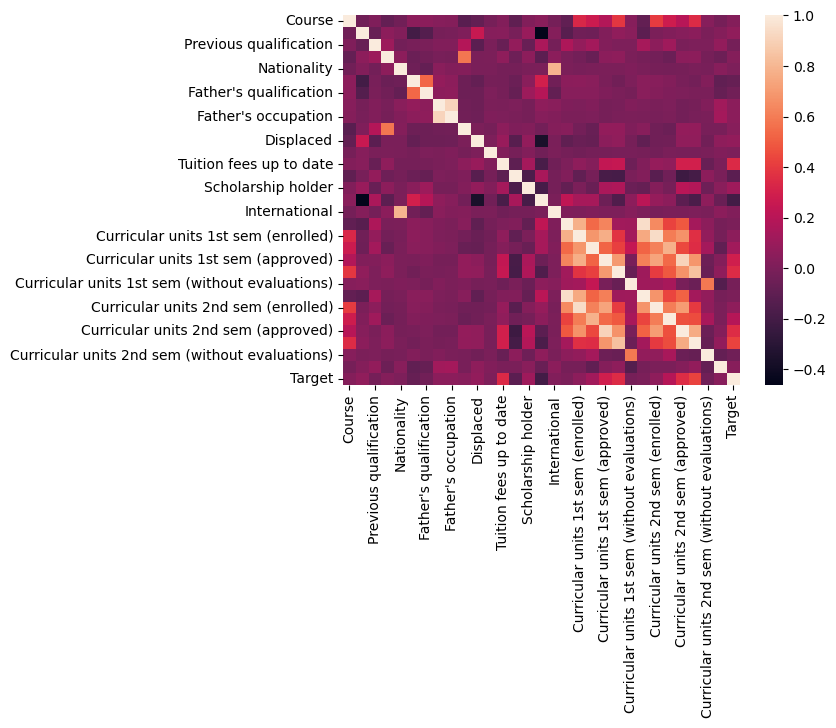

In [28]:
# Relationships Analysis
#Relationships between variables
corelation = df1.corr()   ## This calculates the correlation matrix for all numerical variables in DataFrame.
sns.heatmap(corelation)    ## This creates a heatmap using Seaborn to visualize the correlation matrix.

<AxesSubplot:>

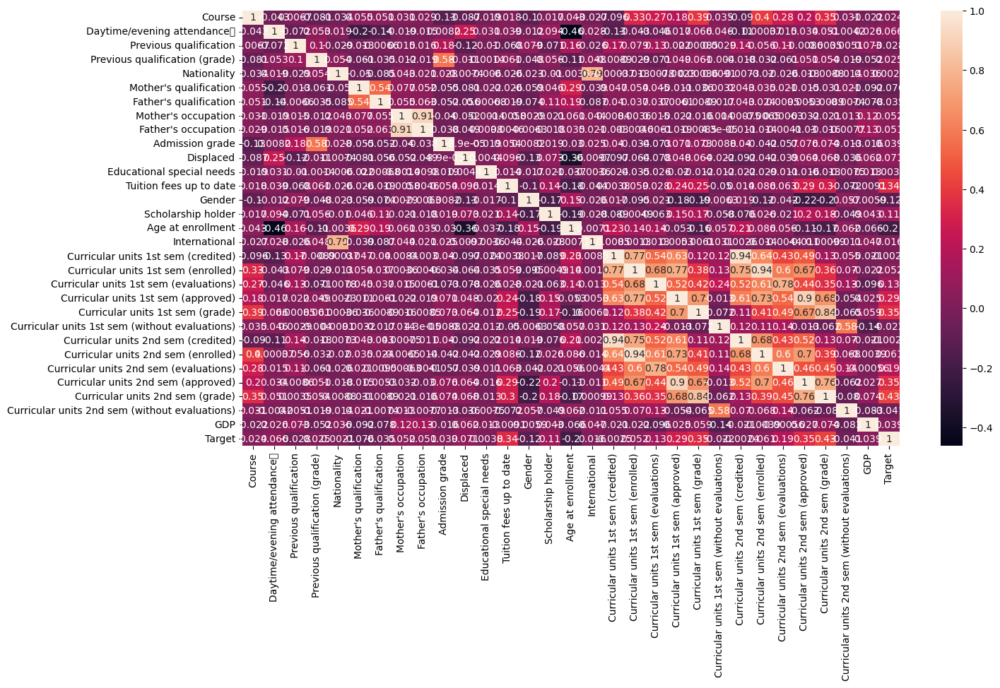

In [29]:

plt.figure(figsize=(15,8))
sns.heatmap(df1.select_dtypes(include=np.number).corr(),annot=True)

<B>Visually explore relationships, patterns, and potential correlations between variables in the dataset, making it a useful tool for exploratory data analysis.
Creating a pair plot using Seaborn's pairplot function, which is an excellent tool for visually exploring relationships, patterns, and potential correlations between numerical variables in dataset.

In [30]:
# Create a pair plot
sns.pairplot(df1)

# Show the plot
plt.show()

<b>Create a relational scatter plot with the variables "Mother's qualification," "Father's qualification," and differentiating points by the "Gender" variable.

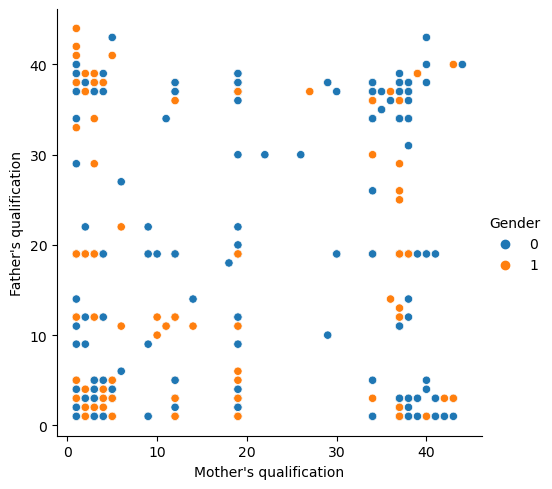

In [31]:
# Create a relational scatter plot
sns.relplot(x= "Mother's qualification", y= "Father's qualification", hue='Gender', data=df1) 
# Show the plot
plt.show()

<b>Create a distribution plot (histogram) for the "Admission grade" variable in dataset. 
<br>This plot allows to visualize the distribution of values for that particular variable.

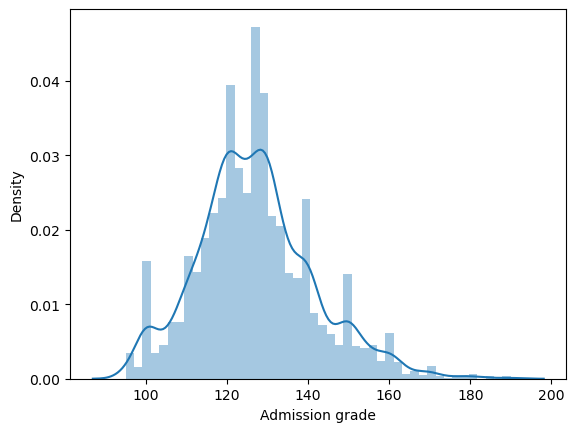

In [32]:
# Create a distribution plot for 'Admission grade'
sns.distplot(df1['Admission grade'])

# Show the plot
plt.show()


<b>Create a box plot using Seaborn's catplot for the variable 'Previous qualification (grade)'. 

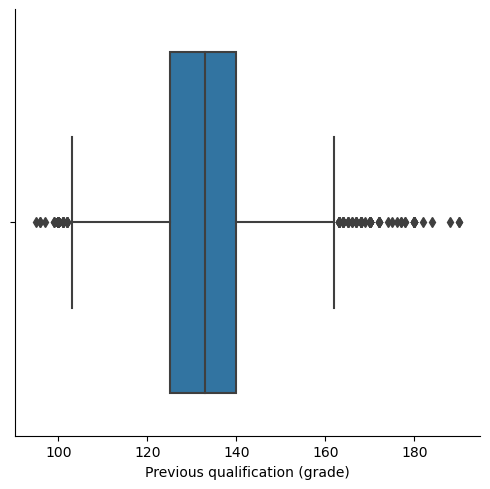

In [33]:

sns.catplot(x='Previous qualification (grade)', kind='box', data=df1)

<b>Histogram:
Visualize the distribution of a numerical variable by creating a histogram.

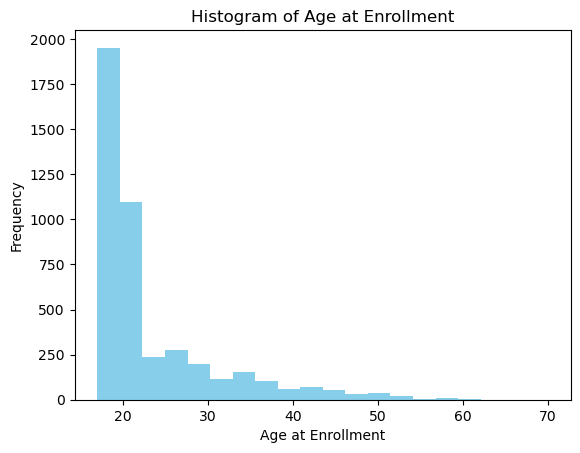

In [34]:
## Creating a histogram of the 'Age at enrollment' variable 
plt.hist(df1['Age at enrollment'], bins=20, color='skyblue')
plt.xlabel('Age at Enrollment')
plt.ylabel('Frequency')
plt.title('Histogram of Age at Enrollment')
plt.show()


<B> Bar chart is useful for understanding the balance or imbalance in target variable. 

<AxesSubplot:xlabel='Target', ylabel='count'>

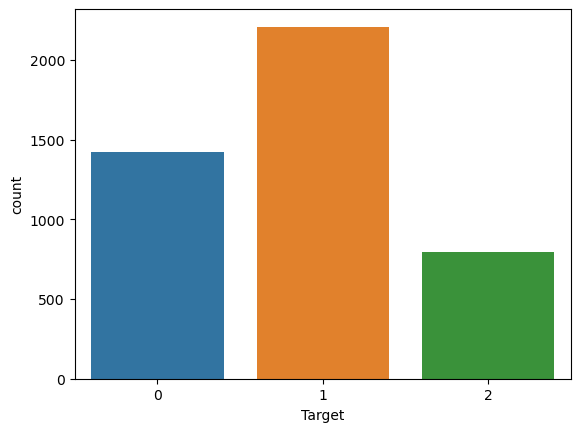

In [35]:
## creating a bar chart using Seaborn's countplot to visualize the distribution of the 'Target' variable
import seaborn as sns
sns.countplot(x='Target', data=df1)

<b> Create a histogram of the 'Target' variable directly from the Pandas DataFrame.<br> This is a quick way to visualize the distribution of a numerical or categorical variable.

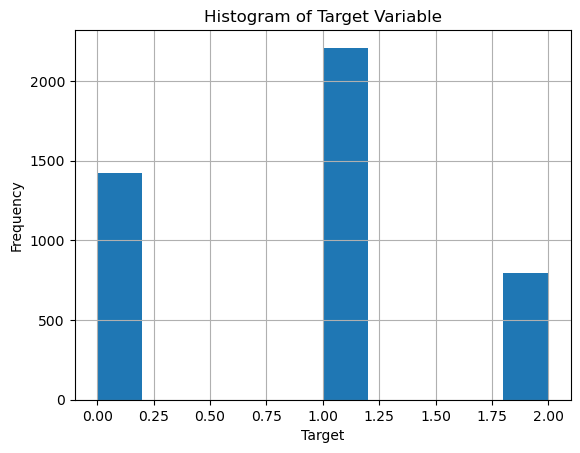

In [36]:
# create a histogram of the 'Target' variable and label the axes accordingly.
df1['Target'].hist()
plt.xlabel('Target')
plt.ylabel('Frequency')
plt.title('Histogram of Target Variable')
plt.show()

<b> Generate a box plot for the specified columns, providing a visual representation of the distribution of values and highlighting any potential outliers.

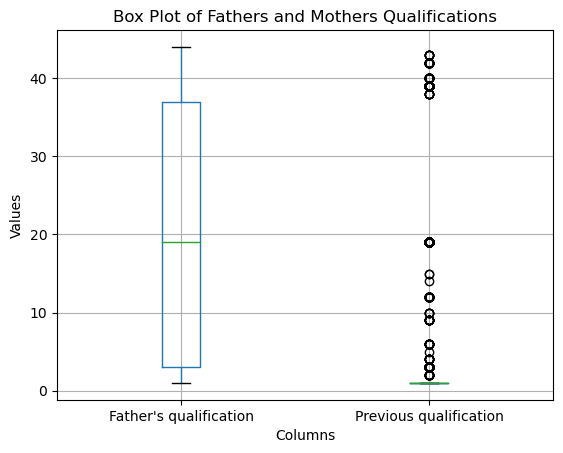

In [37]:
## creating a boxplot for the columns "Father's qualification" and 'Previous qualification' from dataset
import matplotlib.pyplot as plt

# Assuming 'Fathers_qualification' and 'Mothers_qualification' are numerical columns
df1[["Father's qualification", 'Previous qualification', ]].boxplot()

# Add labels and title
plt.xlabel('Columns')
plt.ylabel('Values')
plt.title('Box Plot of Fathers and Mothers Qualifications')

# Show the plot
plt.show()

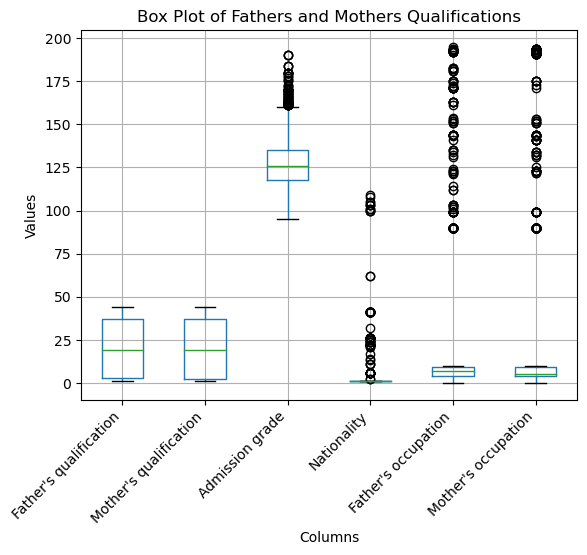

In [38]:
## Generate a combined box plot for the specified numerical columns, providing a visual representation of their distributions.

# Select multiple numerical columns for the box plot
numerical_columns = ["Father's qualification", "Mother's qualification", 'Admission grade', 'Nationality', "Father's occupation" , "Mother's occupation"]

# Create a box plot for the selected columns
df1[numerical_columns].boxplot()

# Add labels and title
plt.xlabel('Columns')
plt.ylabel('Values')
plt.title('Box Plot of Fathers and Mothers Qualifications')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
# Show the plot
plt.show()


<B> 

Violin plots combine box plots and kernel density plots to display the distribution of numerical variables, along with summary statistics.

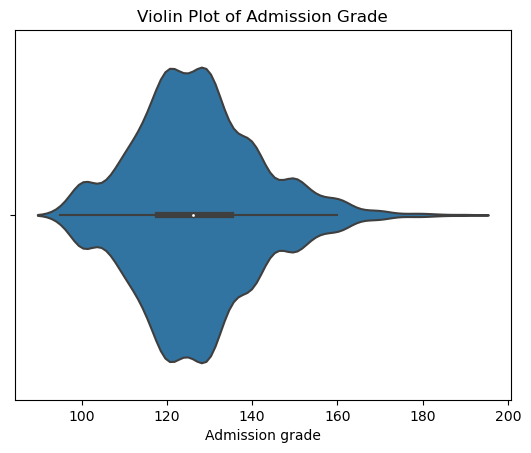

In [39]:
# Generate a violin plot for the 'Admission grade' variable, displaying the distribution of values, including information about the probability density at different values.   
# Create a violin plot for the 'Admission grade' variable
sns.violinplot(x='Admission grade', data=df1)

# Add labels and title
plt.xlabel('Admission grade')
plt.title('Violin Plot of Admission Grade')

# Show the plot
plt.show()



<b>Summary Tables:<br>
<b>Create summary tables to display the count or percentage of categories in categorical variables.

In [40]:
summary_table = df1['Target'].value_counts()
print(summary_table)

1    2209
0    1421
2     794
Name: Target, dtype: int64


 ## Visualizing the dataset
<b>1) visulalizing the total number of students dropout, graduate and enrolled

<AxesSubplot:xlabel='Target', ylabel='count'>

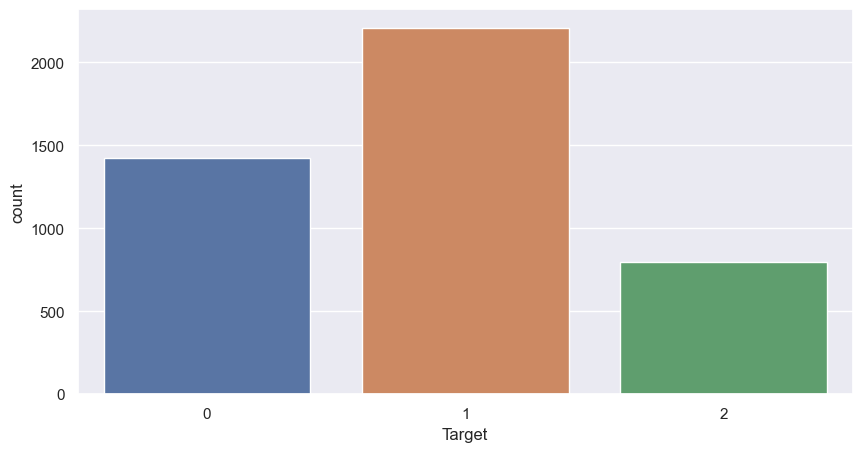

In [41]:
sns.set(rc={'figure.figsize':(10, 5)})

sns.countplot(x=df1['Target'])

<b>2) Visualizing the total number of students dropout, graduate and enrolled w.r.t Course

<AxesSubplot:xlabel='Course', ylabel='count'>

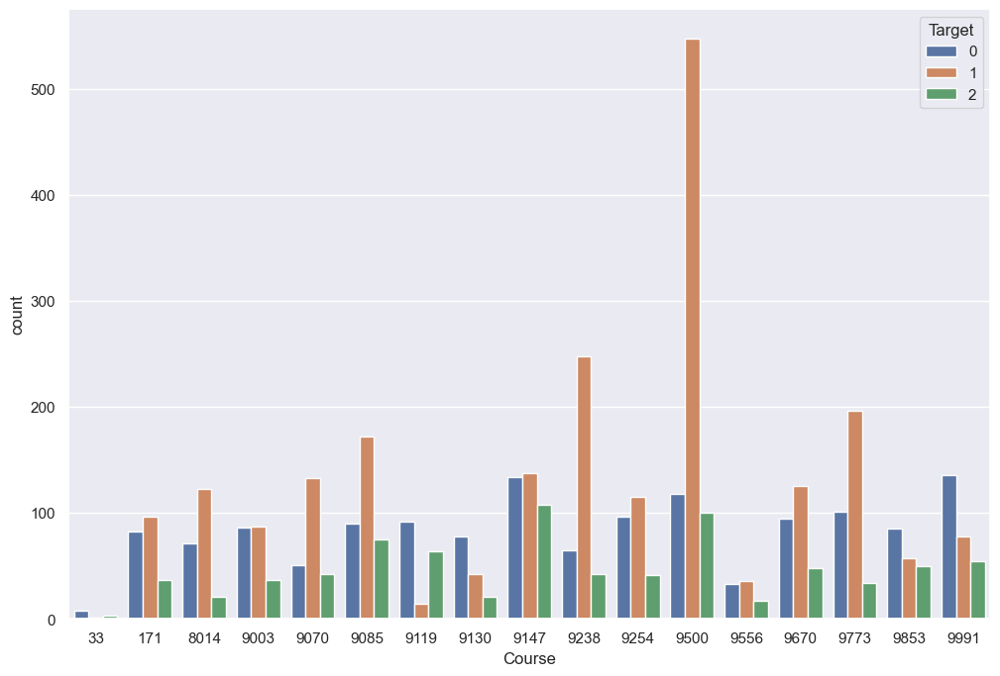

In [42]:
sns.set(rc={'figure.figsize':(12, 8)})

sns.countplot(x=df1['Course'], hue=df1['Target'])

<b>3) Visualizing the total number of students dropout, graduate and enrolled w.r.t attendance

<AxesSubplot:xlabel='Daytime/evening attendance\t', ylabel='count'>

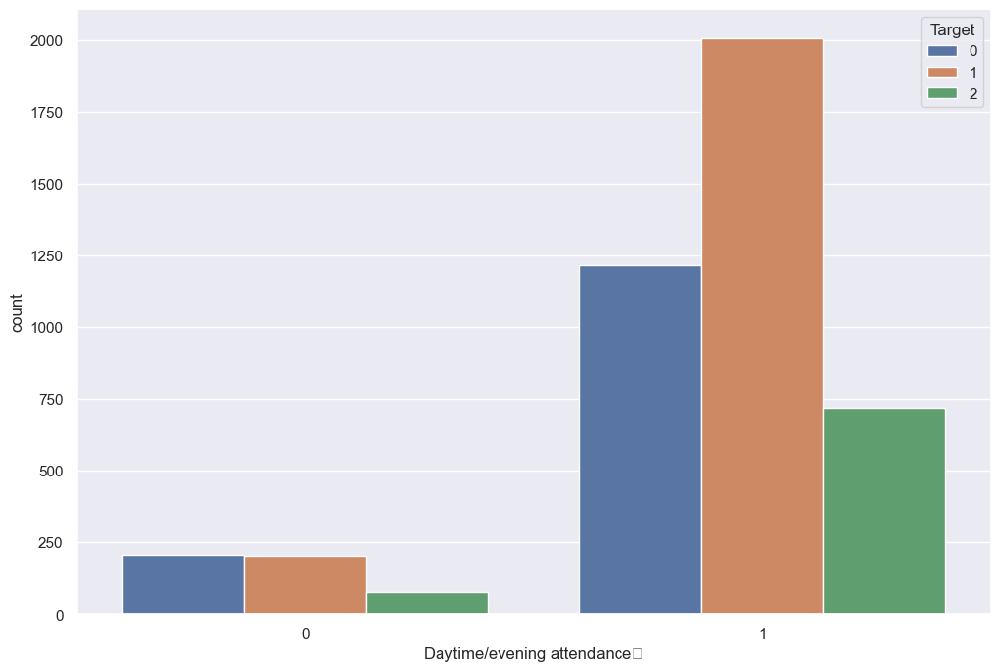

In [43]:
sns.countplot(x=df1['Daytime/evening attendance\t'], hue=df1['Target'])

<b>4) Visualizing the total number of students dropout, graduate and enrolled w.r.t Gender

<AxesSubplot:xlabel='Gender', ylabel='count'>

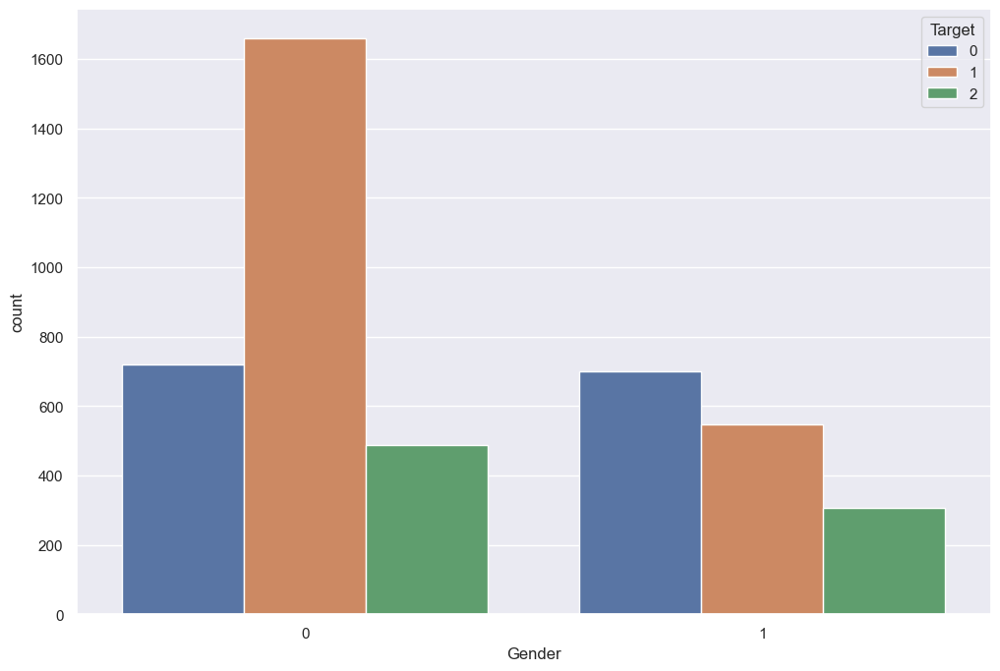

In [44]:
sns.countplot(x=df1['Gender'], hue=df1['Target'])

<b>5) Visualizing the total number of students dropout, graduate and enrolled w.r.t Scholarship Holder

<AxesSubplot:xlabel='Scholarship holder', ylabel='count'>

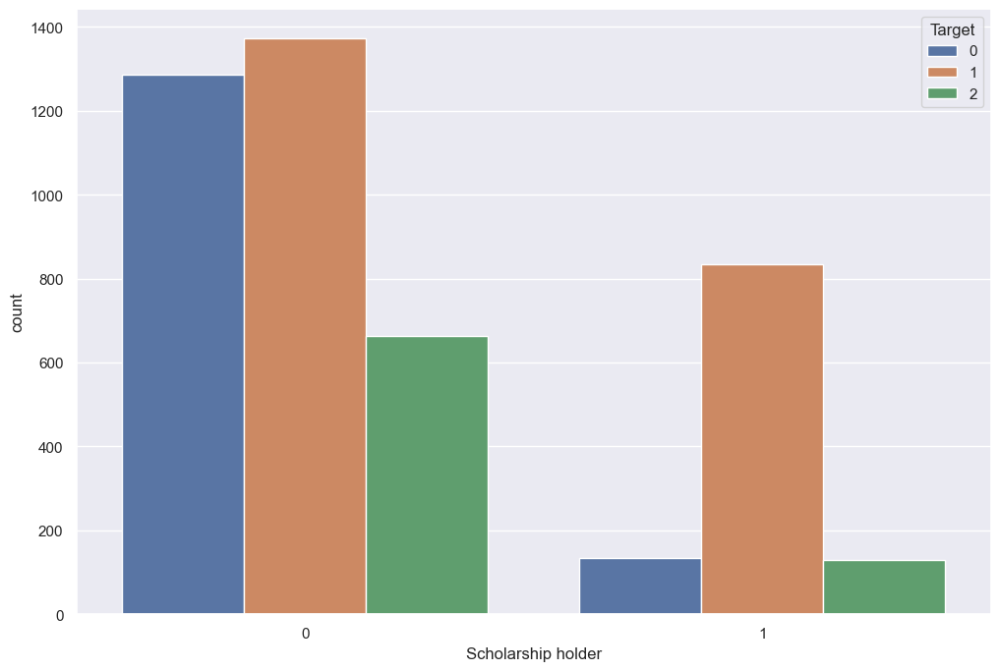

In [45]:
sns.countplot(x=df1['Scholarship holder'], hue=df1['Target'])

<b>A histogram is a graphical representation of the distribution of a dataset. It is a way to visualize the underlying frequency distribution of a set of continuous or discrete data. The data is divided into intervals or bins, and the height of each bar in the histogram corresponds to the frequency (or count) of data points falling within that bin.

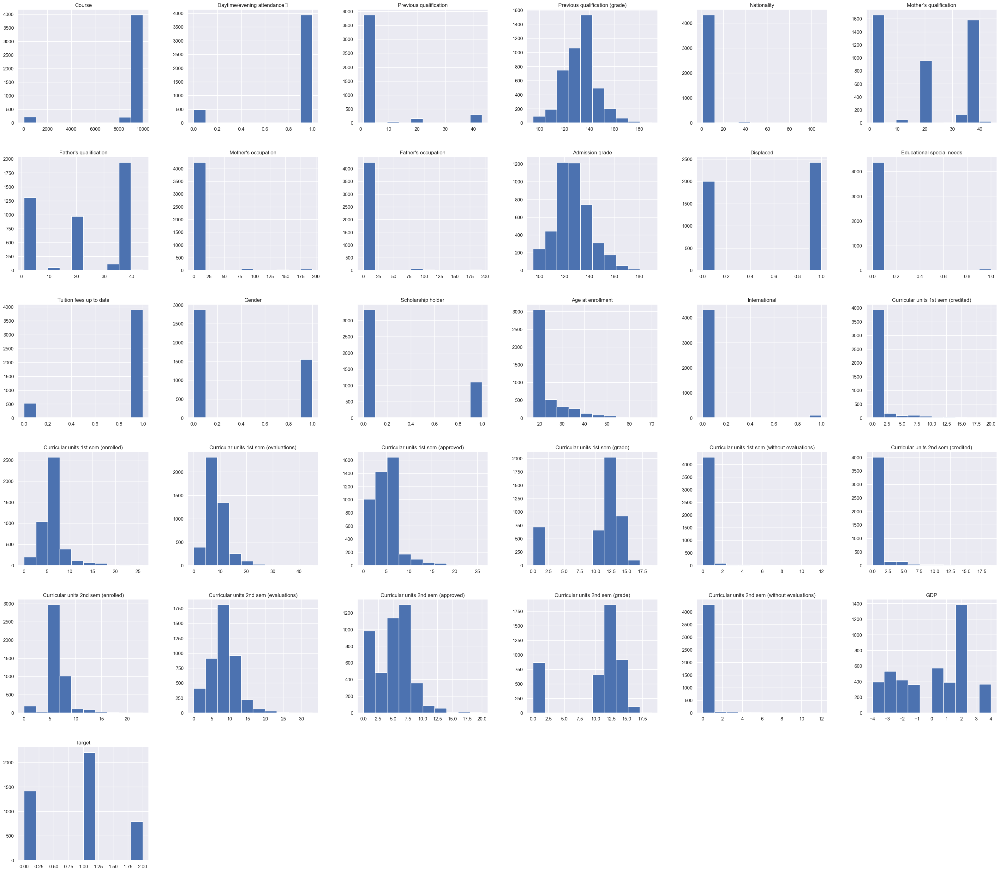

In [46]:
## histogram - visual representation
# create histograms for all DataFrame
sns.set_theme(style = 'darkgrid')
df1.hist(bins=10, figsize=(40, 35), grid=True, legend=None);

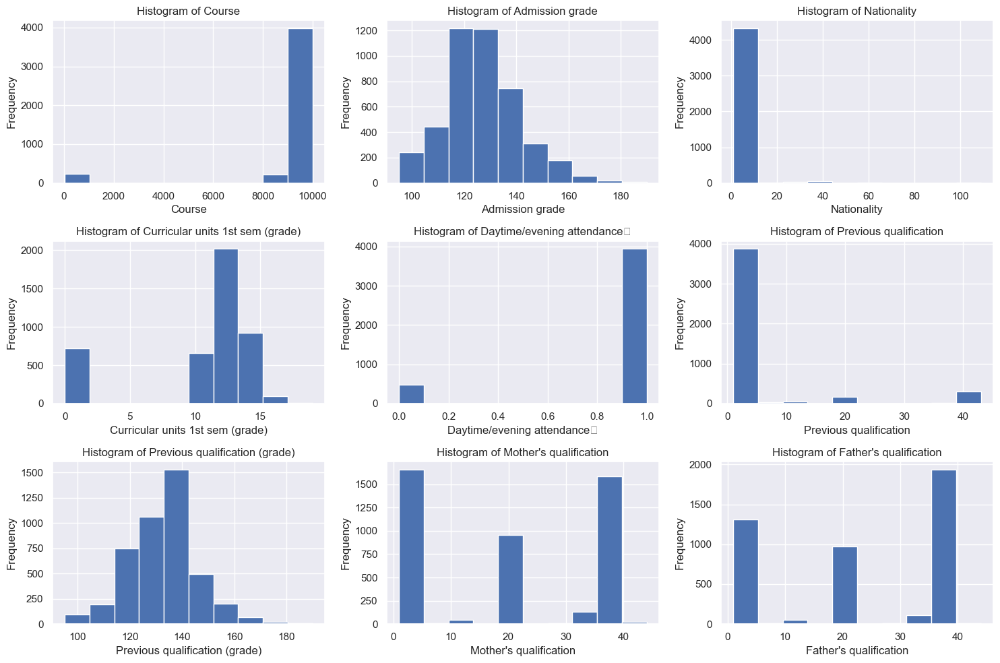

In [47]:
import matplotlib.pyplot as plt

# Set the theme for the Seaborn plots
sns.set_theme(style='darkgrid')

# Specify the attributes you want to include in the histograms
selected_attributes = [ 'Course','Admission grade', 'Nationality', "Curricular units 1st sem (grade)" ,'Daytime/evening attendance\t', 'Previous qualification',"Previous qualification (grade)",  "Mother's qualification","Father's qualification" ]

# Set a larger figsize for better visibility
plt.figure(figsize=(15, 10))

# Loop through each selected attribute and create a subplot
for i, attribute in enumerate(selected_attributes, start=1):
    plt.subplot(3, 3, i)  # Adjust the number of rows and columns based on the number of attributes
    df1[attribute].hist(bins=10, grid=True)
    plt.title(f'Histogram of {attribute}')
    plt.xlabel(attribute)
    plt.ylabel('Frequency')

# Adjust layout to prevent overlapping
plt.tight_layout()
plt.show()
     

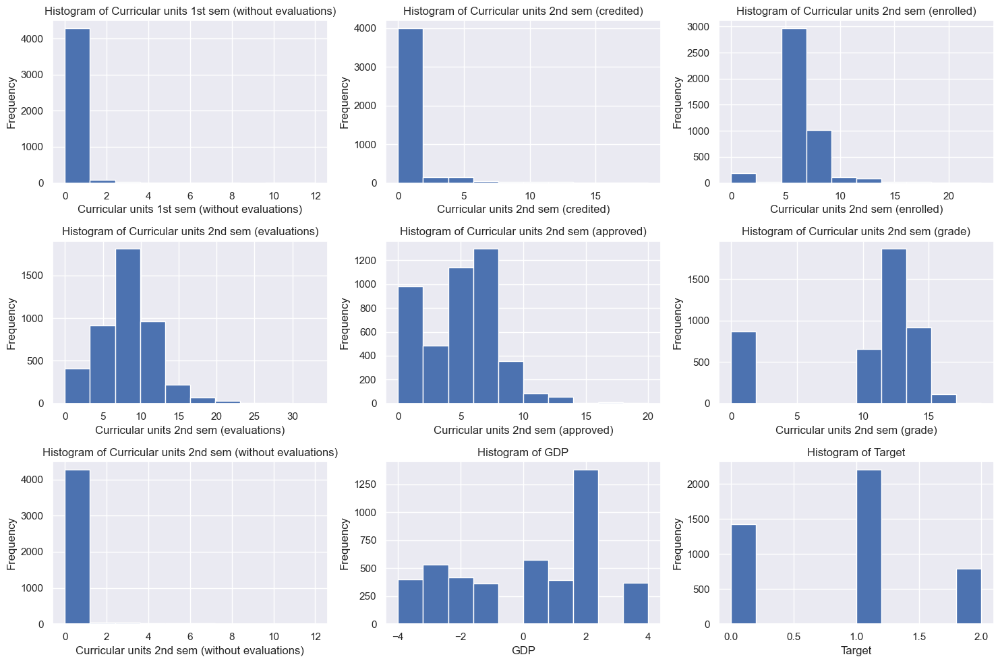

In [48]:
import matplotlib.pyplot as plt

# Set the theme for the Seaborn plots
sns.set_theme(style='darkgrid')

# Specify the attributes you want to include in the histograms
selected_attributes = [ "Curricular units 1st sem (without evaluations)" ,"Curricular units 2nd sem (credited)", "Curricular units 2nd sem (enrolled)", "Curricular units 2nd sem (evaluations)", "Curricular units 2nd sem (approved)", "Curricular units 2nd sem (grade)", "Curricular units 2nd sem (without evaluations)", 'GDP', 'Target' ]
# Set a larger figsize for better visibility
plt.figure(figsize=(15, 10))

# Loop through each selected attribute and create a subplot
for i, attribute in enumerate(selected_attributes, start=1):
    plt.subplot(3, 3, i)  # Adjust the number of rows and columns based on the number of attributes
    df1[attribute].hist(bins=10, grid=True)
    plt.title(f'Histogram of {attribute}')
    plt.xlabel(attribute)
    plt.ylabel('Frequency')

# Adjust layout to prevent overlapping
plt.tight_layout()
plt.show()

<b>Attempting to extract the number of unique values for each column in the DataFrame

## Visualizations are powerful tools for Exploratory Data Analysis (EDA), as they enable analysts to quickly grasp the data distribution, identify relationships between variables, and pinpoint potential outliers. 
<b> The following code snippets aim to generate counts for each column in the DataFrame.  


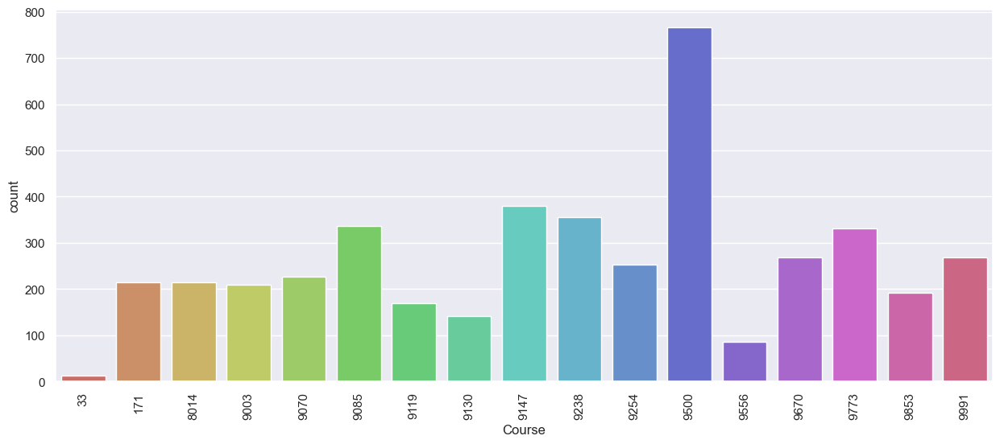

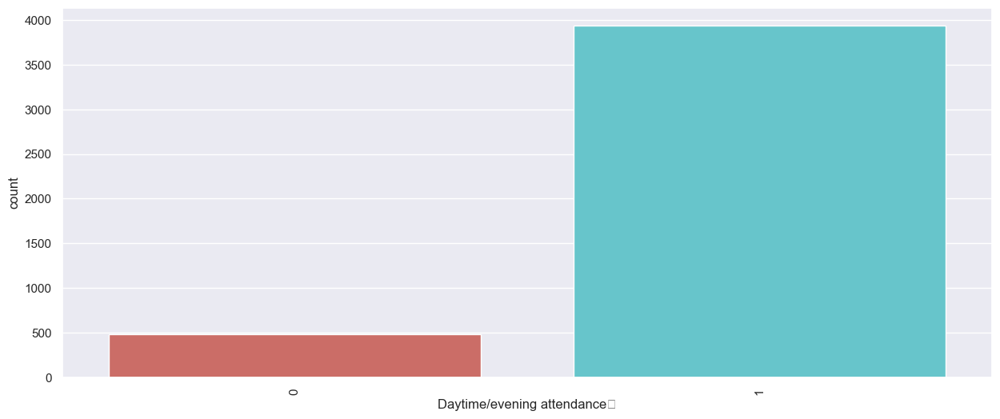

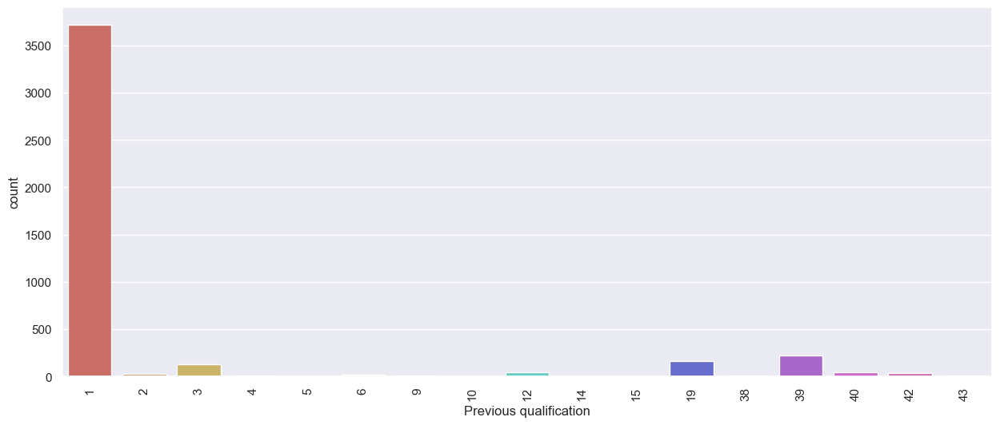

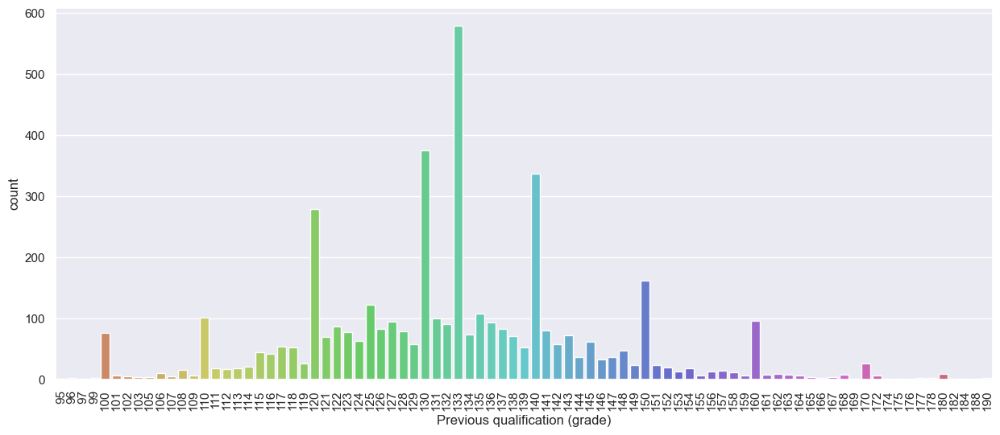

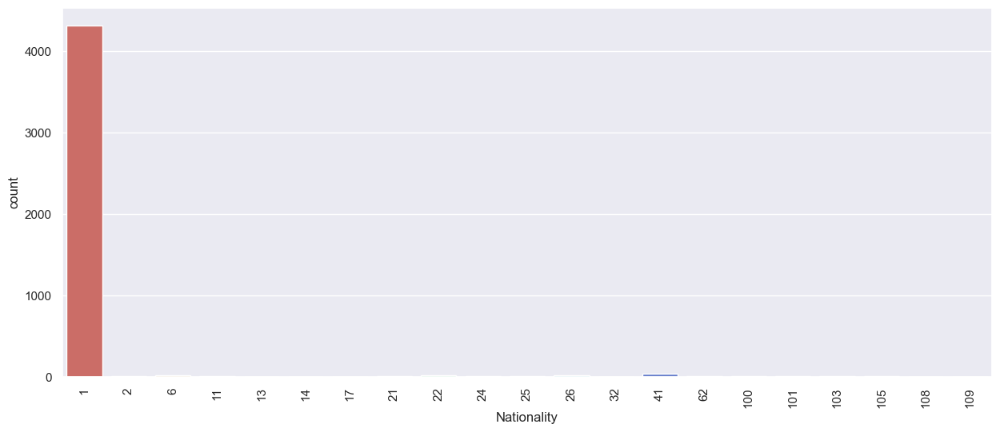

...

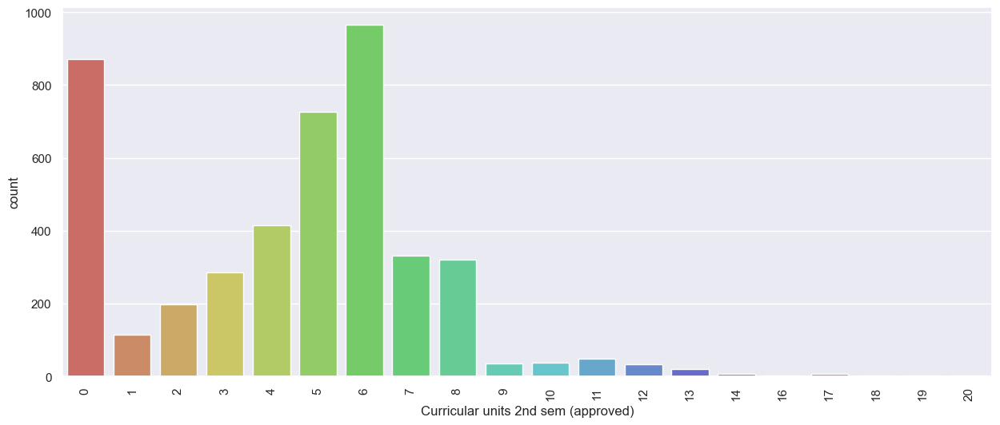

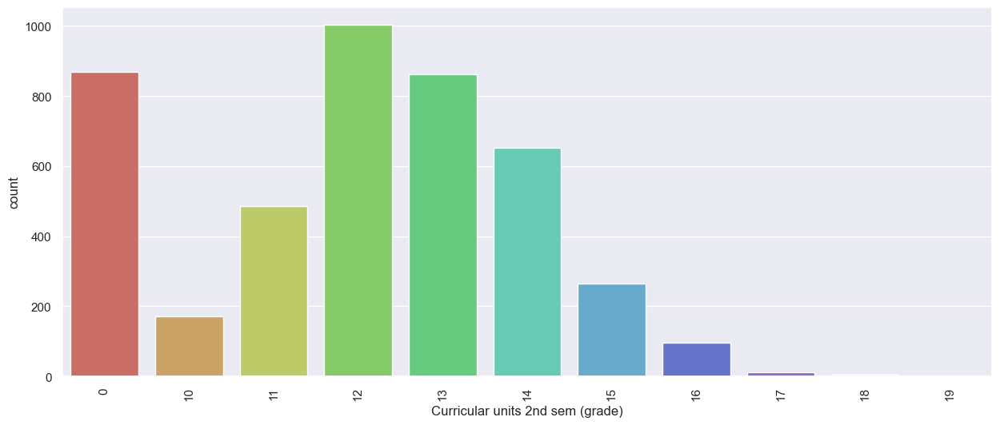

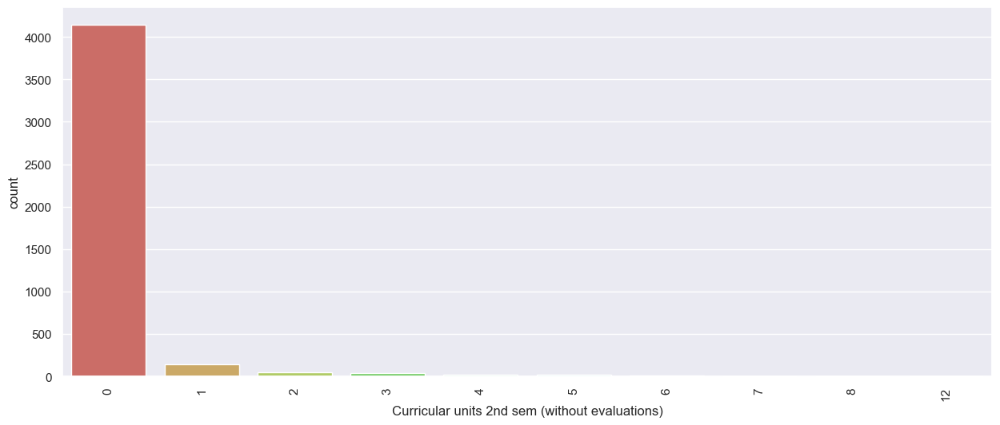

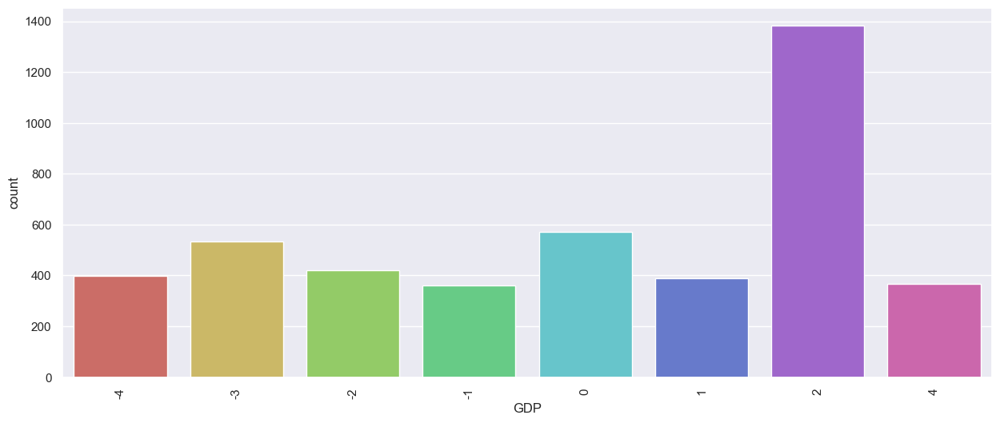

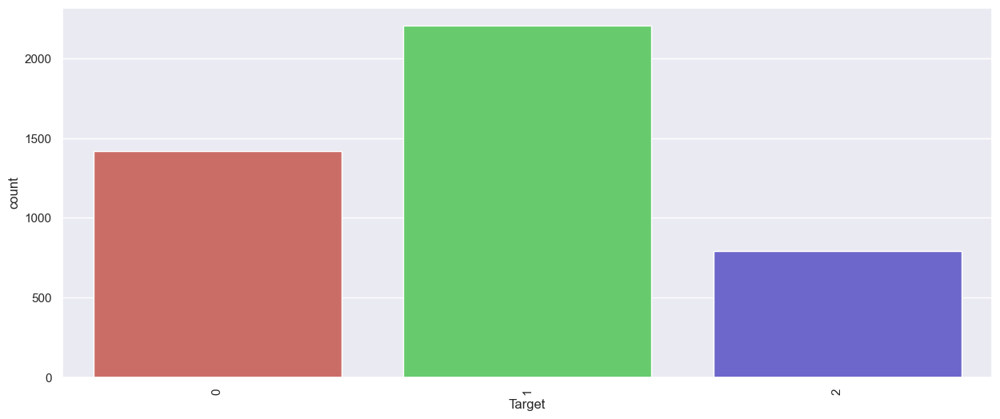

In [49]:
## create count plots for each column in DataFrame using Seaborn's countplot function
## Countplot is an effective way to visualize the distribution of categorical data in each column
for i in df1.columns:
 plt.figure(figsize=(15,6))
 sns.countplot(df1[i], data = df1, palette = 'hls')
 plt.xticks(rotation = 90)
 plt.show()

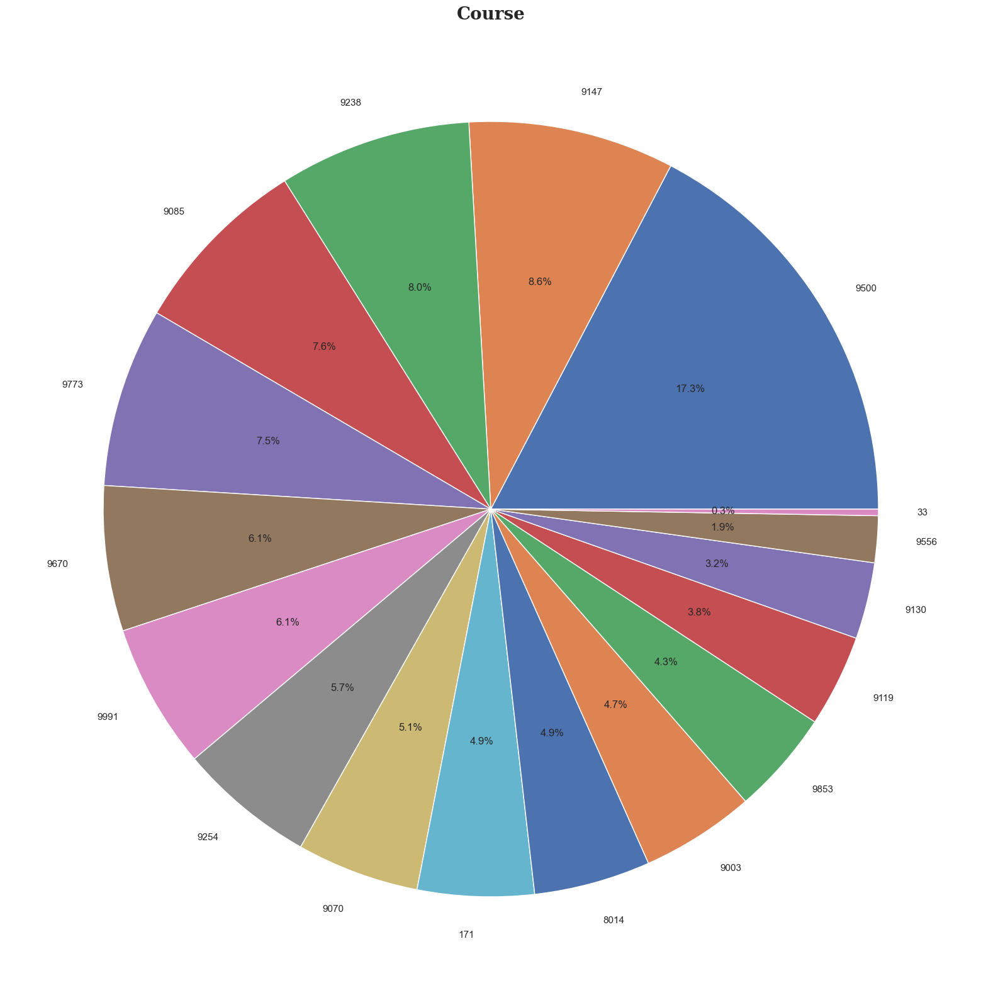

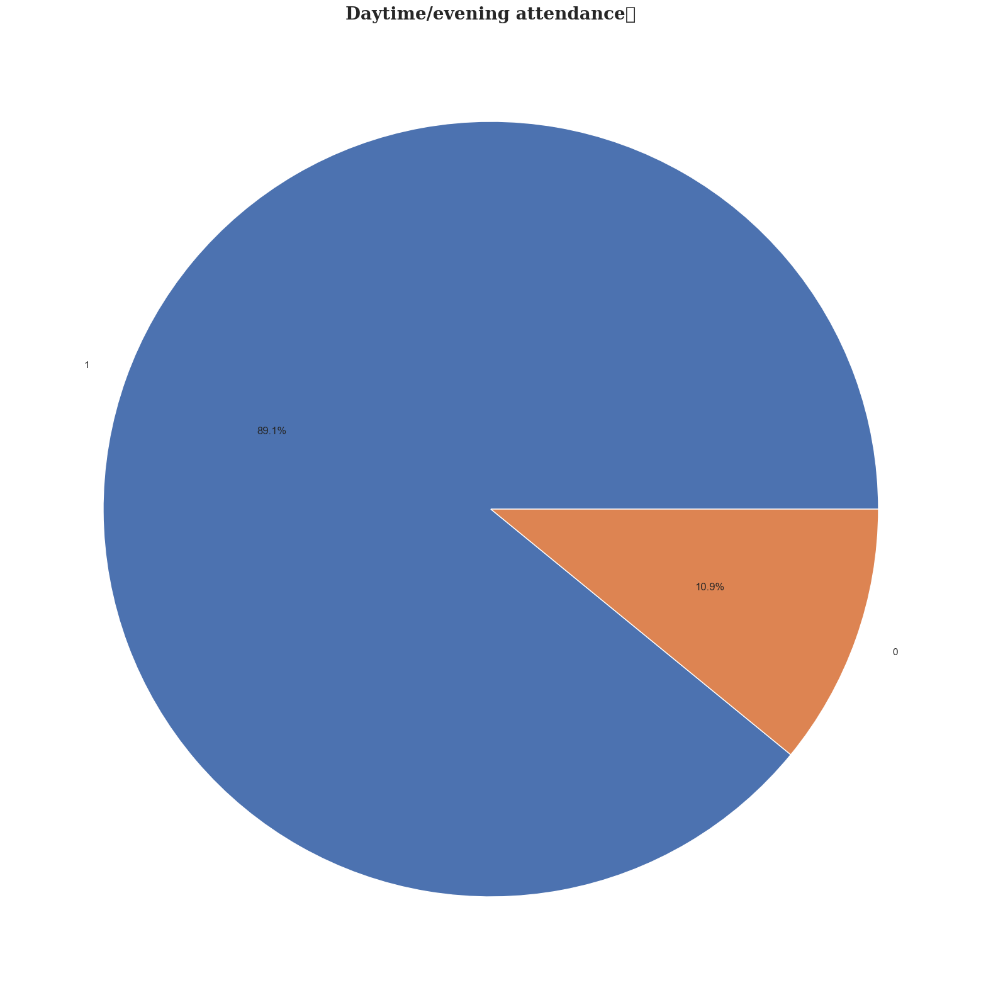

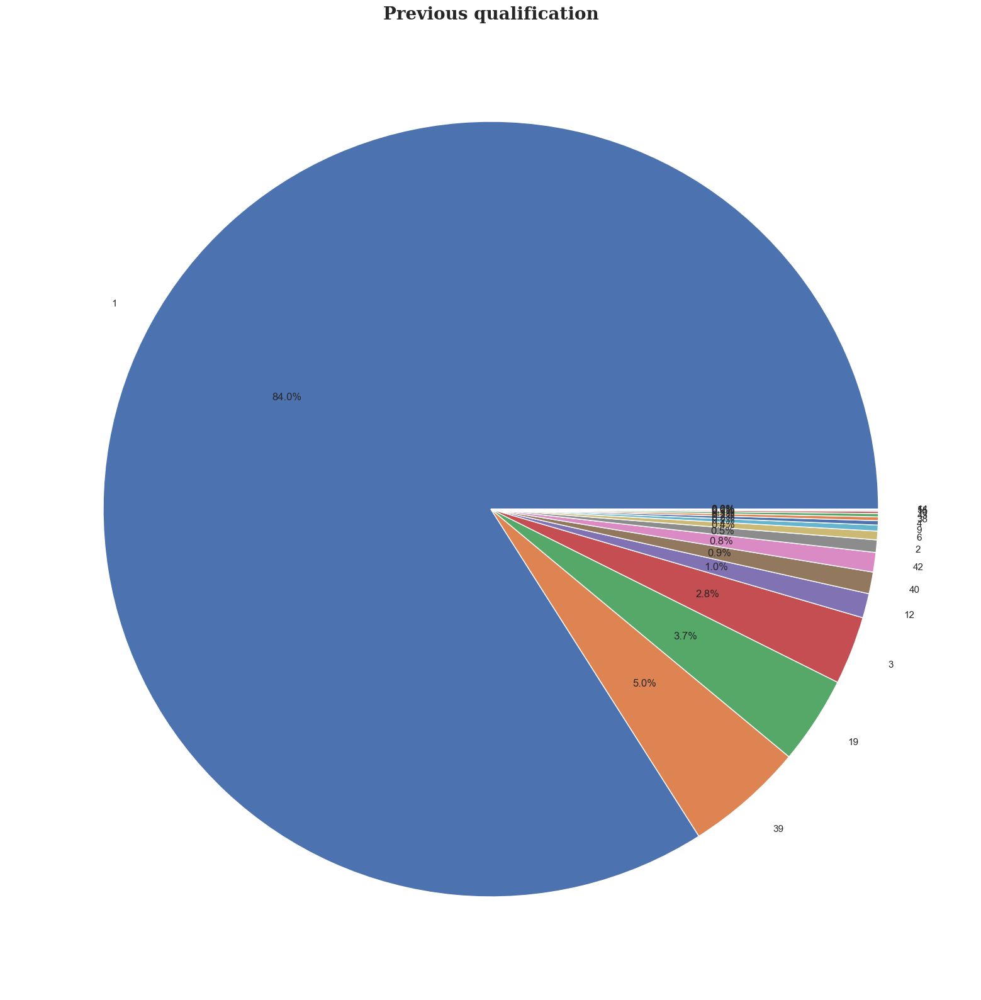

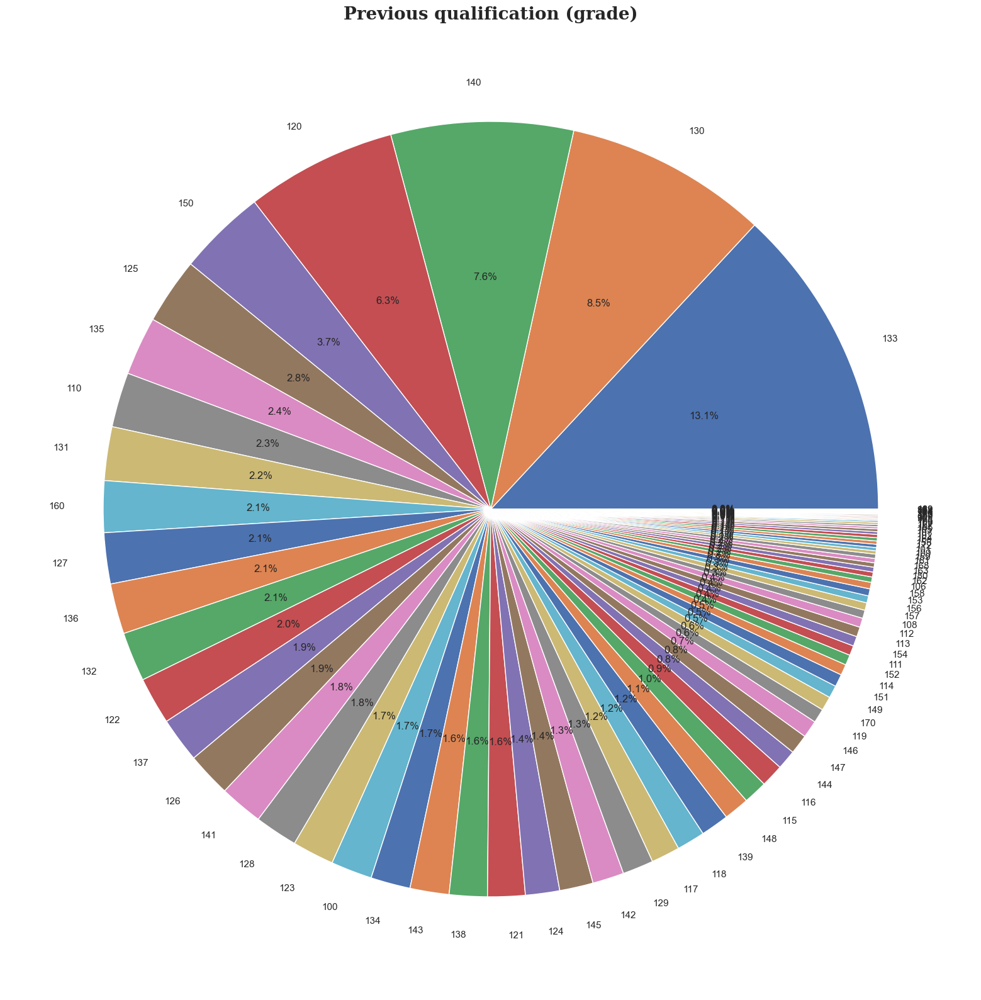

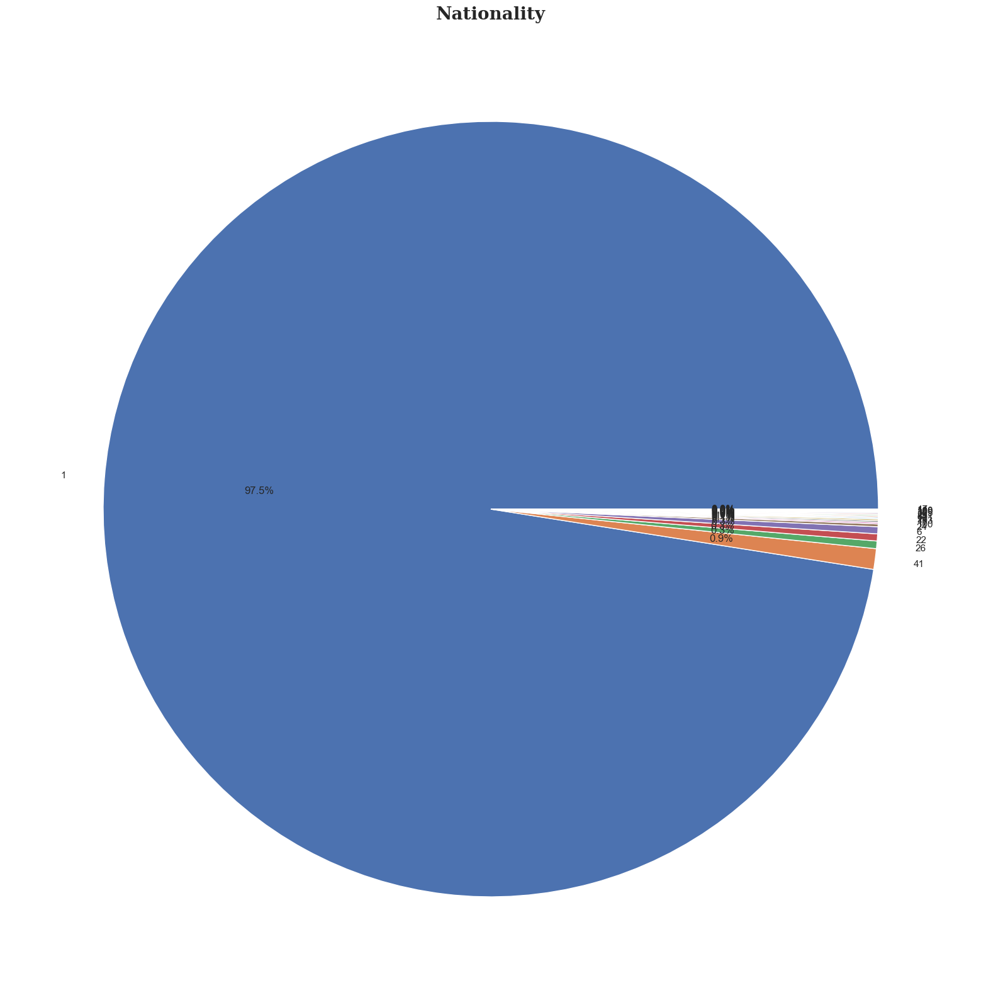

...

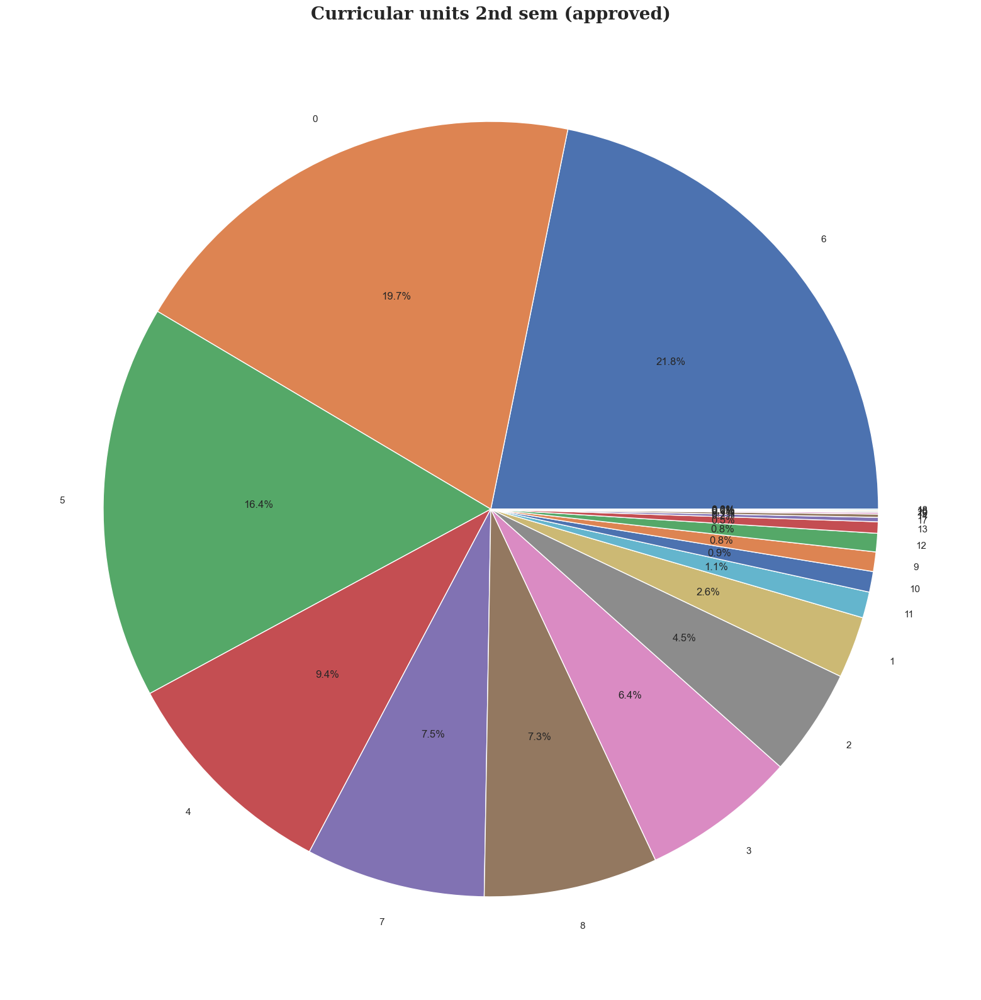

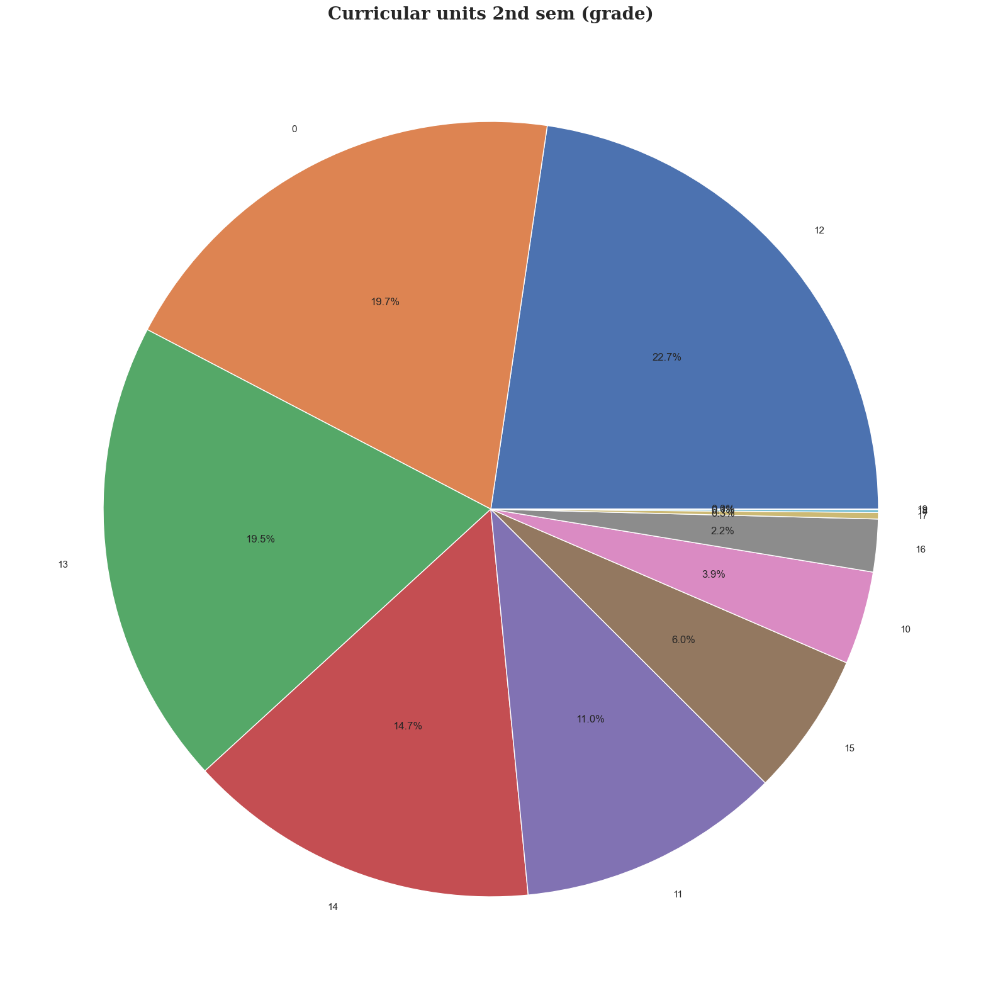

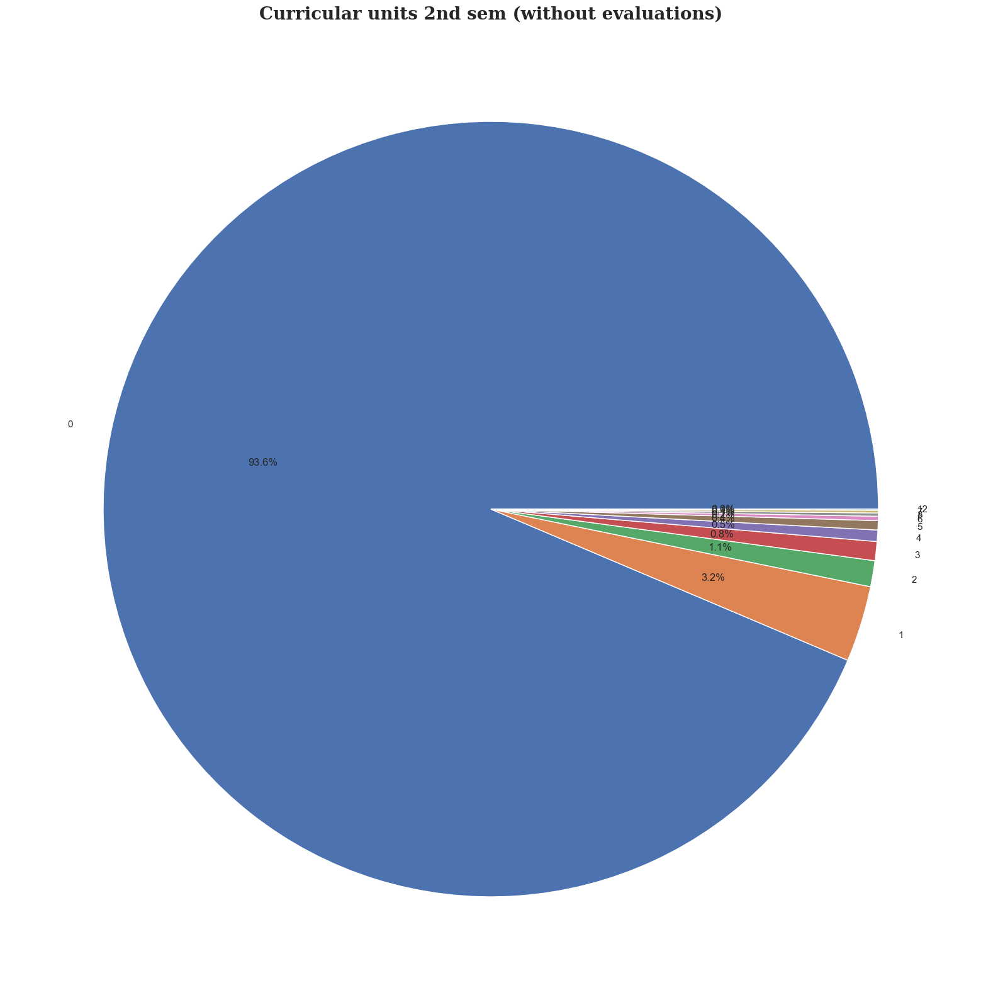

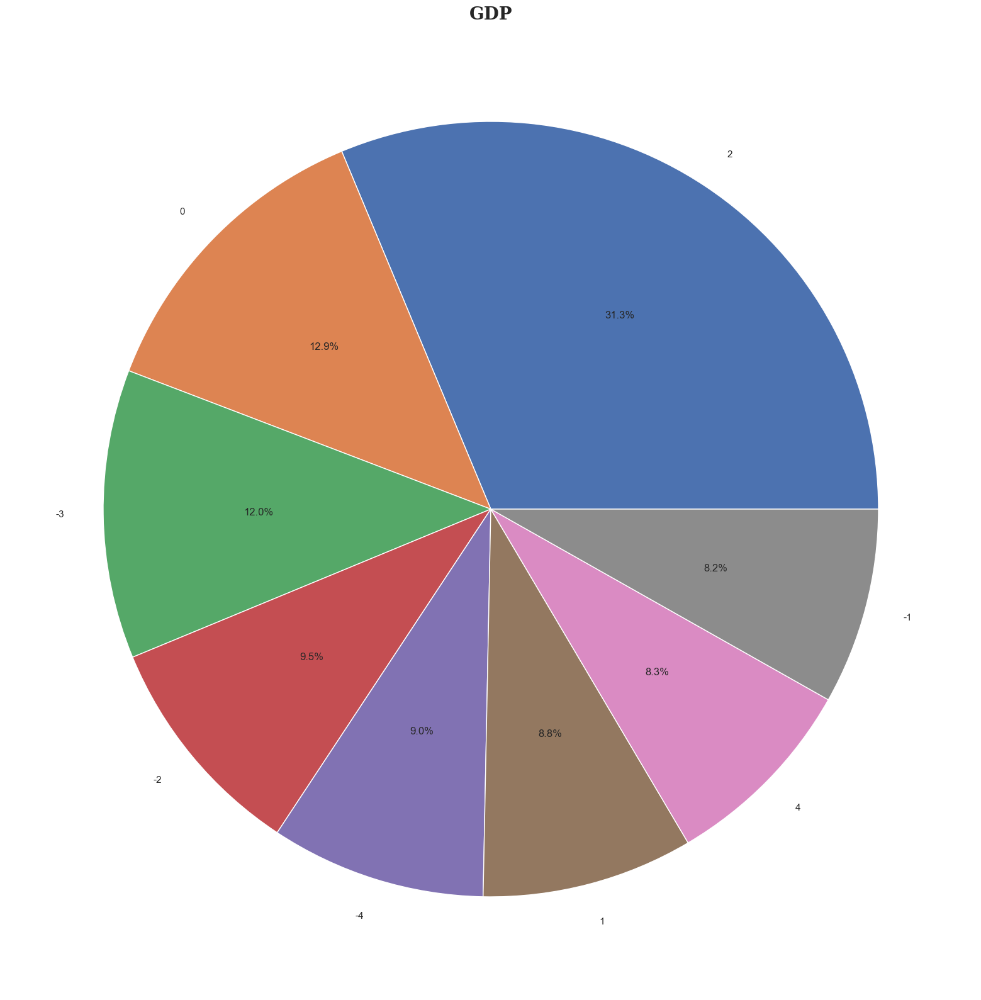

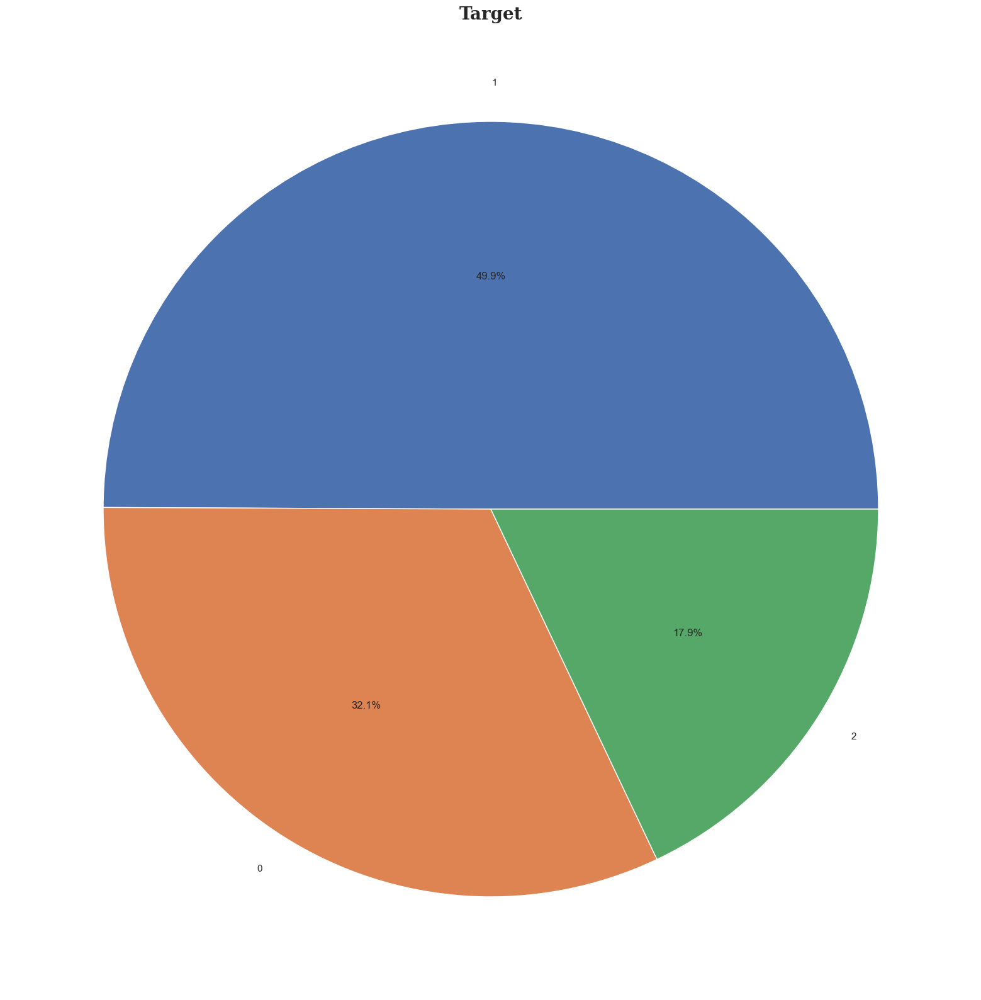

In [50]:
## Creating pie charts for each column in dataset. 
## Pie charts are a good way to represent the distribution of categorical data
for i in df1.columns:
    plt.figure(figsize=(30,20))
    plt.pie(df1[i].value_counts(), labels=df1[i].value_counts().index, autopct='%1.1f%%')
    hfont = {'fontname':'serif', 'weight': 'bold'}
    plt.title(i, size=20, **hfont)
    plt.show()

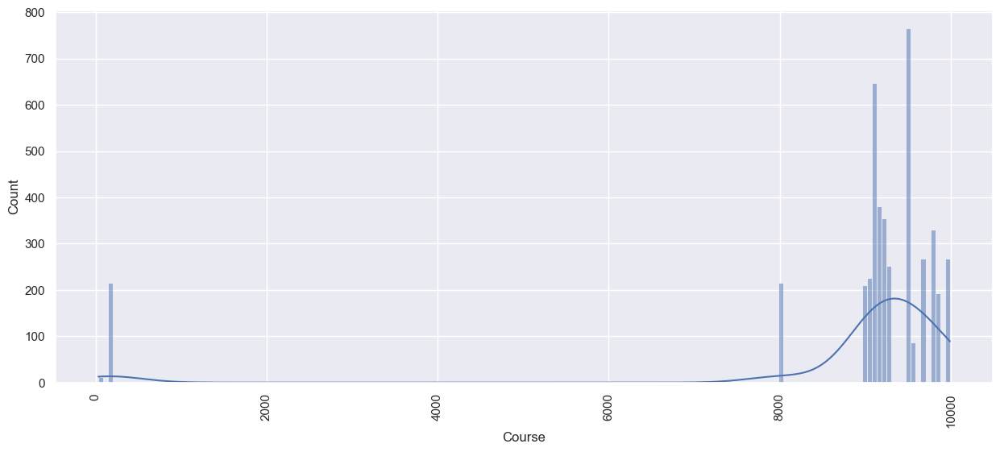

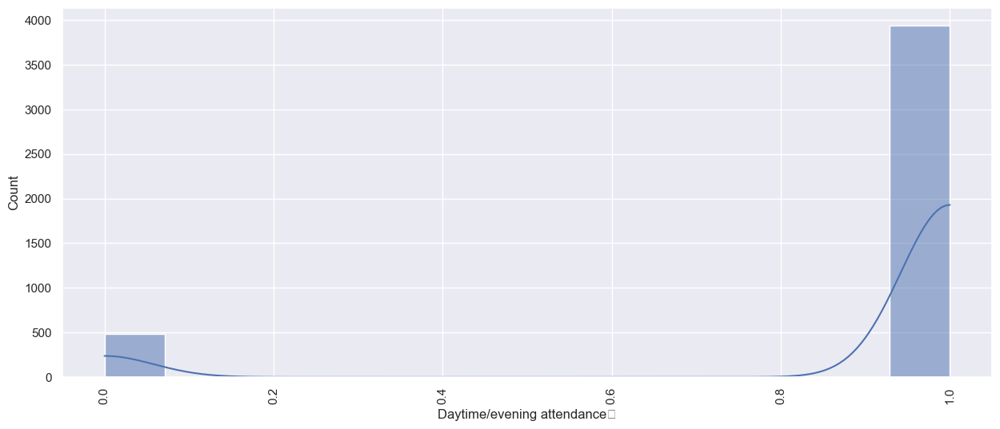

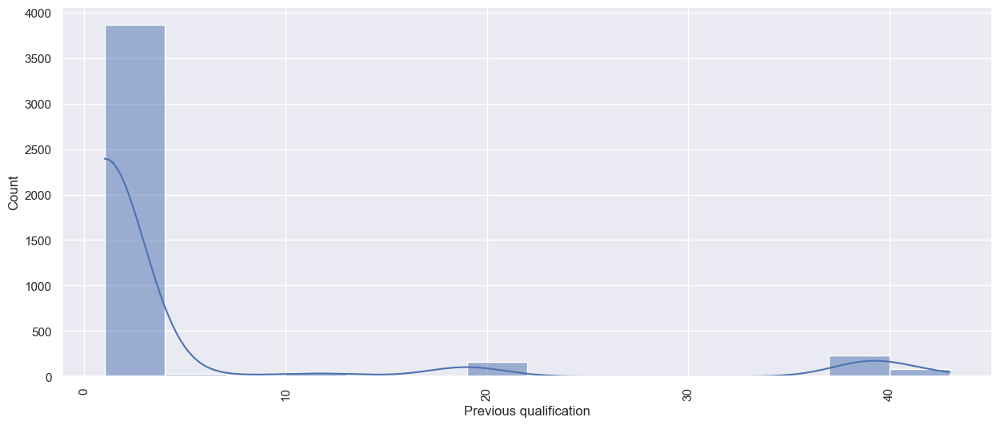

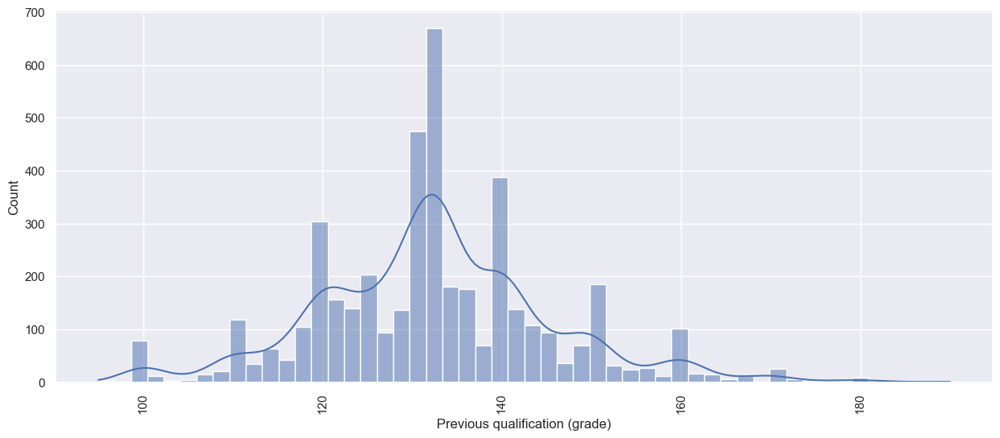

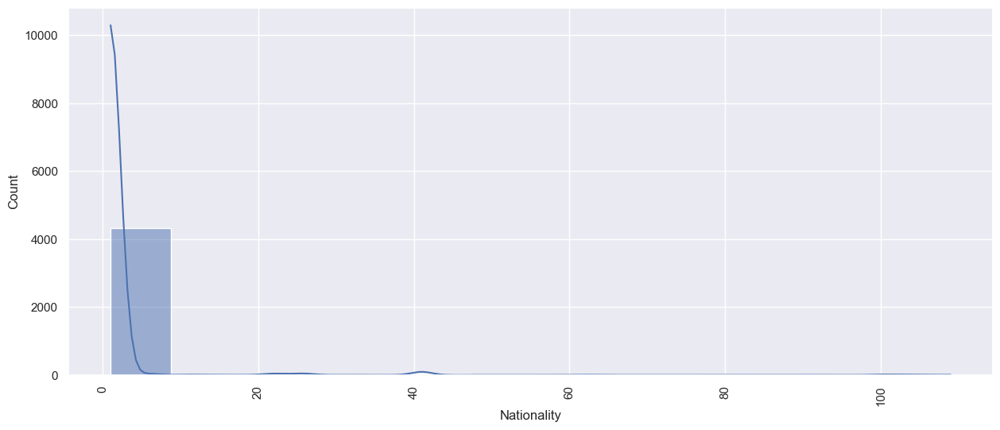

...

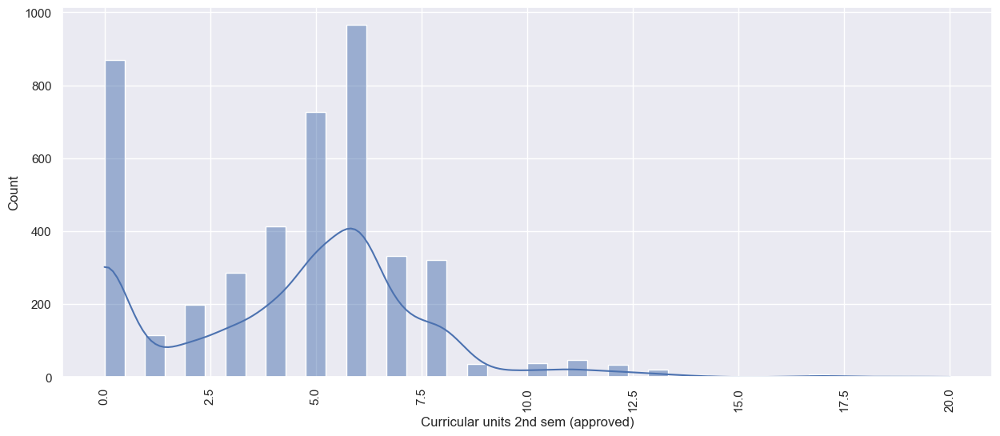

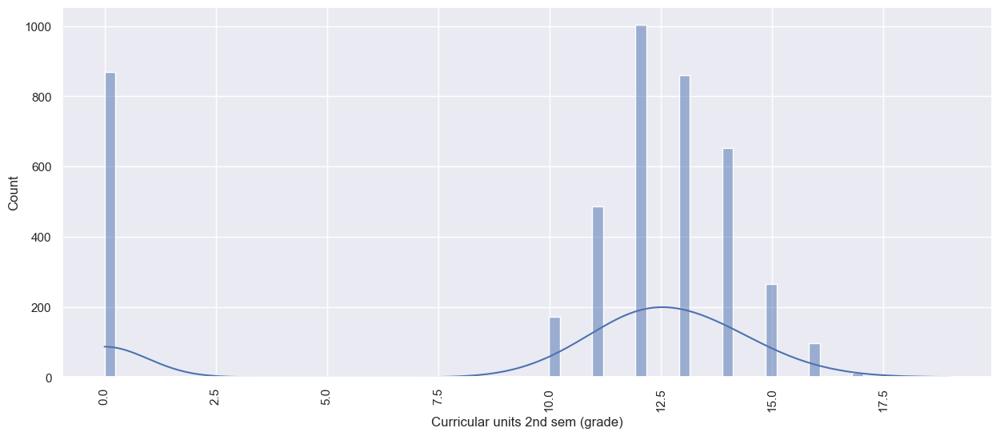

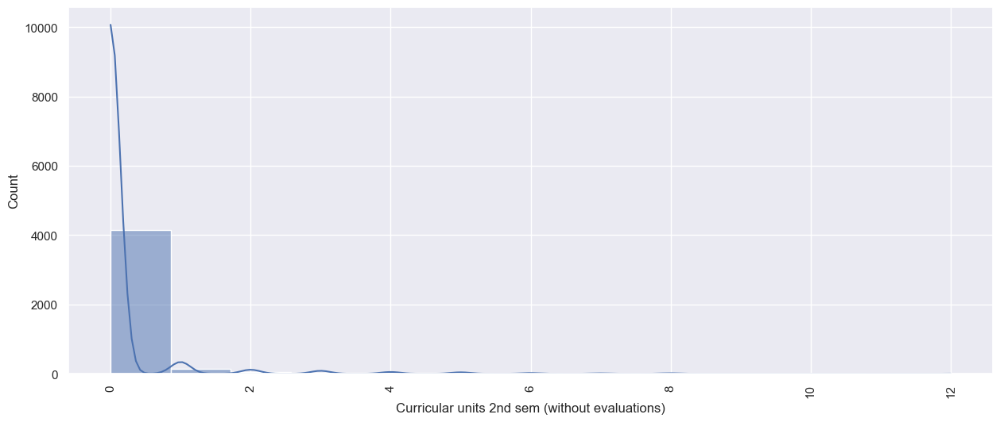

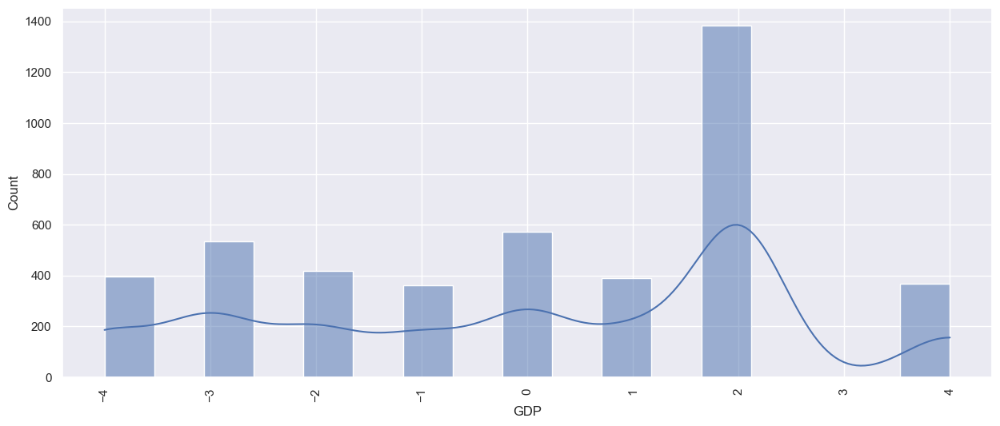

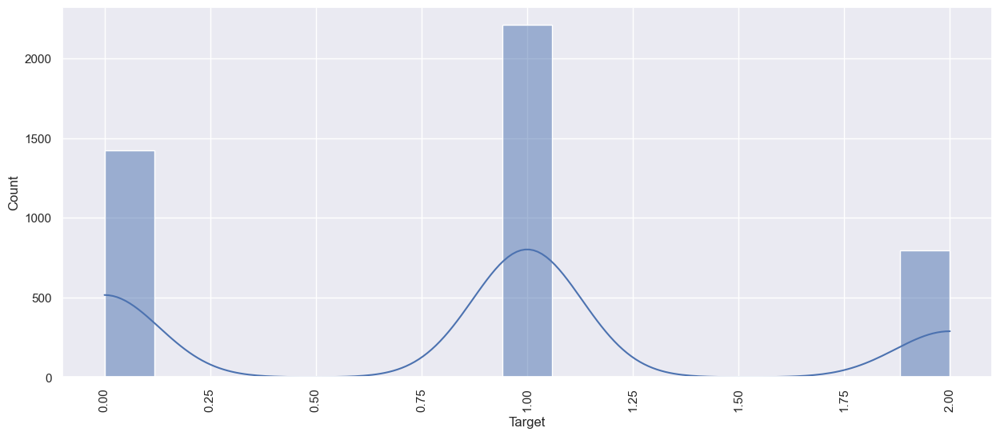

In [51]:
 ## Creating histograms for each column in dataset using sns.histplot.
## Histograms are a great way to visualize the distribution of numerical data.
for i in df1.columns:
    plt.figure(figsize=(15,6))
    sns.histplot(df1[i], kde = True, palette = 'hls')
    plt.xticks(rotation = 90)
    plt.show()

Index(['Course', 'Daytime/evening attendance\t', 'Previous qualification',
       'Previous qualification (grade)', 'Nationality',
       'Mother's qualification', 'Father's qualification',
       'Mother's occupation', 'Father's occupation', 'Admission grade',
       'Displaced', 'Educational special needs', 'Tuition fees up to date',
       'Gender', 'Scholarship holder', 'Age at enrollment', 'International',
       'Curricular units 1st sem (credited)',
       'Curricular units 1st sem (enrolled)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (approved)',
       'Curricular units 1st sem (grade)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (enrolled)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (approved)',
       'Curricular units 2nd sem (grade)',
       'Curricular units 2nd sem (without evaluations)', 'GDP'],
   

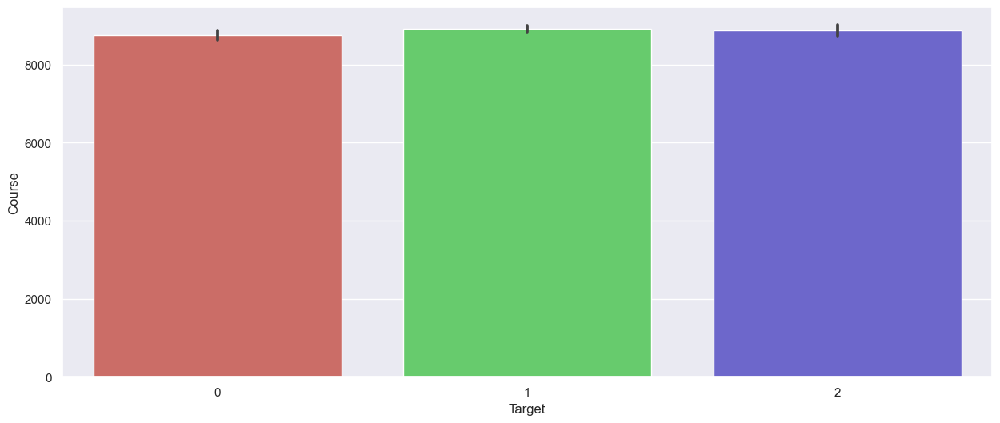

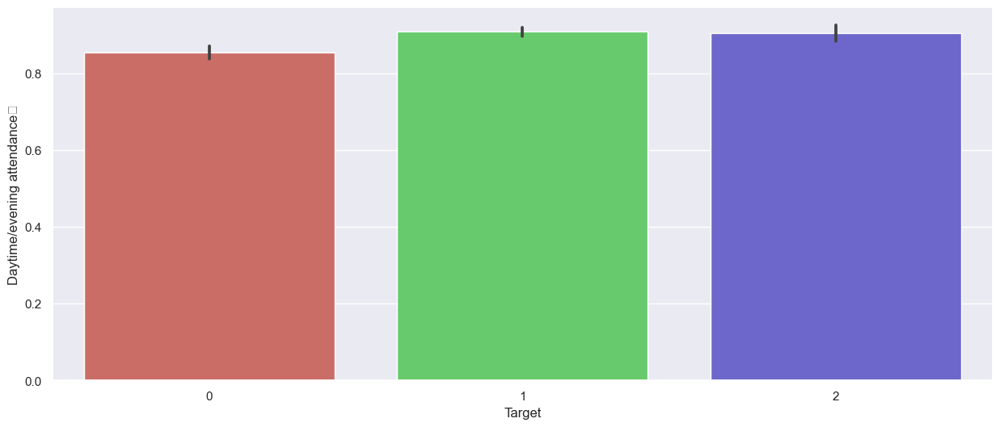

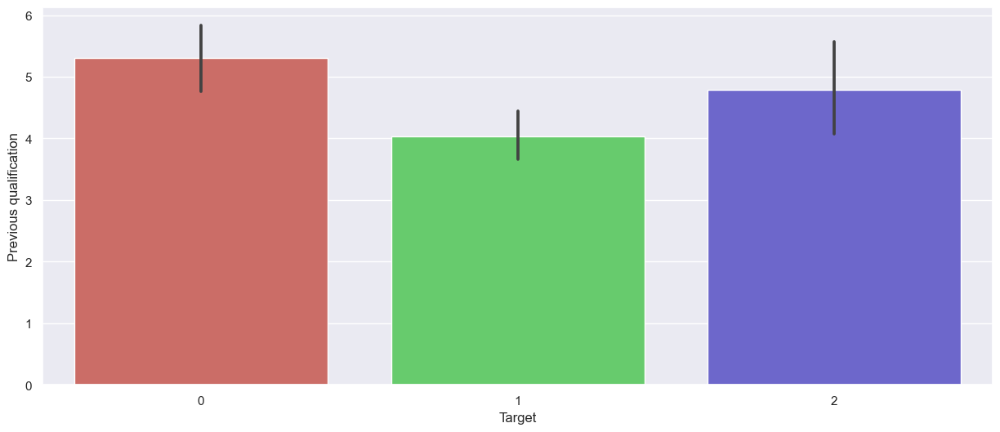

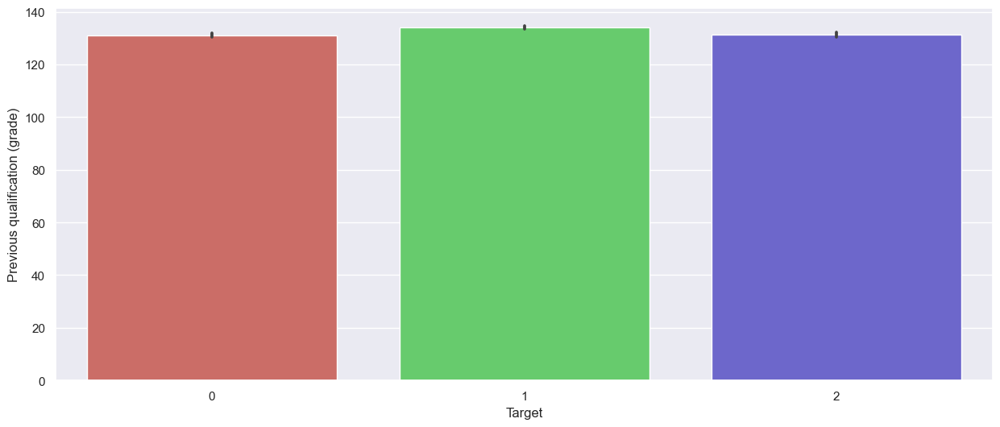

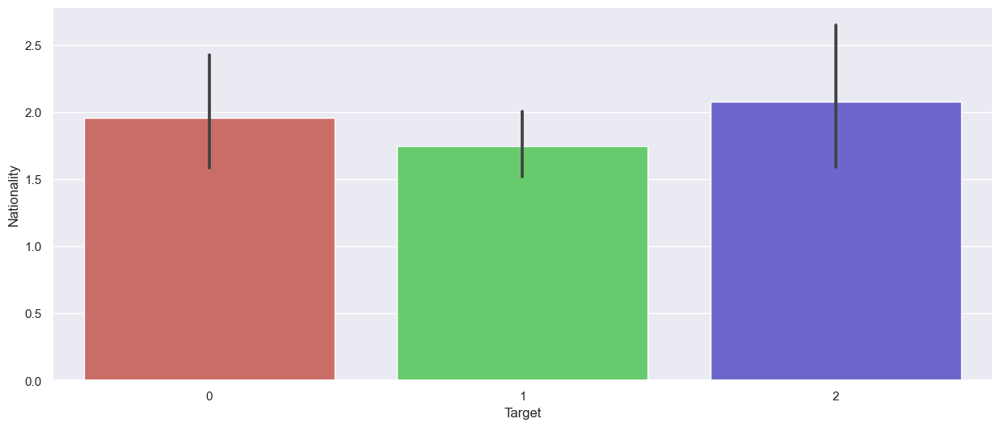

...

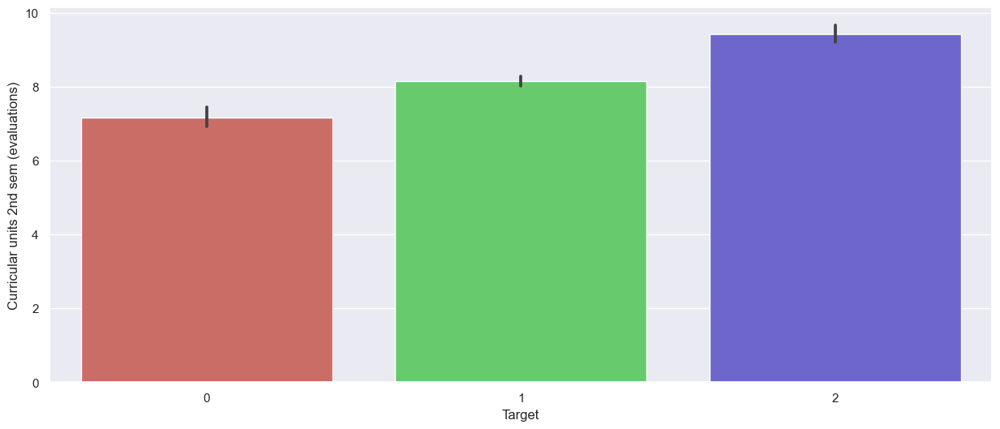

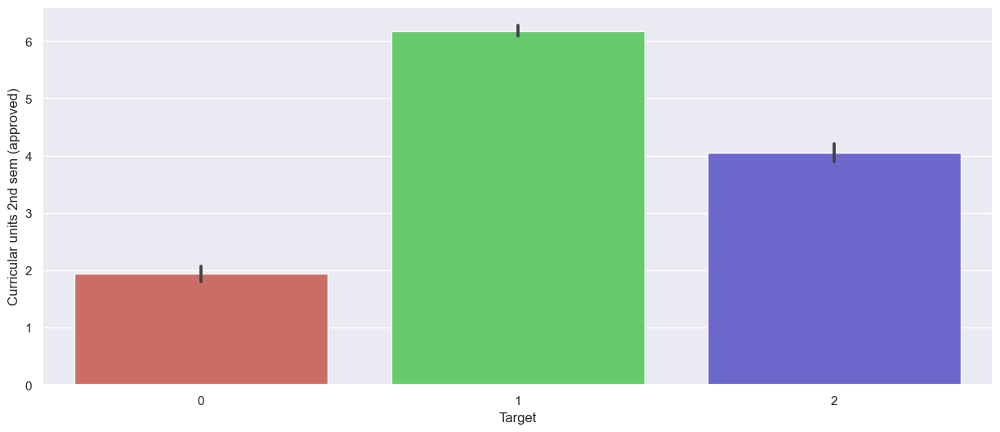

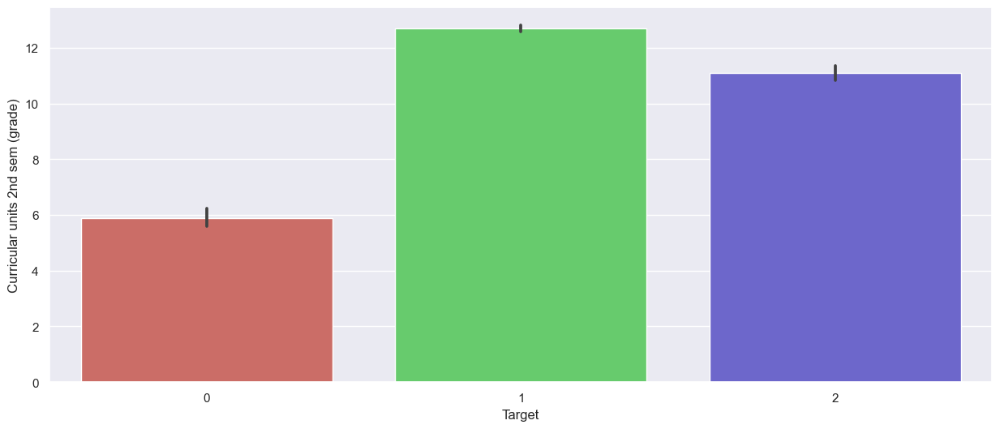

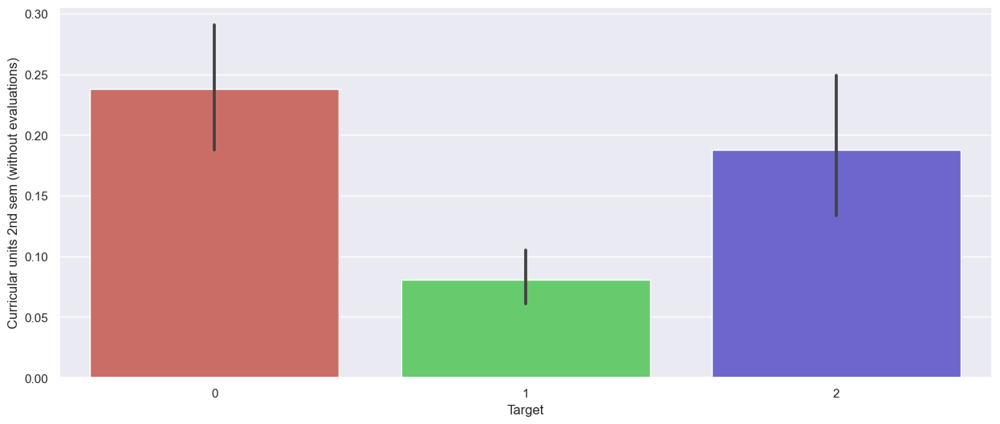

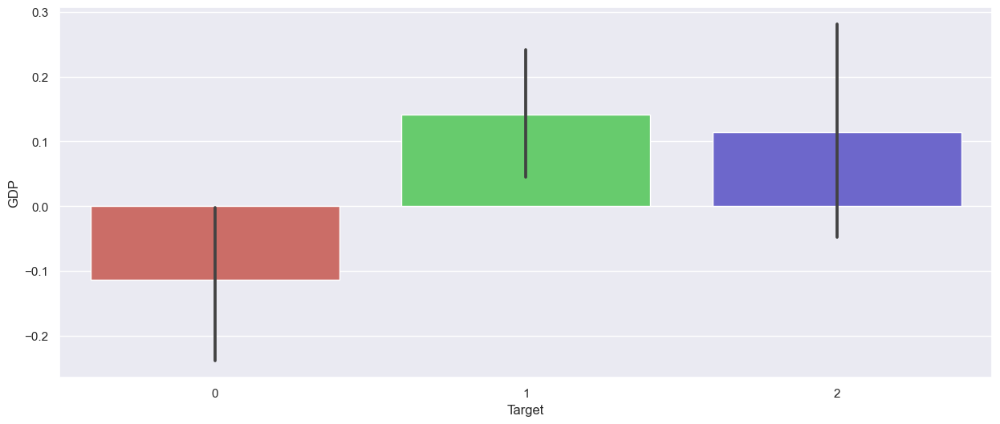

In [52]:
# Creating bar plots to visualize the relationship between the target variable (Target) and other features in dataset. 
# This is a good approach for understanding how different features might be related to the target variable.

df2 = df1.iloc[:, :-1] 
# Print column names for inspection
print(df2.columns)
for i in df2.columns:
  plt.figure(figsize=(15,6))
  sns.barplot(x = df1['Target'], y = df2[i], data = df1, palette = 'hls')
  plt.show()



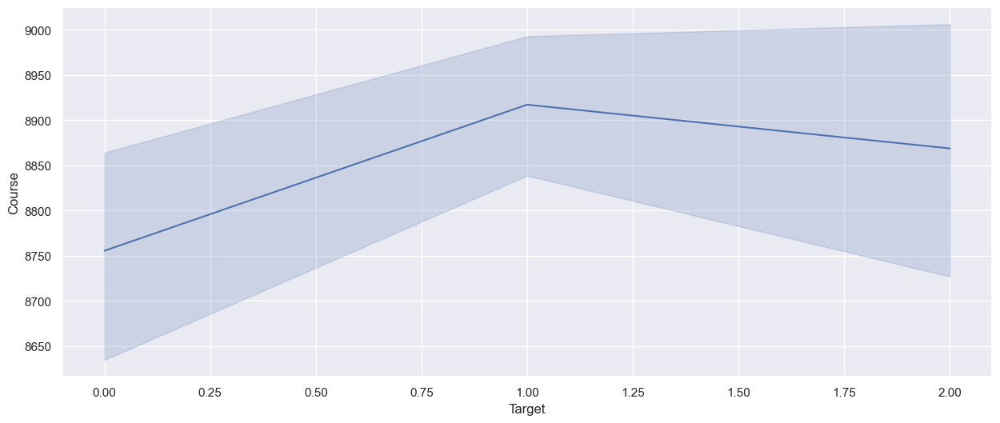

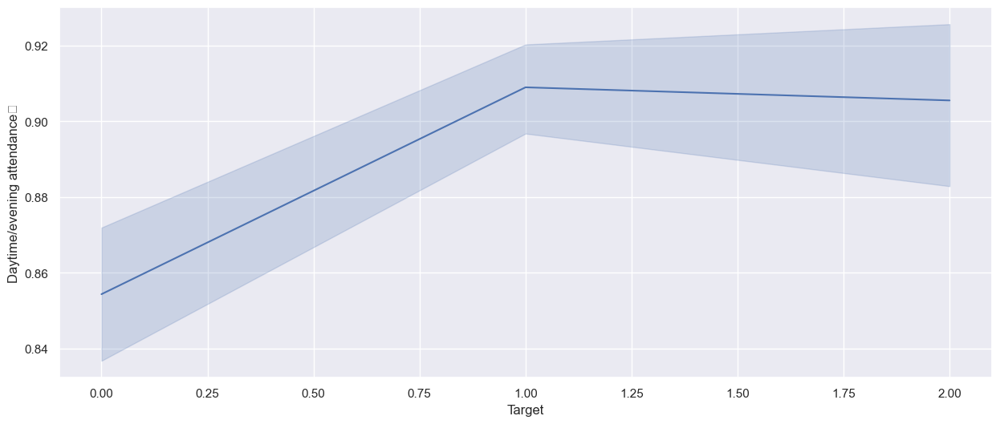

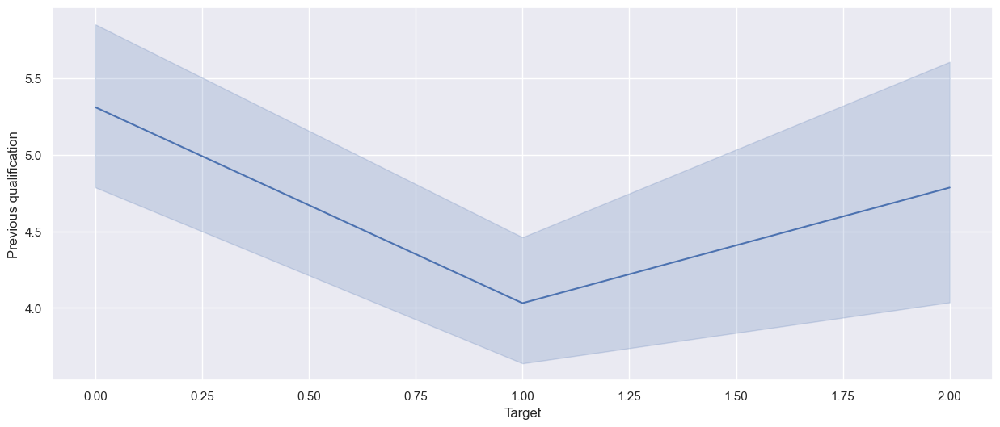

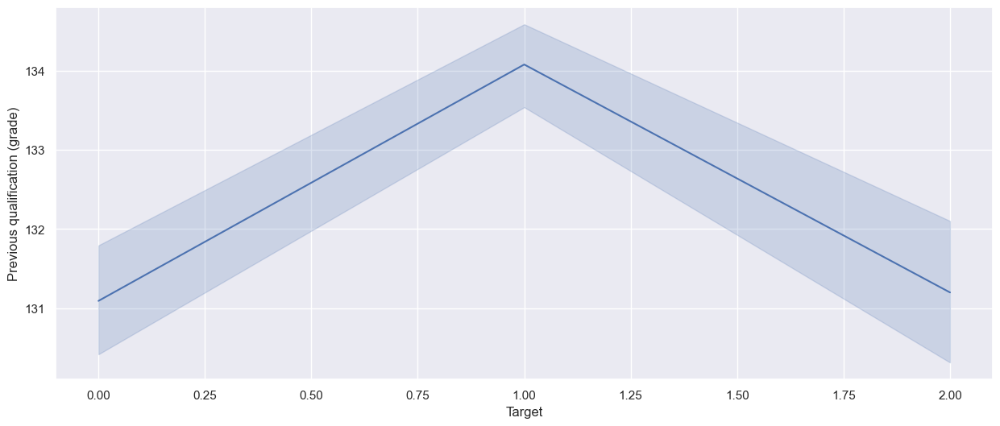

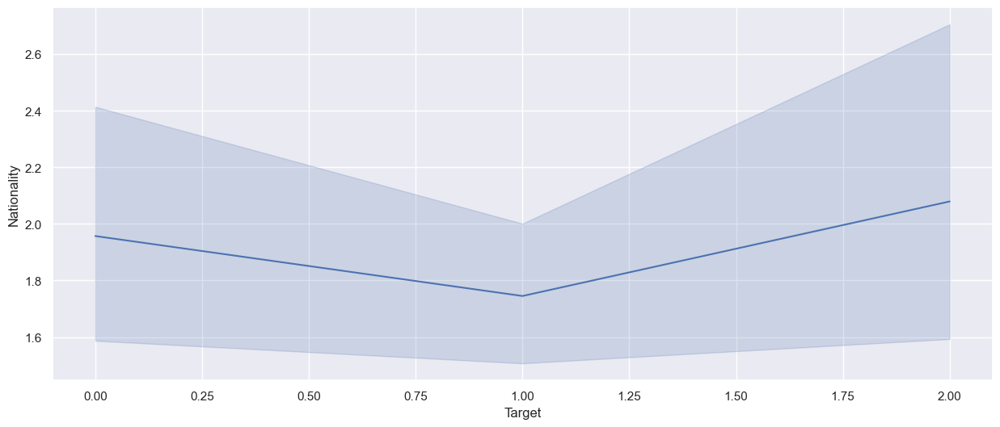

...

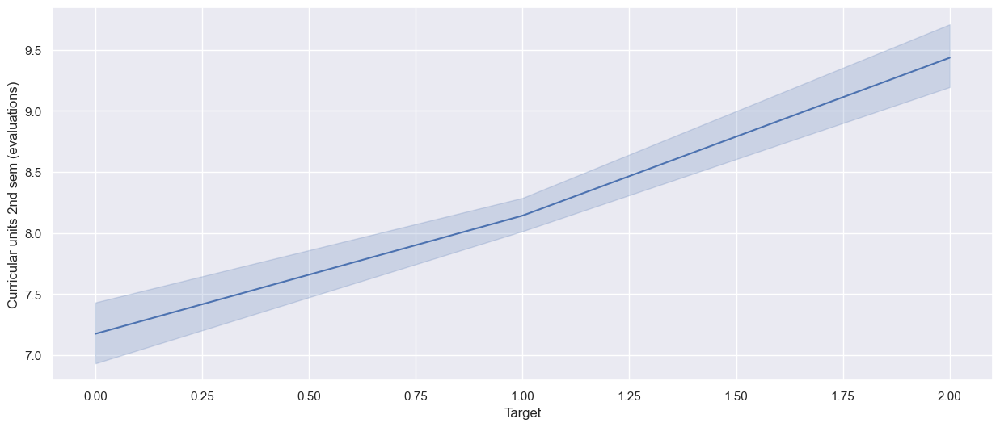

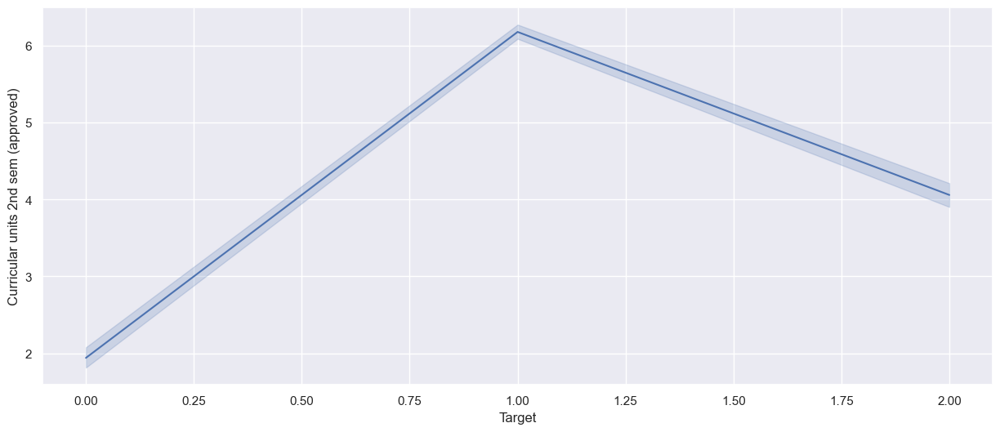

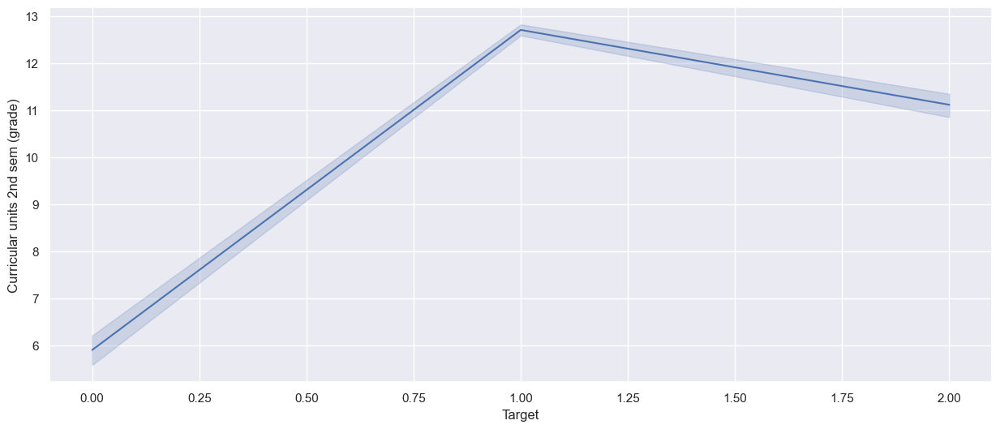

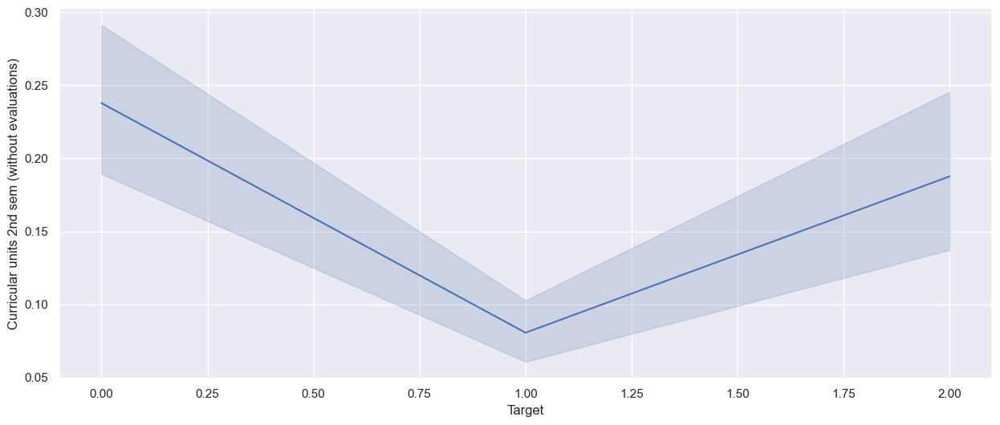

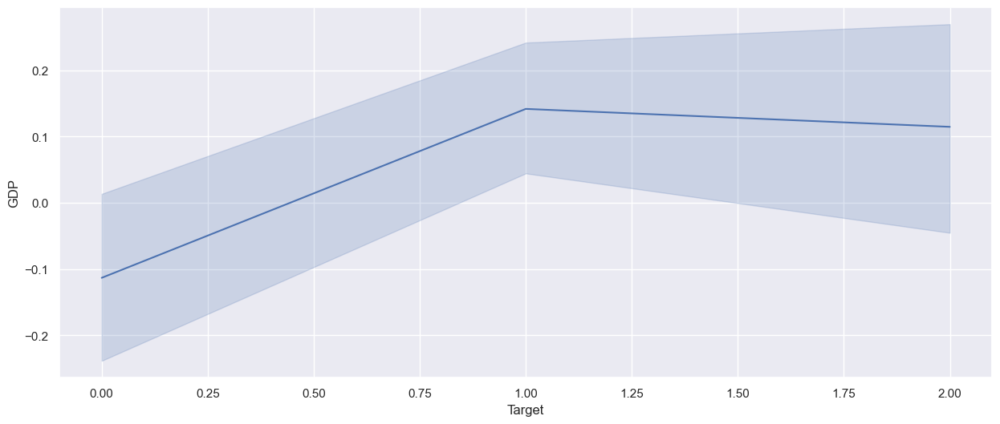

In [53]:
 # Using line plots to visualize the relationship between the target variable (Target) and other features in dataset. 
# Line plots are typically used to show the trend or pattern of a variable over a continuous axis.
for i in df2.columns:
  plt.figure(figsize=(15,6))
  sns.lineplot(x = df1['Target'], y = df2[i], data = df1, palette = 'hls')
  plt.show()

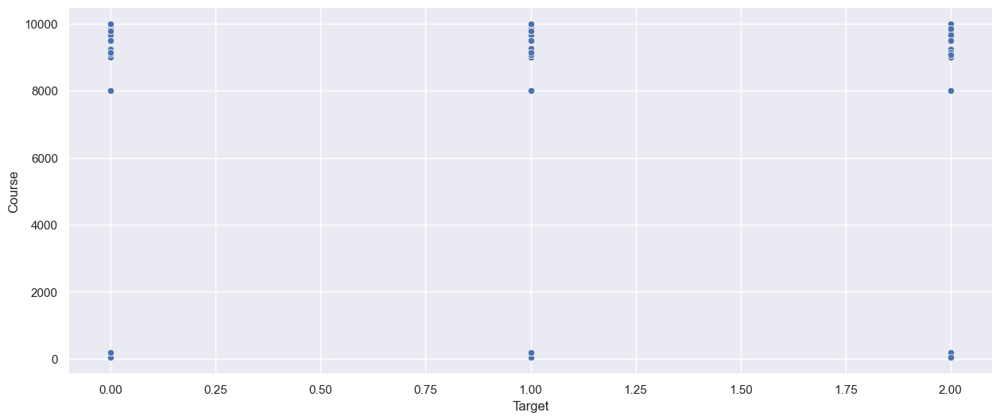

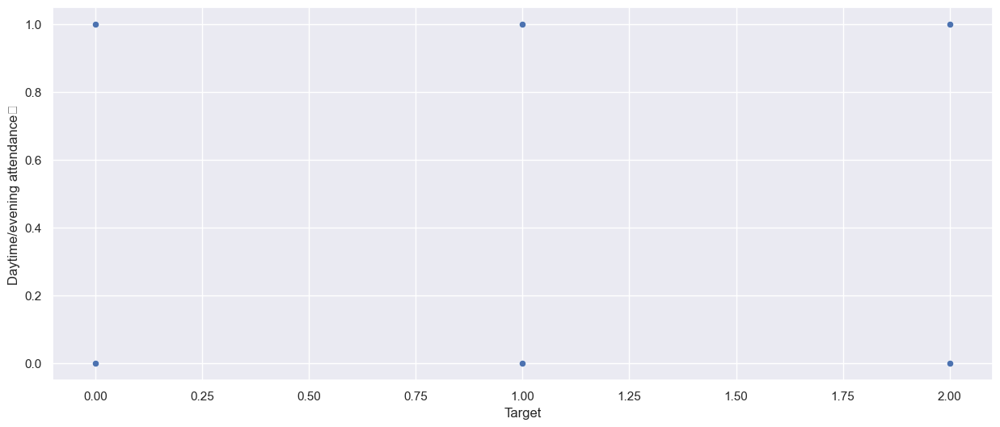

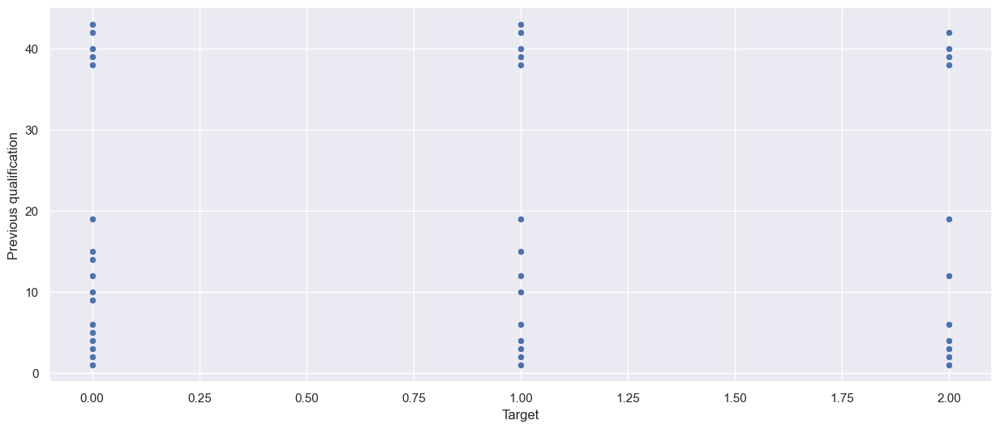

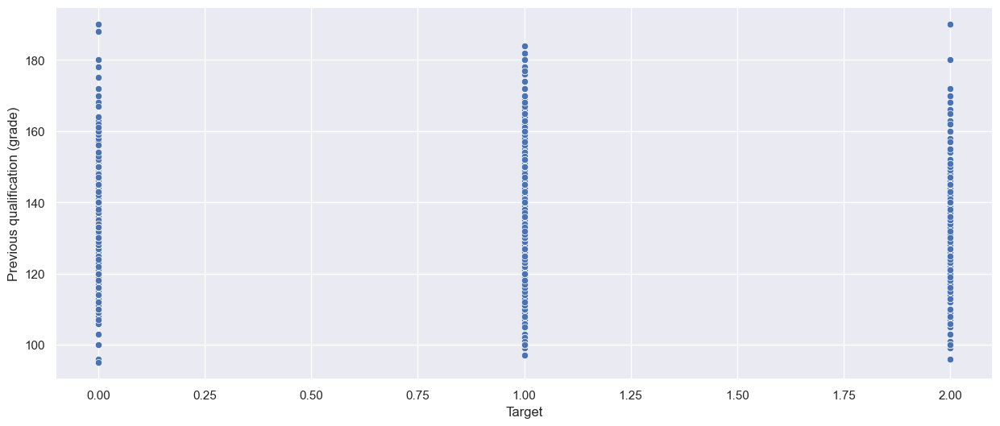

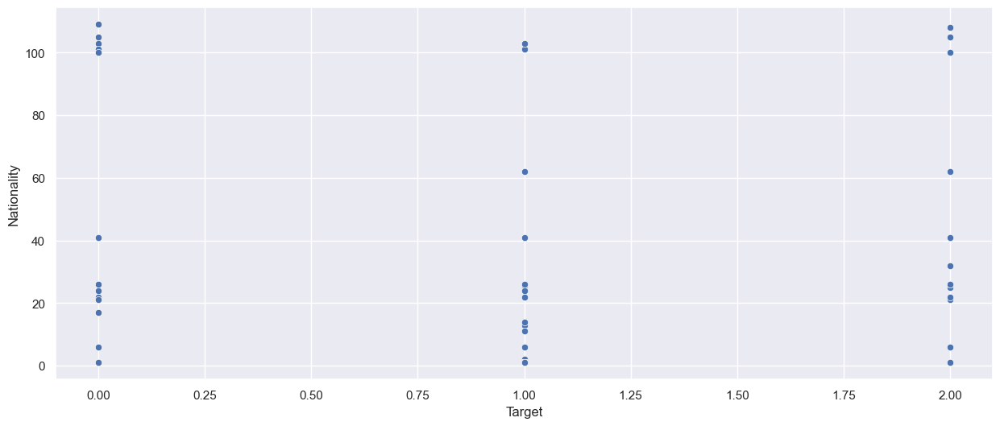

...

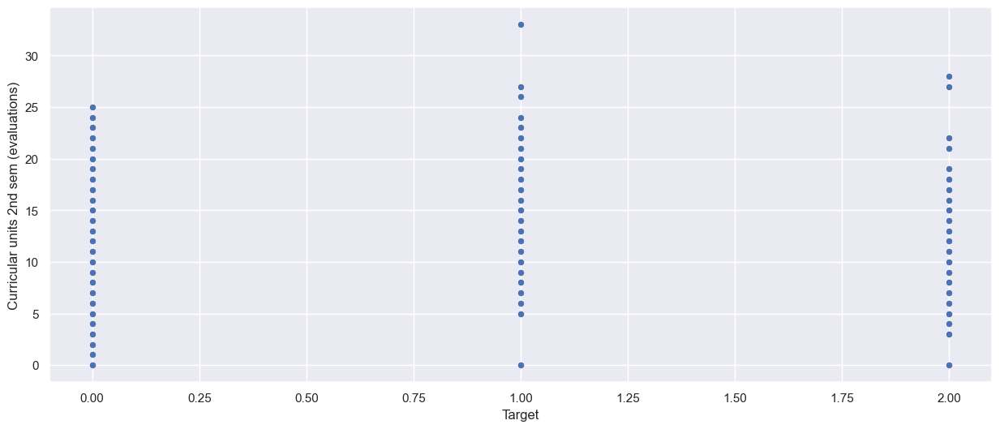

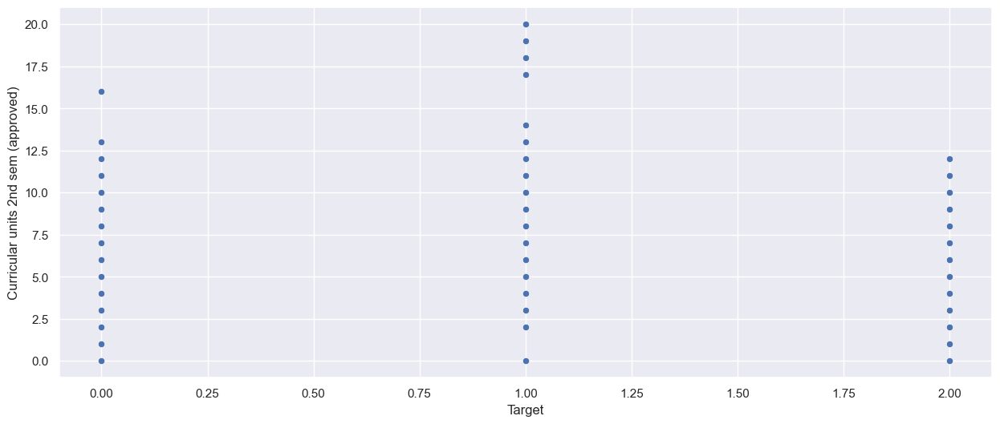

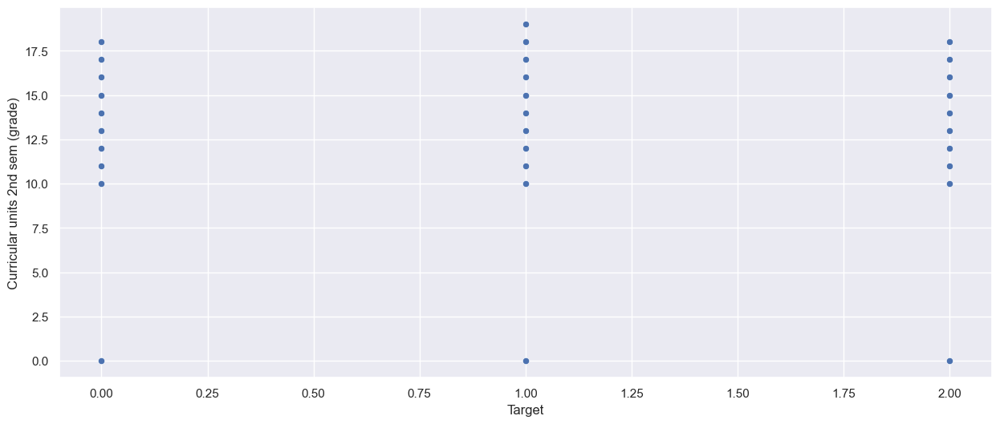

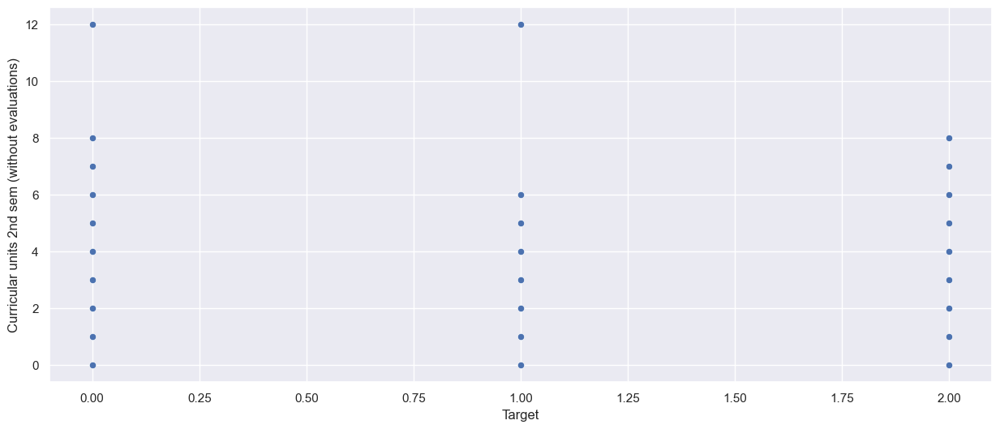

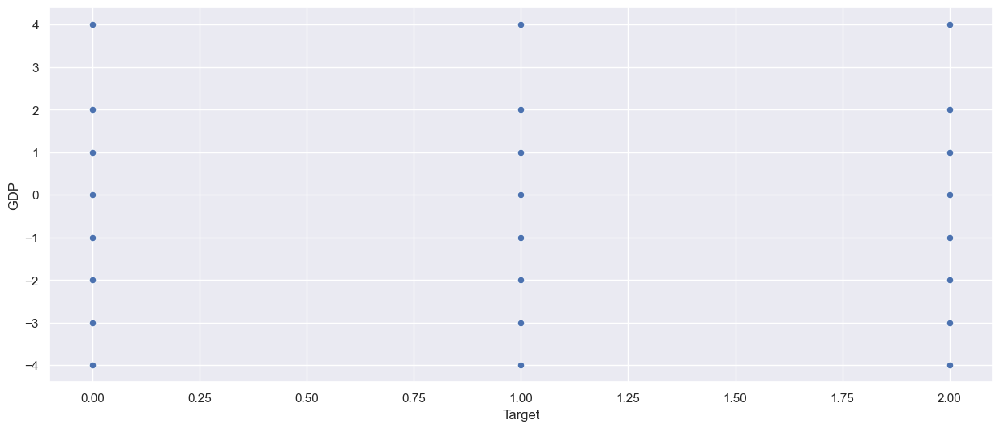

In [54]:
# using scatter plots to visualize the relationship between the target variable (Target) and other features in dataset.
# Scatter plots are useful for visualizing the distribution and relationship between two continuous variables.
for i in df2.columns:
  plt.figure(figsize=(15,6))
  sns.scatterplot(x = df1['Target'], y = df2[i], data = df1, palette = 'hls')
  plt.show()


<Figure size 1500x600 with 0 Axes>

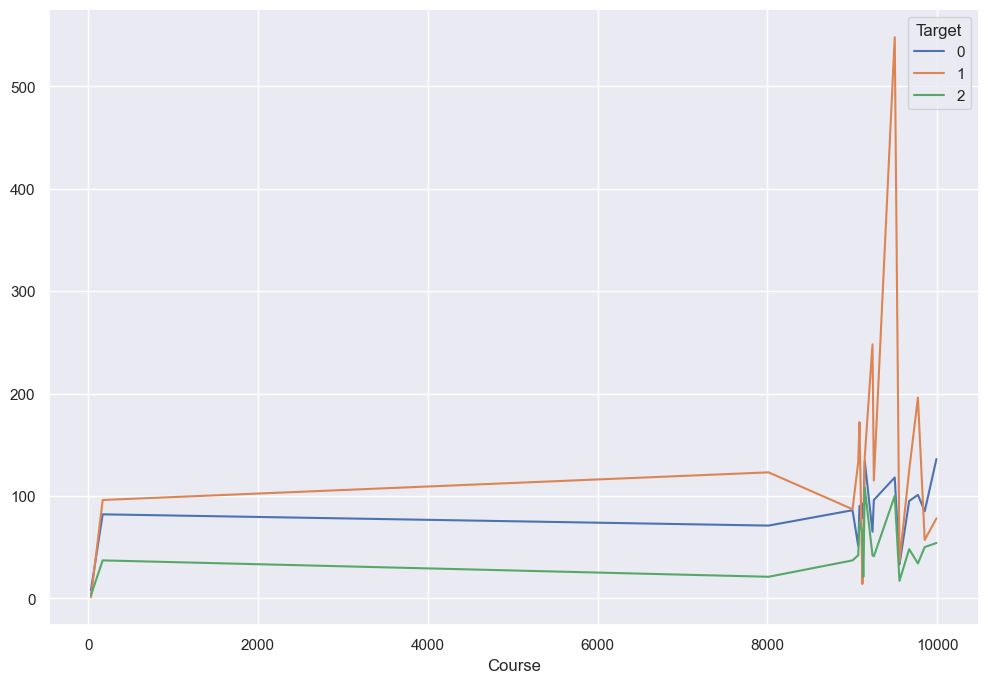

<Figure size 1500x600 with 0 Axes>

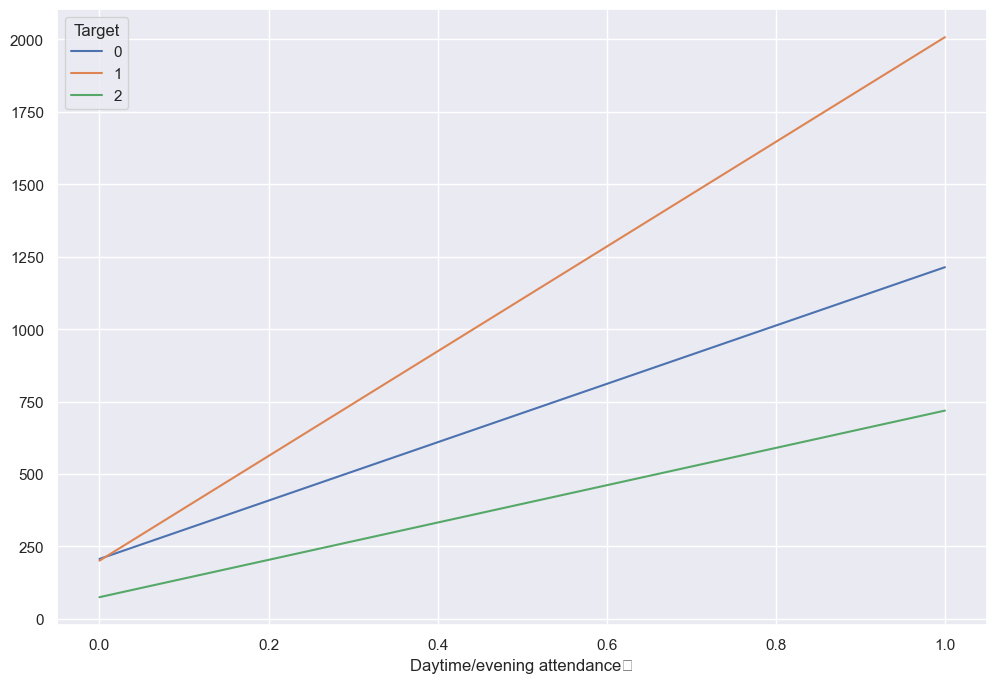

<Figure size 1500x600 with 0 Axes>

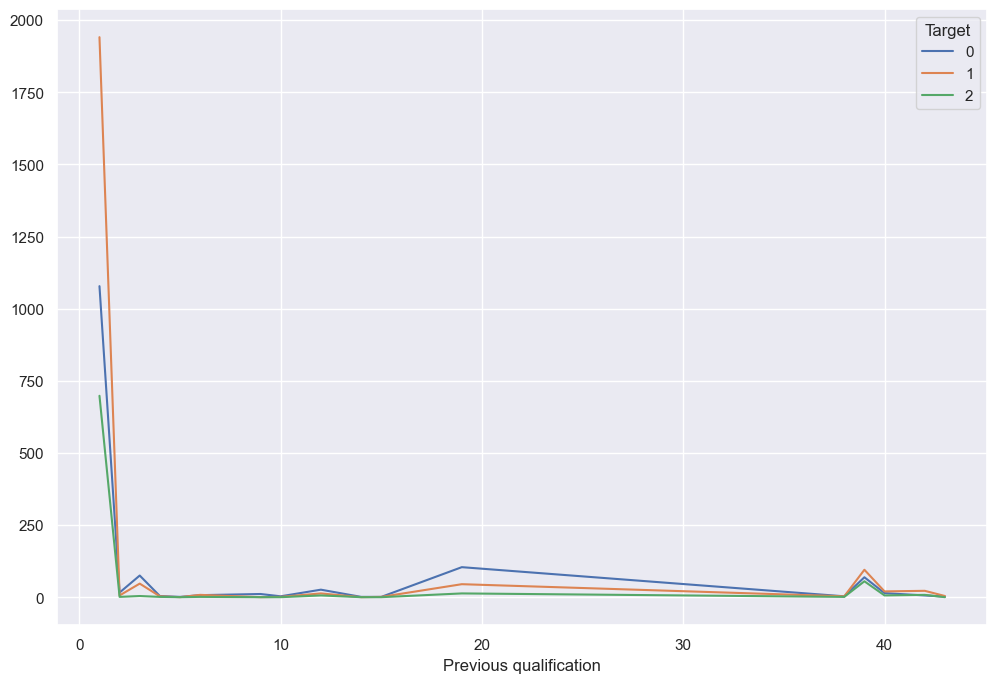

<Figure size 1500x600 with 0 Axes>

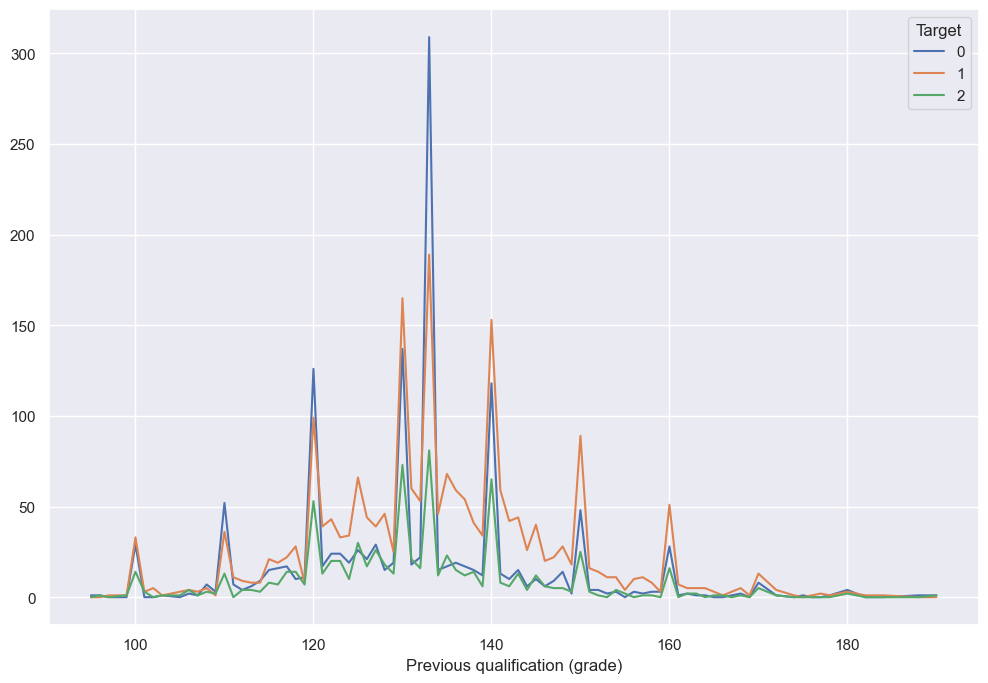

<Figure size 1500x600 with 0 Axes>

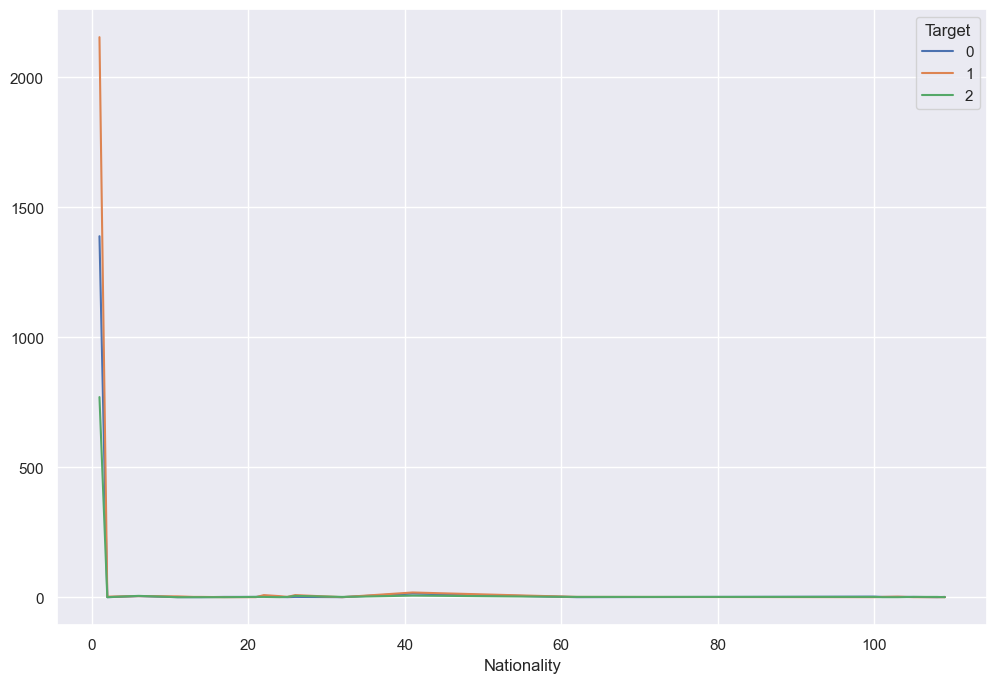

<Figure size 1500x600 with 0 Axes>

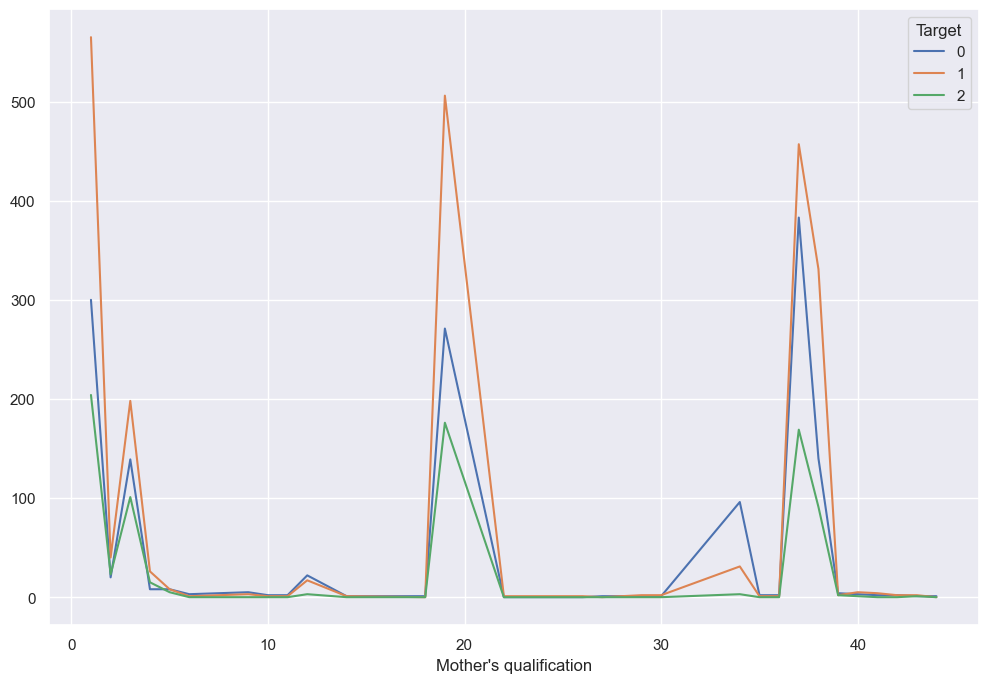

<Figure size 1500x600 with 0 Axes>

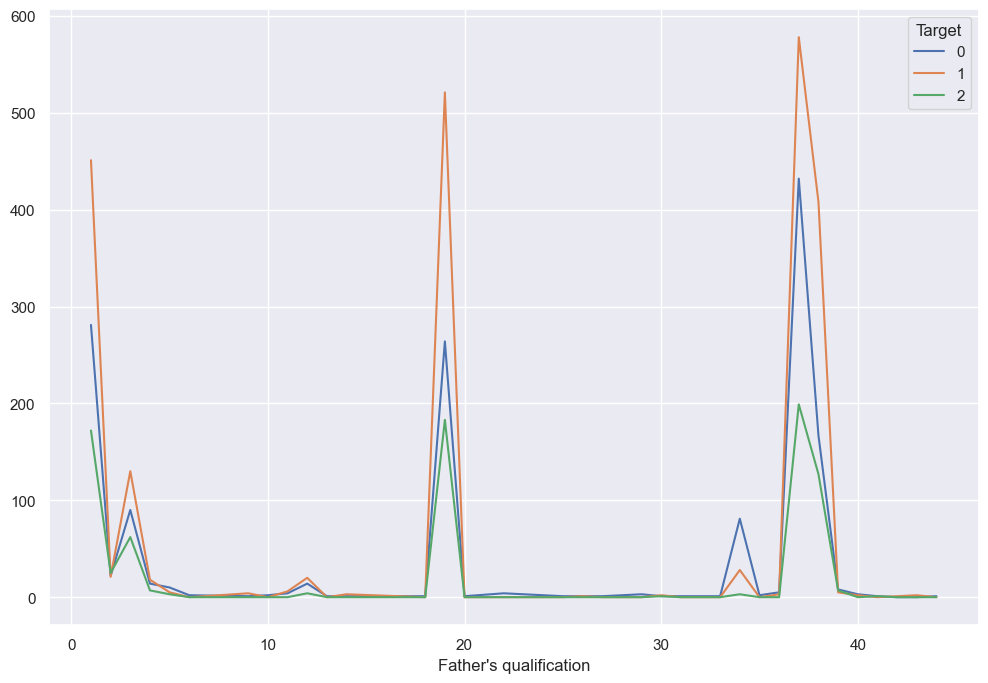

<Figure size 1500x600 with 0 Axes>

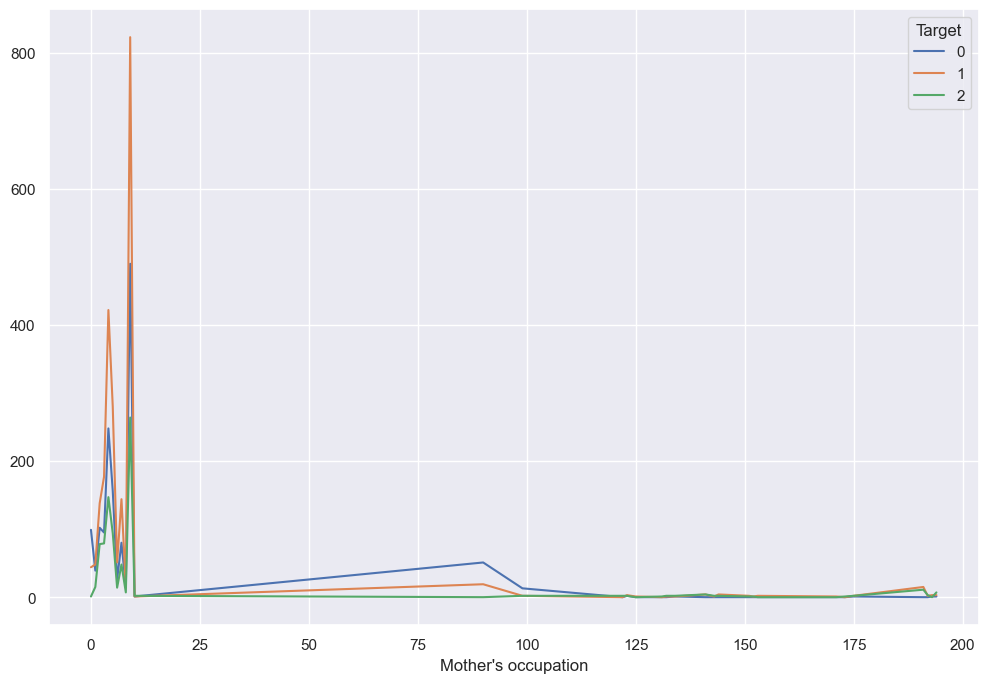

<Figure size 1500x600 with 0 Axes>

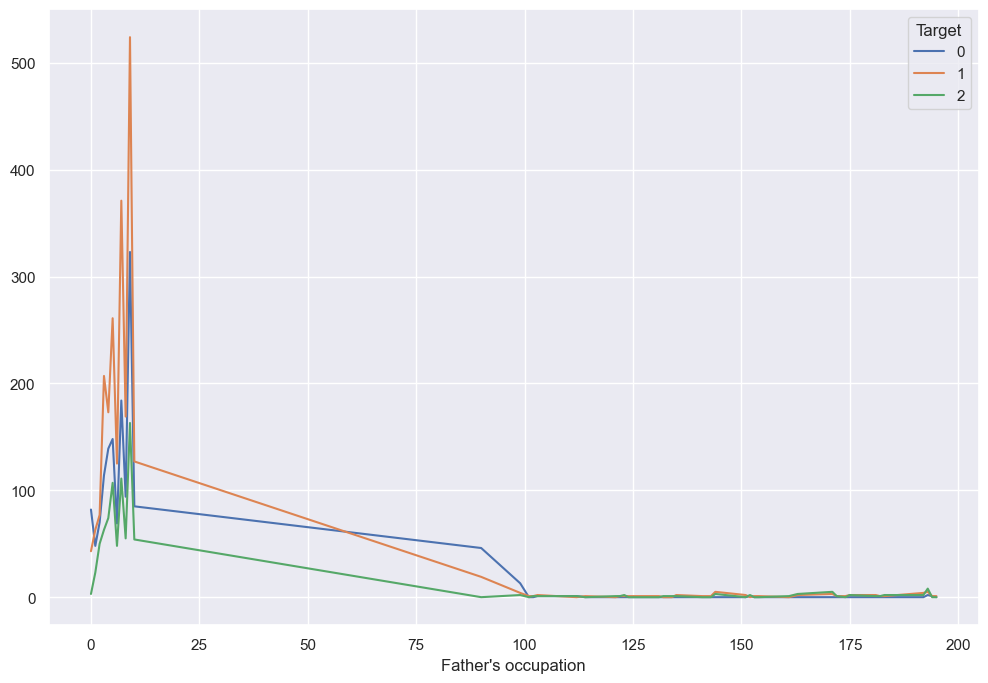

<Figure size 1500x600 with 0 Axes>

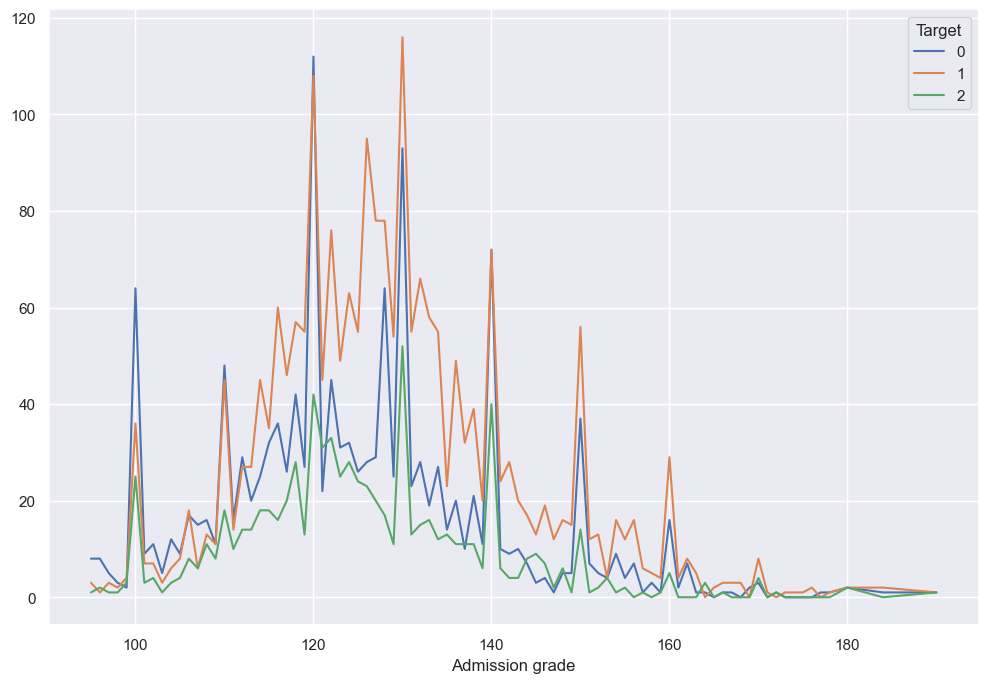

<Figure size 1500x600 with 0 Axes>

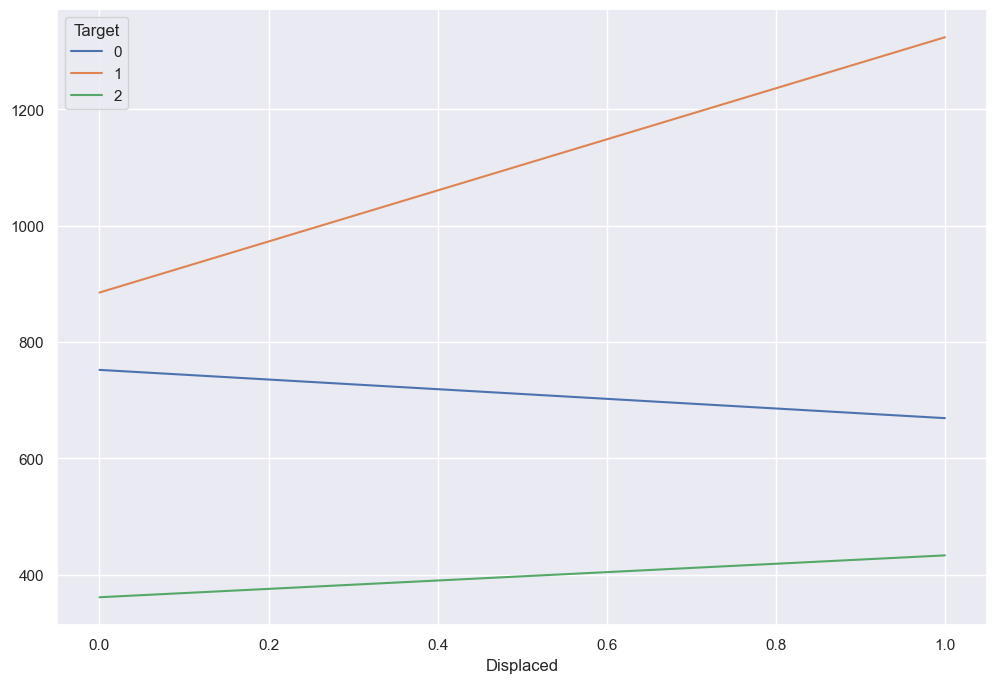

<Figure size 1500x600 with 0 Axes>

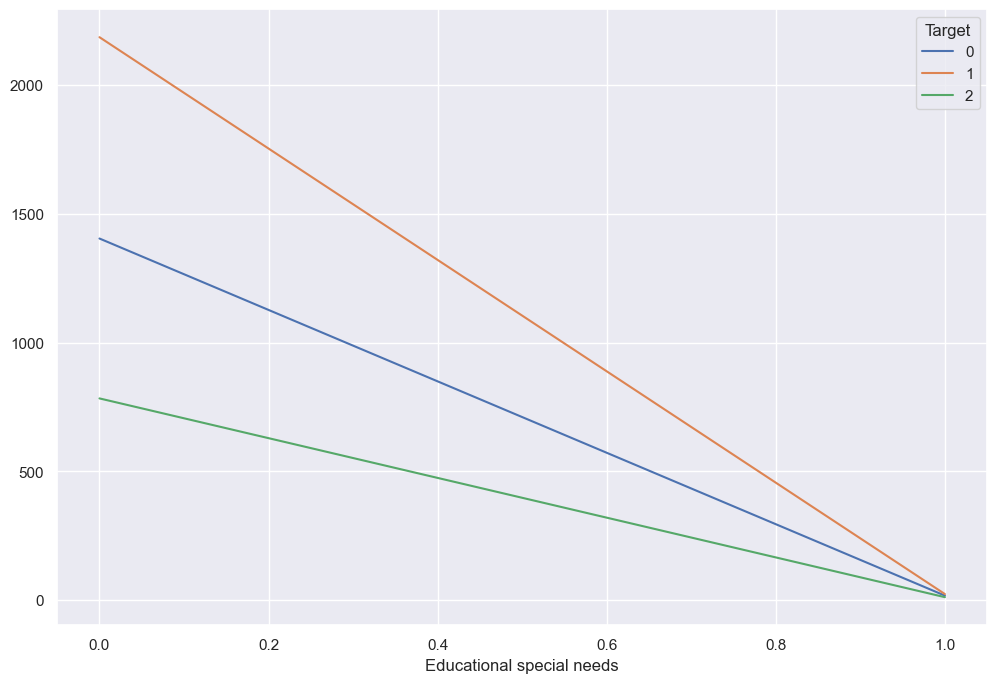

<Figure size 1500x600 with 0 Axes>

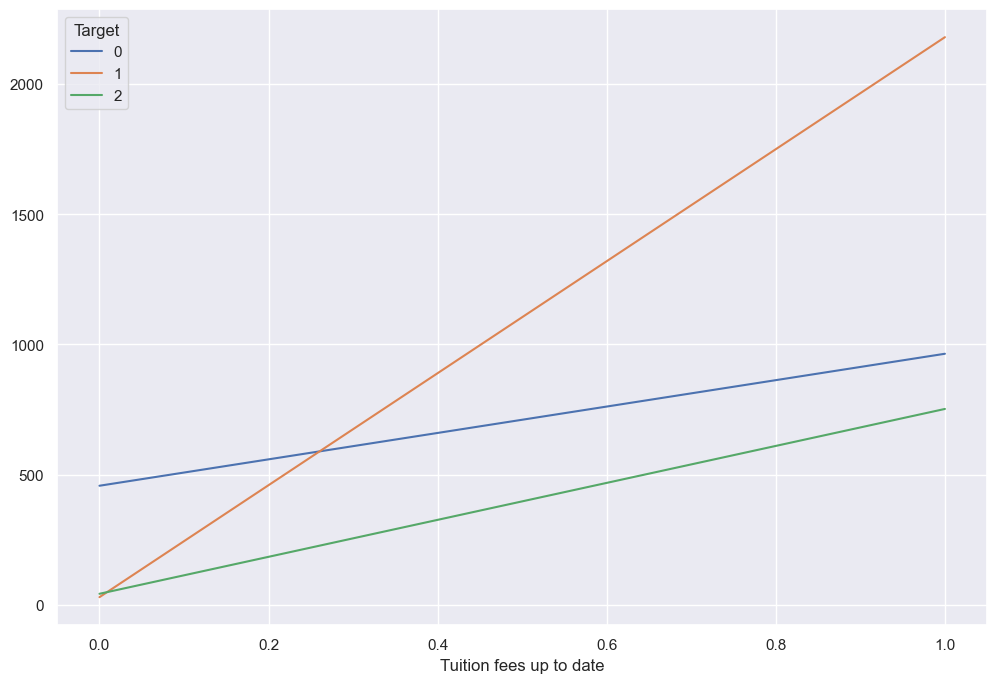

<Figure size 1500x600 with 0 Axes>

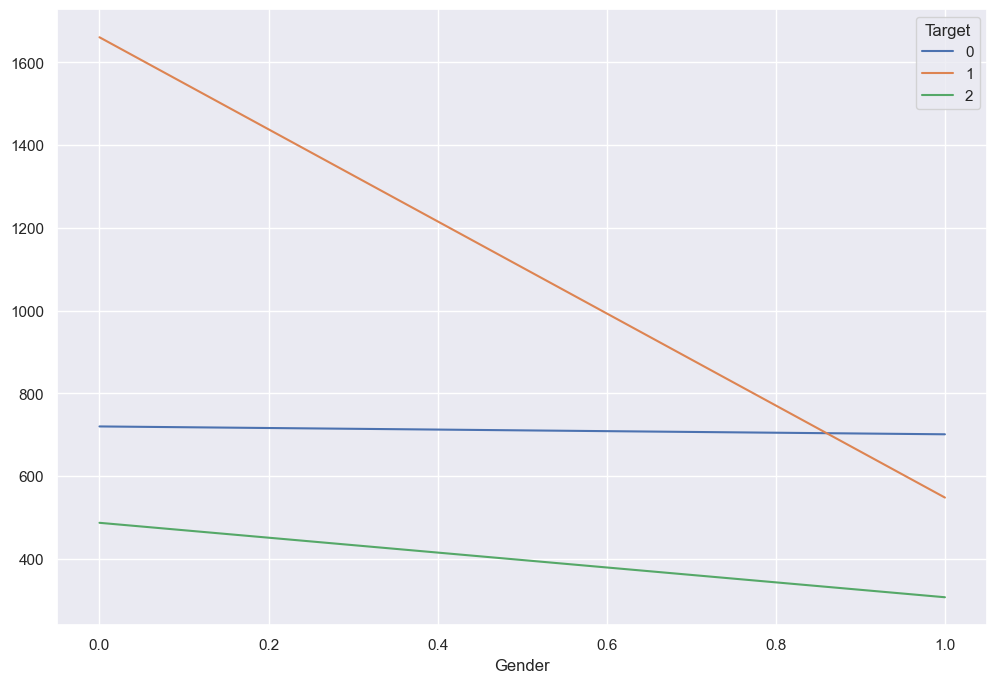

<Figure size 1500x600 with 0 Axes>

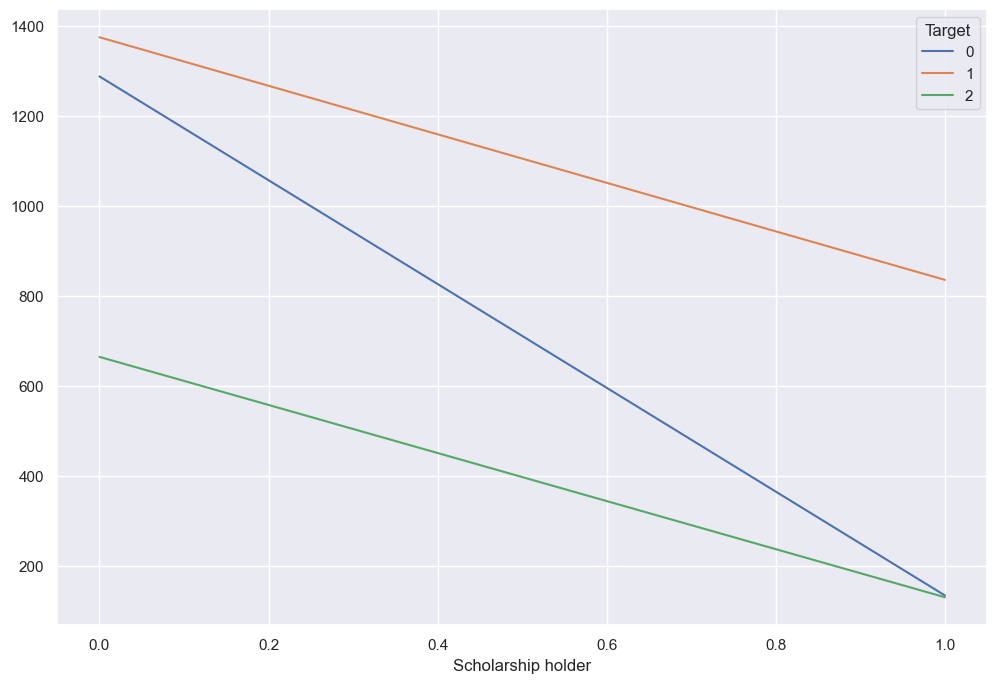

<Figure size 1500x600 with 0 Axes>

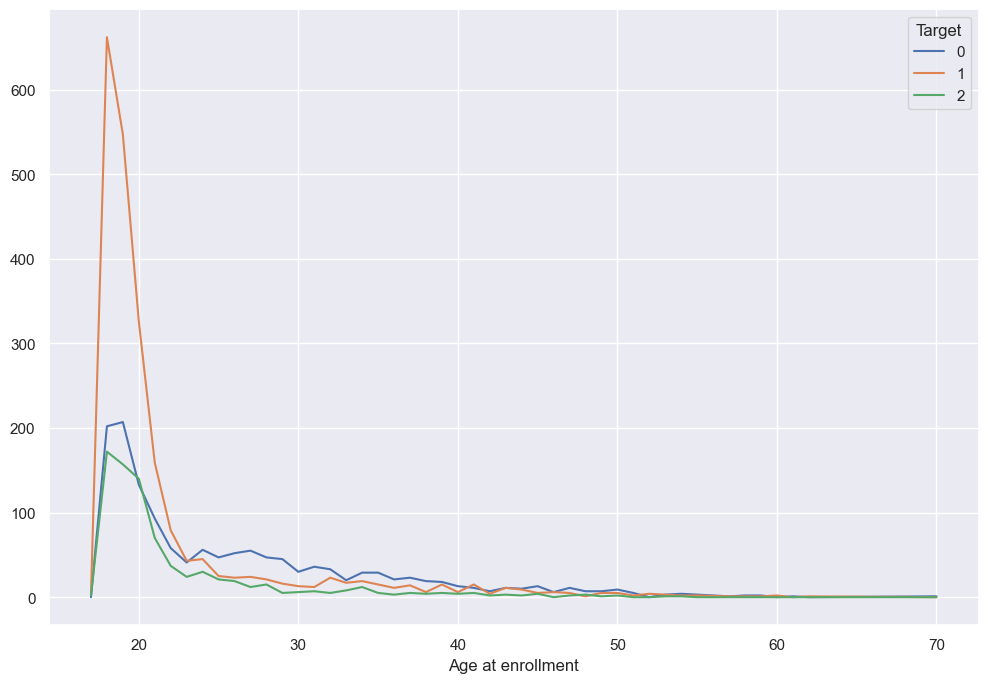

<Figure size 1500x600 with 0 Axes>

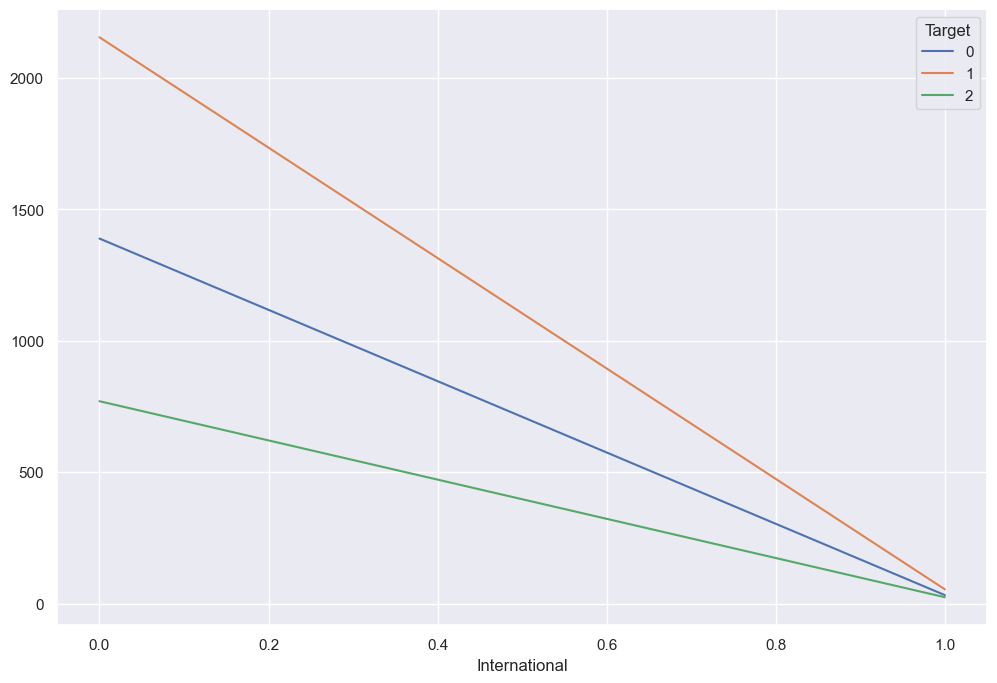

<Figure size 1500x600 with 0 Axes>

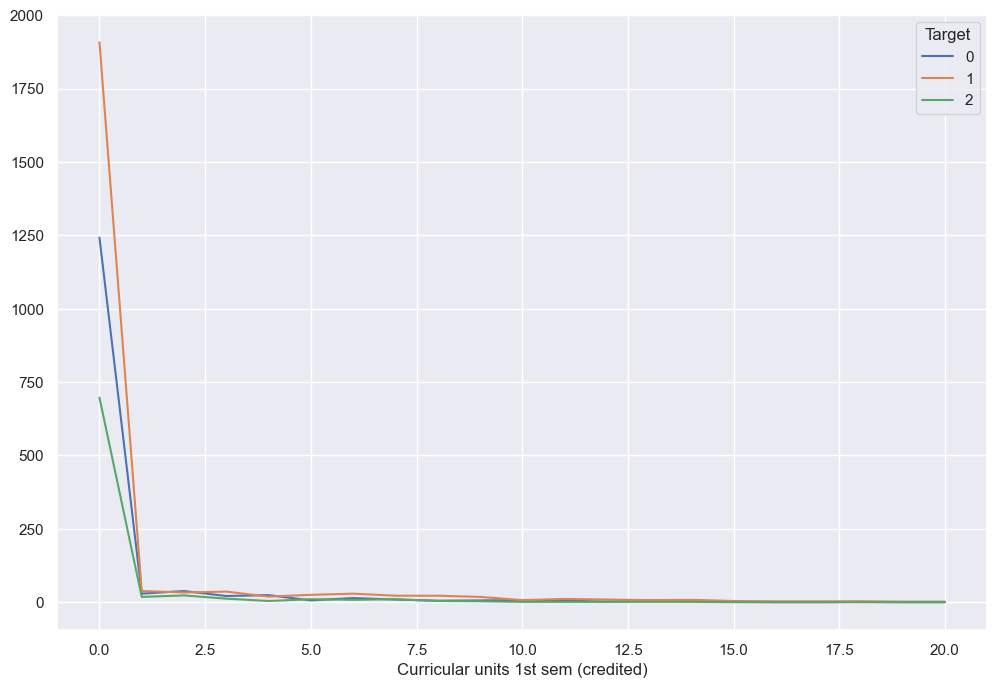

<Figure size 1500x600 with 0 Axes>

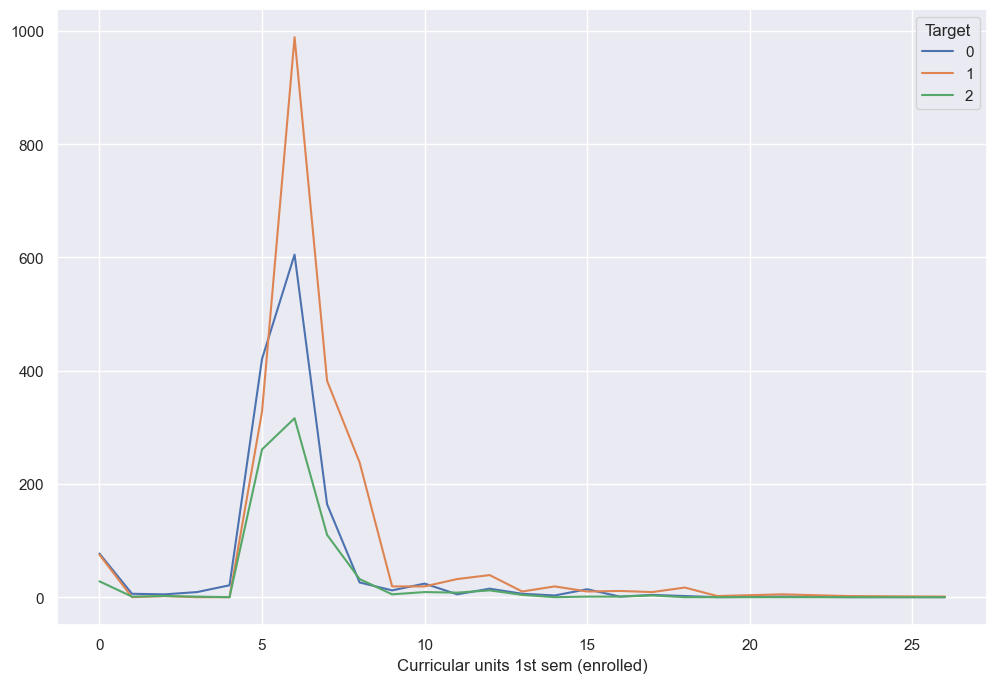

<Figure size 1500x600 with 0 Axes>

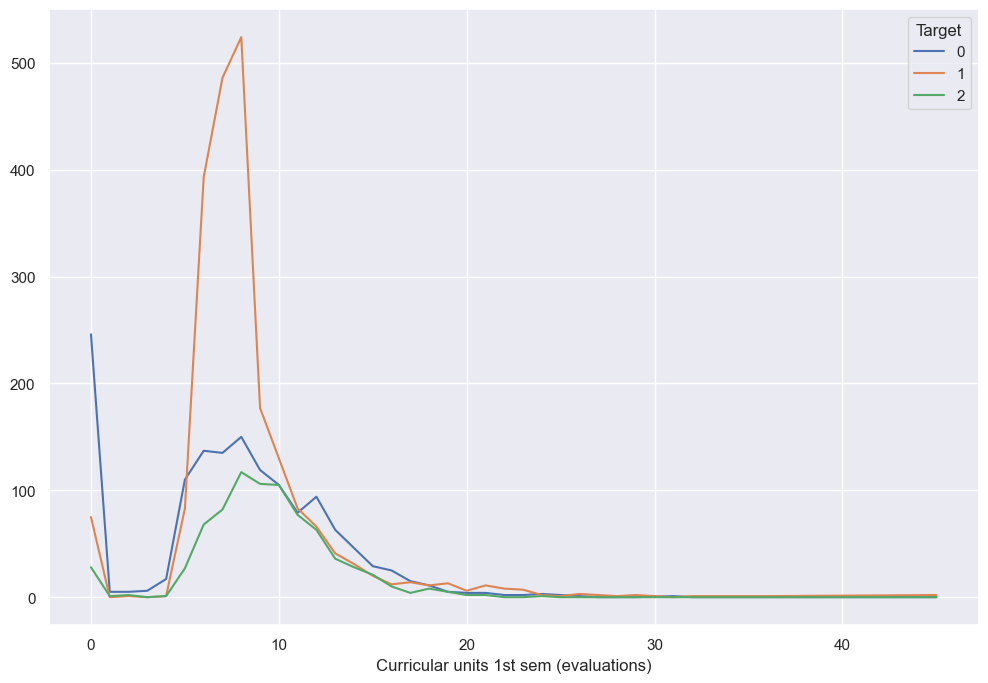

<Figure size 1500x600 with 0 Axes>

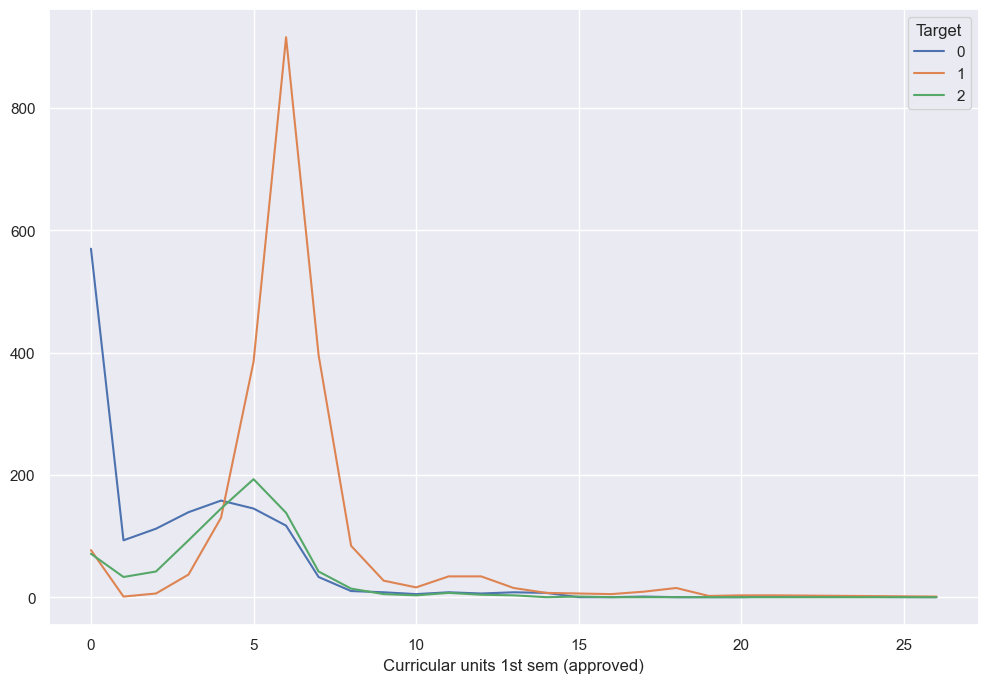

<Figure size 1500x600 with 0 Axes>

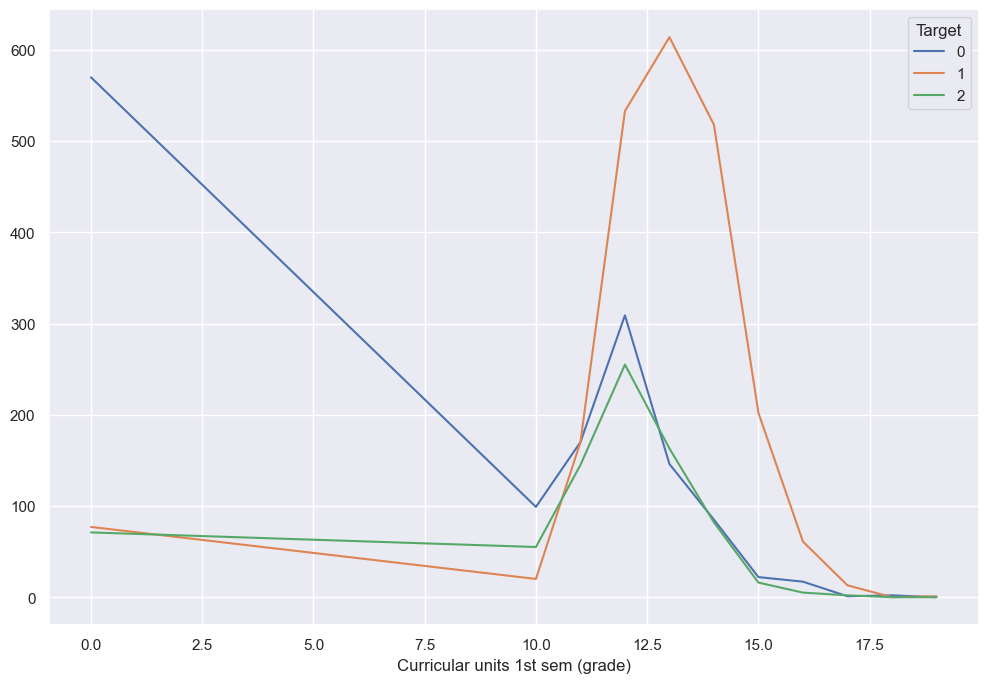

<Figure size 1500x600 with 0 Axes>

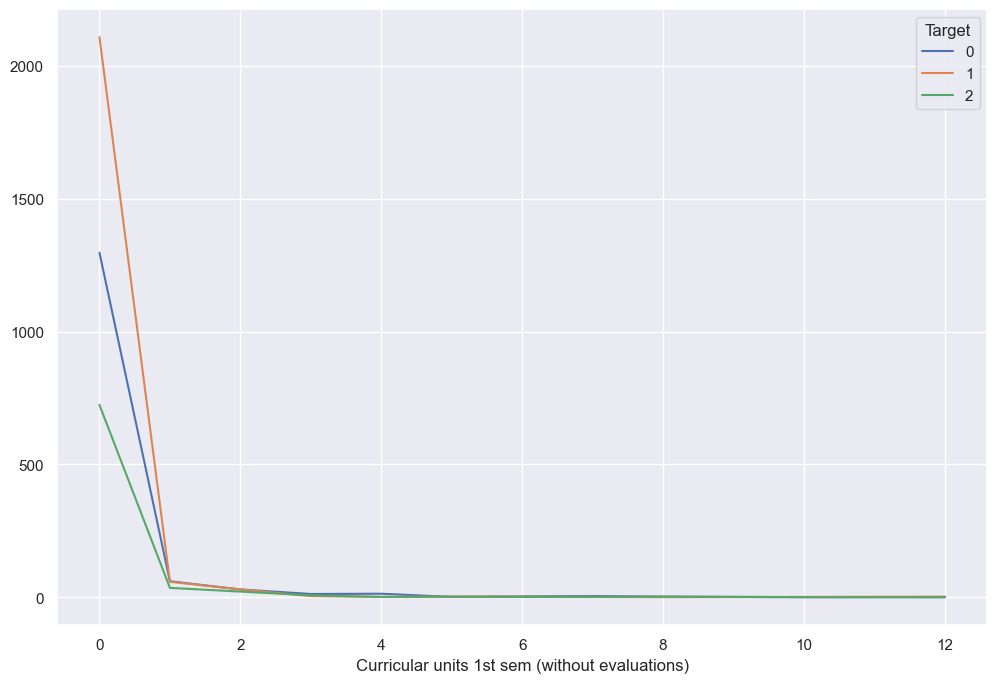

<Figure size 1500x600 with 0 Axes>

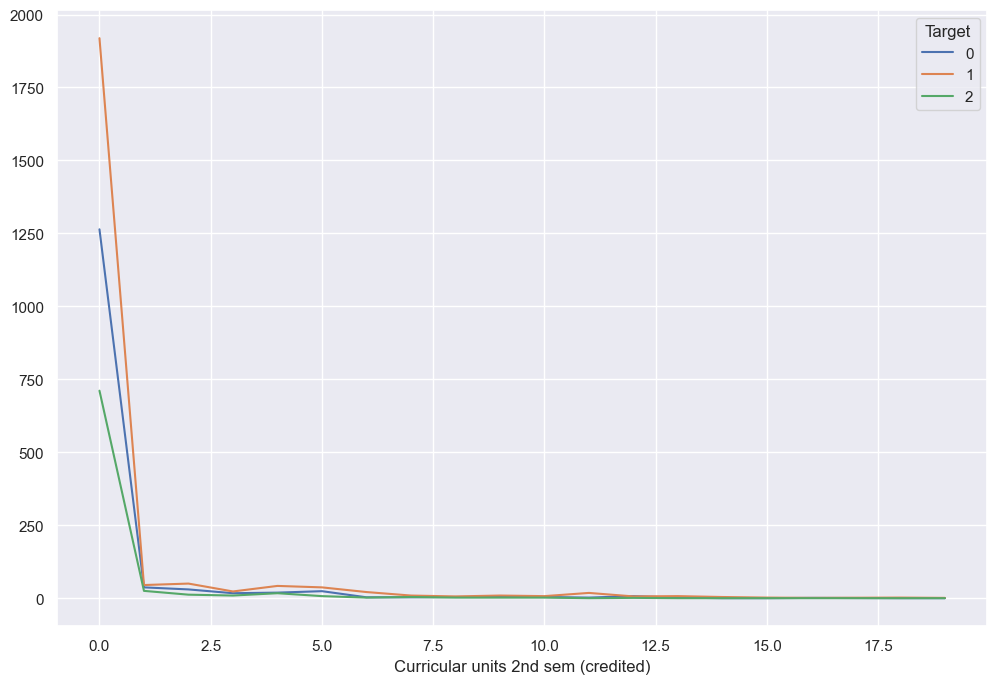

<Figure size 1500x600 with 0 Axes>

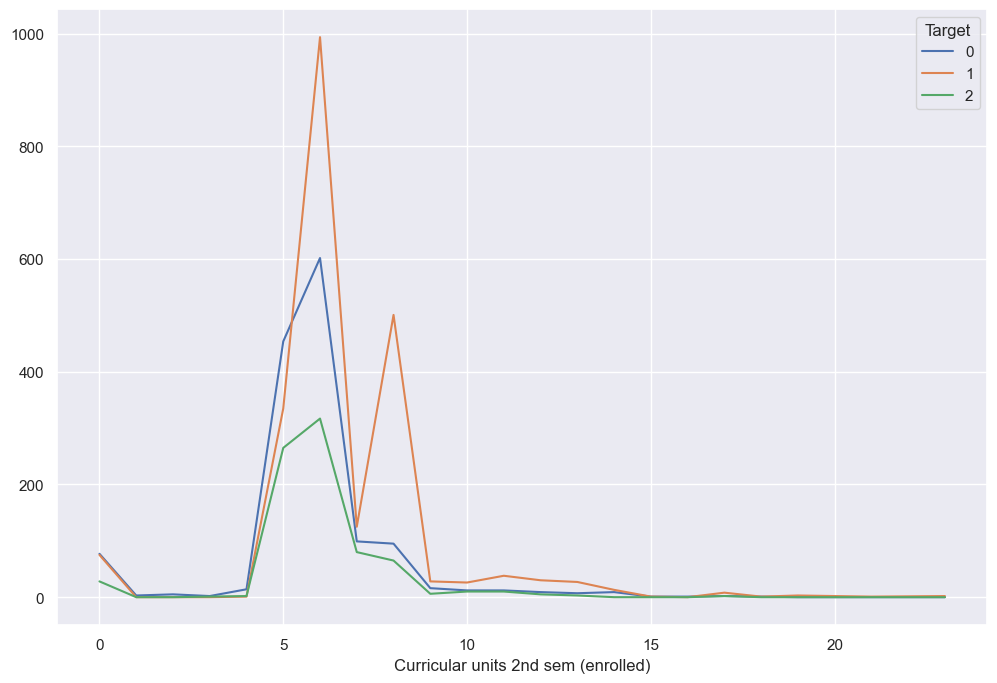

<Figure size 1500x600 with 0 Axes>

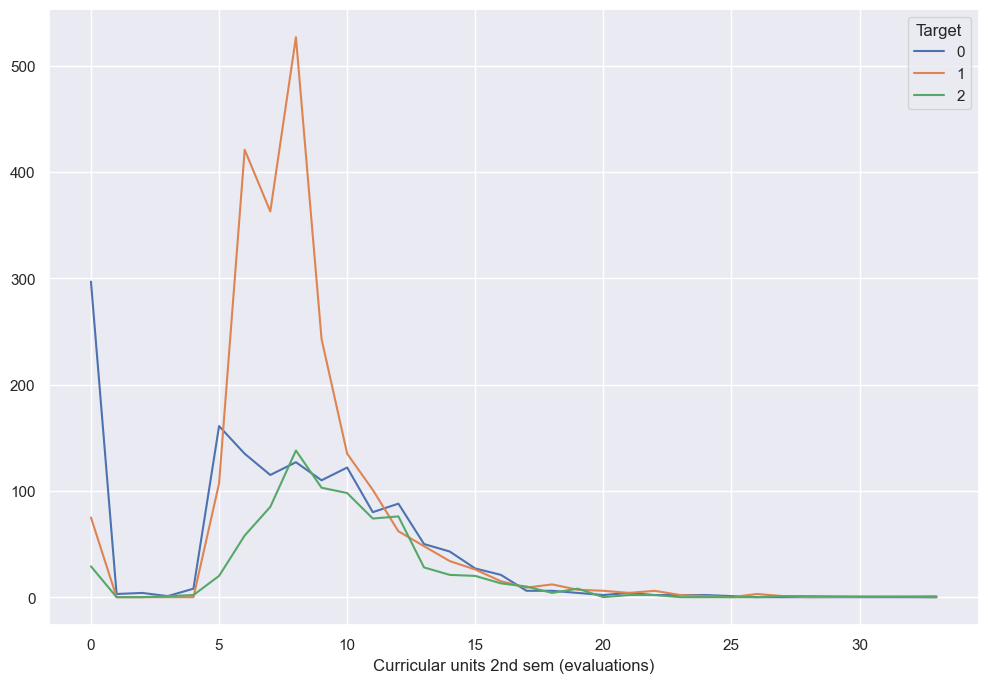

<Figure size 1500x600 with 0 Axes>

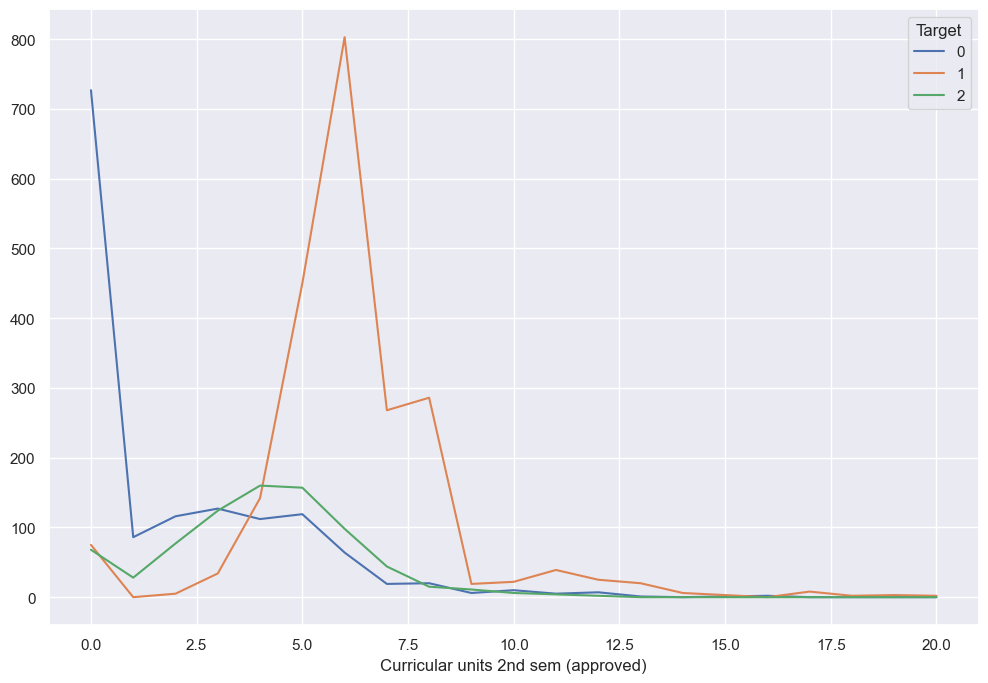

<Figure size 1500x600 with 0 Axes>

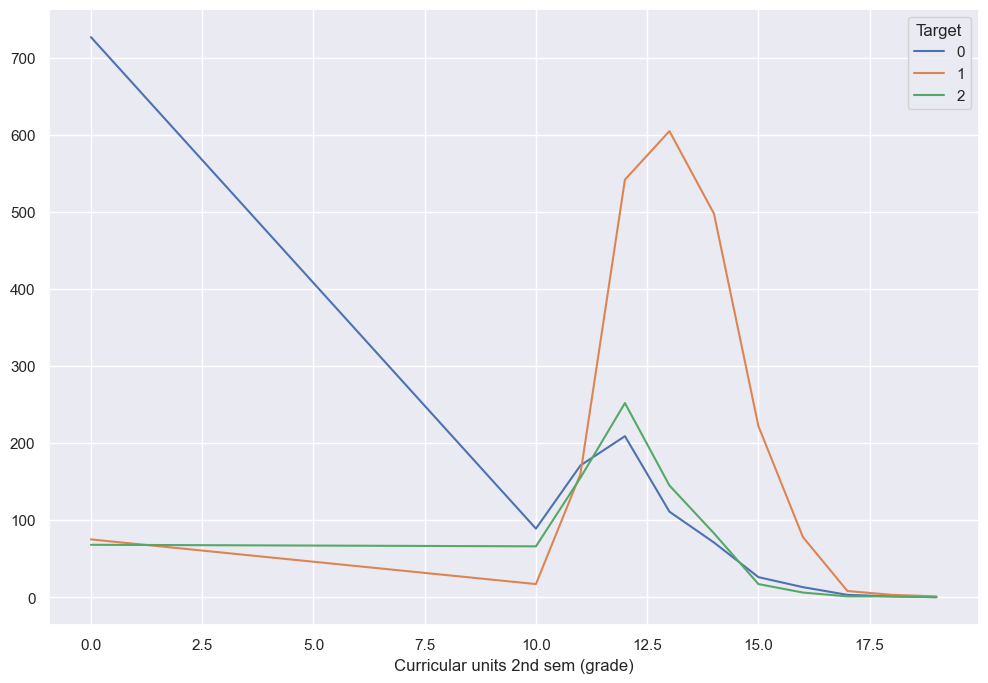

<Figure size 1500x600 with 0 Axes>

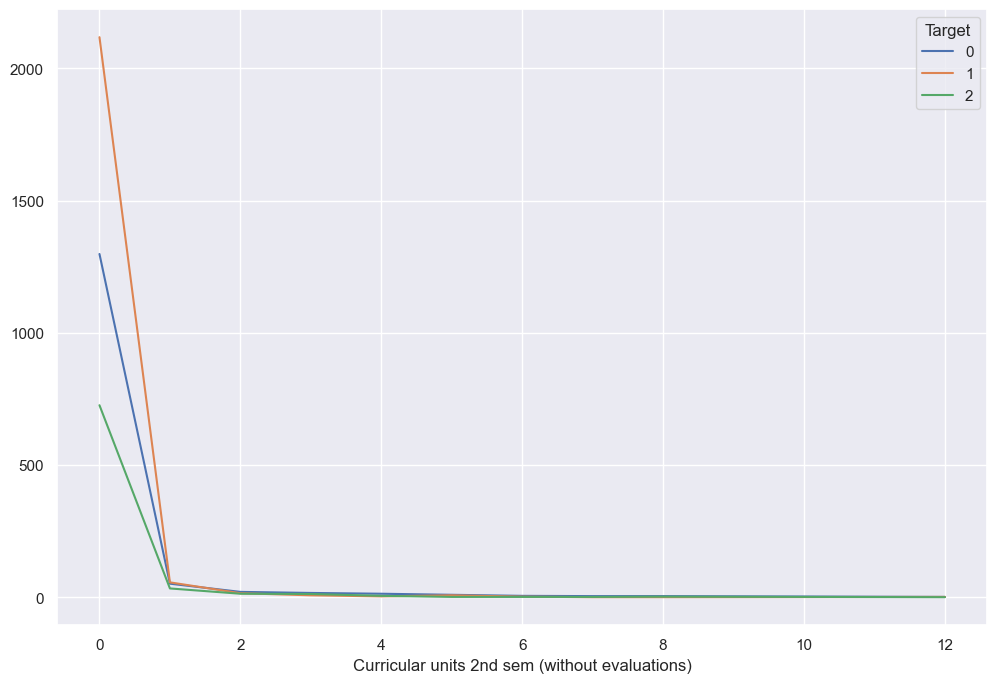

<Figure size 1500x600 with 0 Axes>

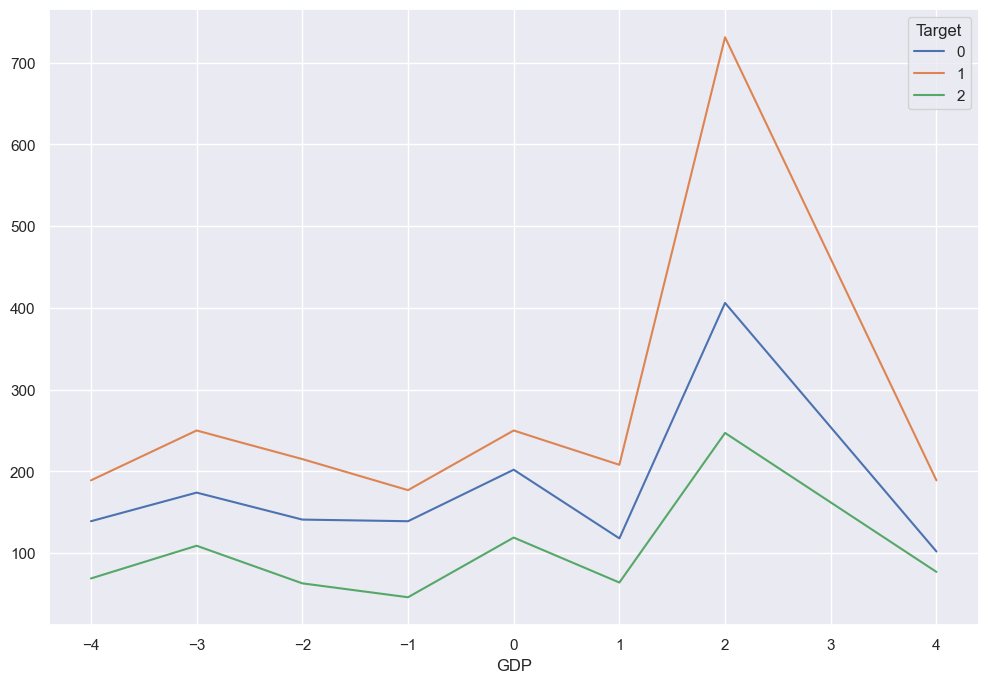

In [55]:
# creating line plots for cross-tabulations between each feature in df2 and the target variable Target.
# This can be a useful way to visualize the relationship between categorical variables and the target.
for i in df2.columns:
  plt.figure(figsize=(15,6))
  pd.crosstab(index=df2[i],columns=df1['Target']).plot(kind='line')
  plt.show()

In [56]:
df_corr = df1.corr()
df_corr

,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,Mother's occupation,Father's occupation,Admission grade,...,Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),GDP,Target
Course,1.000000,-0.043151,0.006654,-0.081073,-0.033923,0.054543,0.050724,0.031265,0.028881,-0.125120,...,0.388551,0.034514,-0.089817,0.401539,0.278797,0.198032,0.347852,0.030816,-0.022412,0.024210
Daytime/evening attendance\t,-0.043151,1.000000,-0.071871,0.052926,0.018530,-0.204767,-0.139894,-0.019067,-0.015477,0.008219,...,0.065506,0.045630,-0.111953,0.000371,0.014610,0.034022,0.050776,-0.004229,0.026390,0.066439
Previous qualification,0.006654,-0.071871,1.000000,0.103792,-0.029214,-0.013190,-0.006614,0.014822,0.016263,0.184318,...,0.000846,0.002887,0.143031,0.056179,0.114850,-0.008632,0.003527,0.005102,0.072609,-0.027984
Previous qualification (grade),-0.081073,0.052926,0.103792,1.000000,0.053903,-0.060908,-0.035358,-0.011535,-0.019378,0.581067,...,0.060965,-0.003963,-0.018421,-0.031591,-0.061337,0.050663,0.053656,-0.019093,-0.052347,0.025483
Nationality,-0.033923,0.018530,-0.029214,0.053903,1.000000,-0.049946,-0.085282,0.043187,0.020626,0.028349,...,0.000361,0.009145,-0.007278,-0.020113,-0.025721,-0.017880,-0.008845,-0.014041,0.036233,0.002098
Mother's qualification,0.054543,-0.204767,-0.013190,-0.060908,-0.049946,1.000000,0.535140,0.076772,0.052329,-0.054713,...,-0.035874,0.003183,0.042771,0.035150,0.021033,-0.014858,-0.031335,0.021305,-0.092137,-0.075941
Father's qualification,0.050724,-0.139894,-0.006614,-0.035358,-0.085282,0.535140,1.000000,0.054911,0.063043,-0.051956,...,-0.008875,-0.017333,0.042666,0.024380,0.009514,0.005285,-0.008949,-0.007430,-0.077705,-0.035183
Mother's occupation,0.031265,-0.019067,0.014822,-0.011535,0.043187,0.076772,0.054911,1.000000,0.910472,-0.040289,...,-0.015926,0.014218,0.000753,-0.006512,0.000633,-0.031861,-0.020585,0.013091,0.124583,0.051664
Father's occupation,0.028881,-0.015477,0.016263,-0.019378,0.020626,0.052329,0.063043,0.910472,1.000000,-0.037972,...,-0.008513,0.000043,-0.011025,-0.014098,-0.004087,-0.030411,-0.016155,-0.007664,0.131822,0.051455
Admission grade,-0.125120,0.008219,0.184318,0.581067,0.028349,-0.054713,-0.051956,-0.040289,-0.037972,1.000000,...,0.073476,0.008792,0.039645,-0.042061,-0.057253,0.076354,0.073982,-0.013346,-0.016403,0.038623


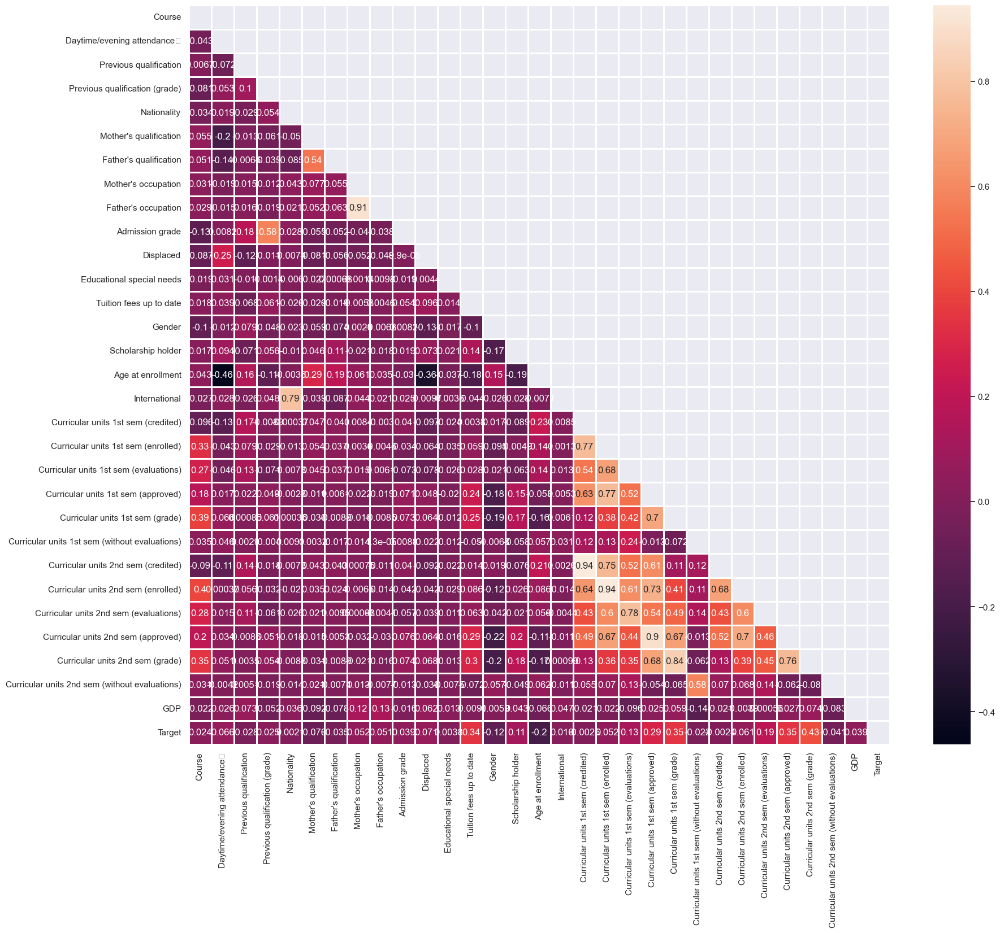

In [57]:
# Creating a heatmap of the correlation matrix (df_corr) using the seaborn library.
# This is a great way to visualize the correlation between different features in dataset.
plt.figure(figsize=(20, 17))
matrix = np.triu(df_corr)
sns.heatmap(df_corr, annot=True, linewidth=.8, mask=matrix, cmap="rocket");
plt.show()

# Predictive Models

## Model Training
<b> Before we proceed, we need to split the data into features (X) and the target variable (y). <br>
Additionally, we'll split the dataset into training and testing sets.<br>
Assuming 'Target' is the target variable, and we want to use all other columns as features, we can use the following codes to training data.The Preprocessing as following codes:

<b> 1) Defining Features and Label

In [59]:
# Assuming X contains features  
x = df1.drop(columns='Target', axis=1) # features
x.head()

,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,Mother's occupation,Father's occupation,Admission grade,...,Curricular units 1st sem (approved),Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),GDP
0,171,1,1,122,1,19,12,5,9,127,...,0,0,0,0,0,0,0,0,0,2
1,9254,1,1,160,1,1,3,3,3,142,...,6,14,0,0,6,6,6,14,0,1
2,9070,1,1,122,1,37,37,9,9,125,...,0,0,0,0,6,0,0,0,0,2
3,9773,1,1,122,1,38,37,5,3,120,...,6,13,0,0,6,10,5,12,0,-3
4,8014,0,1,100,1,37,38,9,9,142,...,5,12,0,0,6,6,6,13,0,1


In [60]:
# Assuming y contains the target variable
y = df1['Target'] # label
y.head()

0    0
1    1
2    0
3    1
4    1
Name: Target, dtype: int64

<b>2) Splitting the data into training data and testing data

In [61]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=2)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((3539, 30), (885, 30), (3539,), (885,))

<b>3) Training the model

<b> i) Using RandomForestClassifier Model
 

In [62]:
from sklearn.ensemble import RandomForestClassifier     ## import Model

In [63]:
modelRandomForestClassifier = RandomForestClassifier()   ##  Select a Model

In [64]:
modelRandomForestClassifier.fit(X_train, y_train)       ## Train the Model

RandomForestClassifier()

In [65]:
X_train_prediction_random_forest = modelRandomForestClassifier.predict(X_train)  ## Evaluate the Model

In [66]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Instantiate the model
model_rf = RandomForestClassifier()

# Train the model
model_rf.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_rf = model_rf.predict(X_train)

# Evaluate the model on training set
accuracy_train_rf = accuracy_score(y_train, y_train_pred_rf)
conf_matrix_train_rf = confusion_matrix(y_train, y_train_pred_rf)
class_report_train_rf = classification_report(y_train, y_train_pred_rf)

# Predictions on the testing set
y_test_pred_rf = model_rf.predict(X_test)

# Evaluate the model on testing set
accuracy_test_rf = accuracy_score(y_test, y_test_pred_rf)
conf_matrix_test_rf = confusion_matrix(y_test, y_test_pred_rf)
class_report_test_rf = classification_report(y_test, y_test_pred_rf)

# Display results for training set
print("Random Forest Classifier - Training Set:")
print(f"Training Accuracy: {accuracy_train_rf}")
print("Confusion Matrix:\n", conf_matrix_train_rf)
print("Classification Report:\n", class_report_train_rf)

# Display results for testing set
print("\nRandom Forest Classifier - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_rf}")
print("Confusion Matrix:\n", conf_matrix_test_rf)
print("Classification Report:\n", class_report_test_rf)


Random Forest Classifier - Training Set:
Training Accuracy: 1.0
Confusion Matrix:
 [[1140    0    0]
 [   0 1758    0]
 [   0    0  641]]
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1140
           1       1.00      1.00      1.00      1758
           2       1.00      1.00      1.00       641

    accuracy                           1.00      3539
   macro avg       1.00      1.00      1.00      3539
weighted avg       1.00      1.00      1.00      3539


Random Forest Classifier - Testing Set:
Testing Accuracy: 0.7740112994350282
Confusion Matrix:
 [[207  53  21]
 [ 15 417  19]
 [ 31  61  61]]
Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.74      0.78       281
           1       0.79      0.92      0.85       451
           2       0.60      0.40      0.48       153

    accuracy                           0.77       885
   macro avg      

<b>ii) Using DecisionTree Model

In [67]:
from sklearn.tree import DecisionTreeClassifier
modelDecisionTree = DecisionTreeClassifier()
modelDecisionTree.fit(X_train, y_train)

DecisionTreeClassifier()

In [68]:
from sklearn.tree import DecisionTreeClassifier

# Instantiate the model
model_decision_tree = DecisionTreeClassifier()

# Train the model
model_decision_tree.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_decision_tree = model_decision_tree.predict(X_train)

# Evaluate the model on training set
accuracy_train_decision_tree = accuracy_score(y_train, y_train_pred_decision_tree)
conf_matrix_train_decision_tree = confusion_matrix(y_train, y_train_pred_decision_tree)
class_report_train_decision_tree = classification_report(y_train, y_train_pred_decision_tree)

# Predictions on the testing set
y_test_pred_decision_tree = model_decision_tree.predict(X_test)

# Evaluate the model on testing set
accuracy_test_decision_tree = accuracy_score(y_test, y_test_pred_decision_tree)
conf_matrix_test_decision_tree = confusion_matrix(y_test, y_test_pred_decision_tree)
class_report_test_decision_tree = classification_report(y_test, y_test_pred_decision_tree)

# Display results for training set
print("Decision Tree - Training Set:")
print(f"Training Accuracy: {accuracy_train_decision_tree}")
print("Confusion Matrix:\n", conf_matrix_train_decision_tree)
print("Classification Report:\n", class_report_train_decision_tree)

# Display results for testing set
print("\nDecision Tree - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_decision_tree}")
print("Confusion Matrix:\n", conf_matrix_test_decision_tree)
print("Classification Report:\n", class_report_test_decision_tree)


Decision Tree - Training Set:
Training Accuracy: 1.0
Confusion Matrix:
 [[1140    0    0]
 [   0 1758    0]
 [   0    0  641]]
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1140
           1       1.00      1.00      1.00      1758
           2       1.00      1.00      1.00       641

    accuracy                           1.00      3539
   macro avg       1.00      1.00      1.00      3539
weighted avg       1.00      1.00      1.00      3539


Decision Tree - Testing Set:
Testing Accuracy: 0.6734463276836158
Confusion Matrix:
 [[187  45  49]
 [ 37 353  61]
 [ 39  58  56]]
Classification Report:
               precision    recall  f1-score   support

           0       0.71      0.67      0.69       281
           1       0.77      0.78      0.78       451
           2       0.34      0.37      0.35       153

    accuracy                           0.67       885
   macro avg       0.61      0.60      0

<b>iii) Using Support Vector Machine

In [69]:
from sklearn import svm
modelSVM = svm.SVC()
modelSVM.fit(X_train, y_train)

SVC()

In [70]:
from sklearn.svm import SVC

# Instantiate the model
model_svm = SVC()

# Train the model
model_svm.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_svm = model_svm.predict(X_train)

# Evaluate the model on training set
accuracy_train_svm = accuracy_score(y_train, y_train_pred_svm)
conf_matrix_train_svm = confusion_matrix(y_train, y_train_pred_svm)
class_report_train_svm = classification_report(y_train, y_train_pred_svm)

# Predictions on the testing set
y_test_pred_svm = model_svm.predict(X_test)

# Evaluate the model on testing set
accuracy_test_svm = accuracy_score(y_test, y_test_pred_svm)
conf_matrix_test_svm = confusion_matrix(y_test, y_test_pred_svm)
class_report_test_svm = classification_report(y_test, y_test_pred_svm)

# Display results for training set
print("Support Vector Machine - Training Set:")
print(f"Training Accuracy: {accuracy_train_svm}")
print("Confusion Matrix:\n", conf_matrix_train_svm)
print("Classification Report:\n", class_report_train_svm)

# Display results for testing set
print("\nSupport Vector Machine - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_svm}")
print("Confusion Matrix:\n", conf_matrix_test_svm)
print("Classification Report:\n", class_report_test_svm)


Support Vector Machine - Training Set:
Training Accuracy: 0.49675049448996894
Confusion Matrix:
 [[   0 1140    0]
 [   0 1758    0]
 [   0  641    0]]
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00      1140
           1       0.50      1.00      0.66      1758
           2       0.00      0.00      0.00       641

    accuracy                           0.50      3539
   macro avg       0.17      0.33      0.22      3539
weighted avg       0.25      0.50      0.33      3539


Support Vector Machine - Testing Set:
Testing Accuracy: 0.5096045197740113
Confusion Matrix:
 [[  0 281   0]
 [  0 451   0]
 [  0 153   0]]
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       281
           1       0.51      1.00      0.68       451
           2       0.00      0.00      0.00       153

    accuracy                           0.51       885
   mac

<b>iv) Using AdaBoost Model

In [71]:
from sklearn.ensemble import AdaBoostClassifier

# Instantiate the model
model_adaboost = AdaBoostClassifier()

# Train the model
model_adaboost.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_adaboost = model_adaboost.predict(X_train)

# Evaluate the model on the training set
accuracy_train_adaboost = accuracy_score(y_train, y_train_pred_adaboost)
conf_matrix_train_adaboost = confusion_matrix(y_train, y_train_pred_adaboost)
class_report_train_adaboost = classification_report(y_train, y_train_pred_adaboost)

# Predictions on the testing set
y_test_pred_adaboost = model_adaboost.predict(X_test)

# Evaluate the model on the testing set
accuracy_test_adaboost = accuracy_score(y_test, y_test_pred_adaboost)
conf_matrix_test_adaboost = confusion_matrix(y_test, y_test_pred_adaboost)
class_report_test_adaboost = classification_report(y_test, y_test_pred_adaboost)

# Display results for training set
print("AdaBoost - Training Set:")
print(f"Training Accuracy: {accuracy_train_adaboost}")
print("Confusion Matrix:\n", conf_matrix_train_adaboost)
print("Classification Report:\n", class_report_train_adaboost)

# Display results for testing set
print("\nAdaBoost - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_adaboost}")
print("Confusion Matrix:\n", conf_matrix_test_adaboost)
print("Classification Report:\n", class_report_test_adaboost)


AdaBoost - Training Set:
Training Accuracy: 0.7657530375812376
Confusion Matrix:
 [[ 880  114  146]
 [  64 1571  123]
 [ 152  230  259]]
Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.77      0.79      1140
           1       0.82      0.89      0.86      1758
           2       0.49      0.40      0.44       641

    accuracy                           0.77      3539
   macro avg       0.70      0.69      0.70      3539
weighted avg       0.76      0.77      0.76      3539


AdaBoost - Testing Set:
Testing Accuracy: 0.7548022598870057
Confusion Matrix:
 [[201  47  33]
 [ 22 404  25]
 [ 31  59  63]]
Classification Report:
               precision    recall  f1-score   support

           0       0.79      0.72      0.75       281
           1       0.79      0.90      0.84       451
           2       0.52      0.41      0.46       153

    accuracy                           0.75       885
   macro avg       0.70      0.67  

<b>v) Using Neural Network Model

In [72]:
from sklearn.neural_network import MLPClassifier

# Instantiate the model
model_neural_network = MLPClassifier()

# Train the model
model_neural_network.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_nn = model_neural_network.predict(X_train)

# Evaluate the model on the training set
accuracy_train_nn = accuracy_score(y_train, y_train_pred_nn)
conf_matrix_train_nn = confusion_matrix(y_train, y_train_pred_nn)
class_report_train_nn = classification_report(y_train, y_train_pred_nn)

# Predictions on the testing set
y_test_pred_nn = model_neural_network.predict(X_test)

# Evaluate the model on the testing set
accuracy_test_nn = accuracy_score(y_test, y_test_pred_nn)
conf_matrix_test_nn = confusion_matrix(y_test, y_test_pred_nn)
class_report_test_nn = classification_report(y_test, y_test_pred_nn)

# Display results for training set
print("Neural Network - Training Set:")
print(f"Training Accuracy: {accuracy_train_nn}")
print("Confusion Matrix:\n", conf_matrix_train_nn)
print("Classification Report:\n", class_report_train_nn)

# Display results for testing set
print("\nNeural Network - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_nn}")
print("Confusion Matrix:\n", conf_matrix_test_nn)
print("Classification Report:\n", class_report_test_nn)


Neural Network - Training Set:
Training Accuracy: 0.6210794009607233
Confusion Matrix:
 [[ 909  110  121]
 [ 382 1108  268]
 [ 328  132  181]]
Classification Report:
               precision    recall  f1-score   support

           0       0.56      0.80      0.66      1140
           1       0.82      0.63      0.71      1758
           2       0.32      0.28      0.30       641

    accuracy                           0.62      3539
   macro avg       0.57      0.57      0.56      3539
weighted avg       0.65      0.62      0.62      3539


Neural Network - Testing Set:
Testing Accuracy: 0.5977401129943503
Confusion Matrix:
 [[199  38  44]
 [110 279  62]
 [ 70  32  51]]
Classification Report:
               precision    recall  f1-score   support

           0       0.53      0.71      0.60       281
           1       0.80      0.62      0.70       451
           2       0.32      0.33      0.33       153

    accuracy                           0.60       885
   macro avg       0.55

<b> vi) Logistic Regression Model

In [73]:
from sklearn.linear_model import LogisticRegression

# Instantiate the model
model_logistic_regression = LogisticRegression()

# Train the model
model_logistic_regression.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_lr = model_logistic_regression.predict(X_train)

# Evaluate the model on the training set
accuracy_train_lr = accuracy_score(y_train, y_train_pred_lr)
conf_matrix_train_lr = confusion_matrix(y_train, y_train_pred_lr)
class_report_train_lr = classification_report(y_train, y_train_pred_lr)

# Predictions on the testing set
y_test_pred_lr = model_logistic_regression.predict(X_test)

# Evaluate the model on the testing set
accuracy_test_lr = accuracy_score(y_test, y_test_pred_lr)
conf_matrix_test_lr = confusion_matrix(y_test, y_test_pred_lr)
class_report_test_lr = classification_report(y_test, y_test_pred_lr)

# Display results for training set
print("Logistic Regression - Training Set:")
print(f"Training Accuracy: {accuracy_train_lr}")
print("Confusion Matrix:\n", conf_matrix_train_lr)
print("Classification Report:\n", class_report_train_lr)

# Display results for testing set
print("\nLogistic Regression - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_lr}")
print("Confusion Matrix:\n", conf_matrix_test_lr)
print("Classification Report:\n", class_report_test_lr)


Logistic Regression - Training Set:
Training Accuracy: 0.6798530658378072
Confusion Matrix:
 [[ 745  394    1]
 [ 100 1654    4]
 [ 130  504    7]]
Classification Report:
               precision    recall  f1-score   support

           0       0.76      0.65      0.70      1140
           1       0.65      0.94      0.77      1758
           2       0.58      0.01      0.02       641

    accuracy                           0.68      3539
   macro avg       0.67      0.54      0.50      3539
weighted avg       0.67      0.68      0.61      3539


Logistic Regression - Testing Set:
Testing Accuracy: 0.6802259887005649
Confusion Matrix:
 [[172 107   2]
 [ 27 424   0]
 [ 33 114   6]]
Classification Report:
               precision    recall  f1-score   support

           0       0.74      0.61      0.67       281
           1       0.66      0.94      0.77       451
           2       0.75      0.04      0.07       153

    accuracy                           0.68       885
   macro avg 

### Creating a dataframe out of all the Scores of the all models

In [74]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

# Dictionary to store results
results = {
    "Model": [],
    "Train Accuracy": [],
    "Test Accuracy": [],
    "Train Precision": [],
    "Test Precision": [],
    "Train Recall": [],
    "Test Recall": [],
    "Train F1-Score": [],
    "Test F1-Score": [],
}

# List of models to try
models = {
    "Random Forest": RandomForestClassifier(),
    "SVM": SVC(),
    "AdaBoost": AdaBoostClassifier(),
    "Neural Network": MLPClassifier(),
    "Logistic Regression": LogisticRegression(),
    "Decision Tree": DecisionTreeClassifier(),
}

# Train and evaluate each model
for name, model in models.items():
    print(f"Training and evaluating {name}...")
    
    # Train the model
    model.fit(X_train, y_train)
    
    # Predictions on the training set
    y_train_pred = model.predict(X_train)
    
    # Predictions on the testing set
    y_test_pred = model.predict(X_test)
    
    # Calculate metrics
    accuracy_train = accuracy_score(y_train, y_train_pred)
    accuracy_test = accuracy_score(y_test, y_test_pred)
    
    precision_train = precision_score(y_train, y_train_pred, average='weighted')
    precision_test = precision_score(y_test, y_test_pred, average='weighted')
    
    recall_train = recall_score(y_train, y_train_pred, average='weighted')
    recall_test = recall_score(y_test, y_test_pred, average='weighted')
    
    f1_train = f1_score(y_train, y_train_pred, average='weighted')
    f1_test = f1_score(y_test, y_test_pred, average='weighted')
    
    # Store results in the dictionary
    results["Model"].append(name)
    results["Train Accuracy"].append(accuracy_train)
    results["Test Accuracy"].append(accuracy_test)
    results["Train Precision"].append(precision_train)
    results["Test Precision"].append(precision_test)
    results["Train Recall"].append(recall_train)
    results["Test Recall"].append(recall_test)
    results["Train F1-Score"].append(f1_train)
    results["Test F1-Score"].append(f1_test)
    
    # Display results
    print(f"\n{30*'='}\n{name}\n{30*'='}")
    print(f"Training Accuracy: {accuracy_train}")
    print(f"Testing Accuracy: {accuracy_test}")
    print(f"Training Precision: {precision_train}")
    print(f"Testing Precision: {precision_test}")
    print(f"Training Recall: {recall_train}")
    print(f"Testing Recall: {recall_test}")
    print(f"Training F1-Score: {f1_train}")
    print(f"Testing F1-Score: {f1_test}")
    print("\n\n")

# Create a DataFrame from the results dictionary
results_df = pd.DataFrame(results)

# Display the DataFrame
print(results_df)


Training and evaluating Random Forest...

Random Forest
Training Accuracy: 1.0
Testing Accuracy: 0.7548022598870057
Training Precision: 1.0
Testing Precision: 0.7336723219612292
Training Recall: 1.0
Testing Recall: 0.7548022598870057
Training F1-Score: 1.0
Testing F1-Score: 0.735438605097648



Training and evaluating SVM...

SVM
Training Accuracy: 0.5060751624752755
Testing Accuracy: 0.47231638418079097
Training Precision: 0.2561120700743765
Testing Precision: 0.22308276676561653
Training Recall: 0.5060751624752755
Testing Recall: 0.47231638418079097
Training F1-Score: 0.3401052968079619
Testing F1-Score: 0.3030364521681821



Training and evaluating AdaBoost...

AdaBoost
Training Accuracy: 0.7714043515117265
Testing Accuracy: 0.7401129943502824
Training Precision: 0.755746200006817
Testing Precision: 0.7203285364923975
Training Recall: 0.7714043515117265
Testing Recall: 0.7401129943502824
Training F1-Score: 0.7593706258287294
Testing F1-Score: 0.724692283167532



Training and evalua

In [75]:
results_df

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1-Score,Test F1-Score
0,Random Forest,1.000000,0.754802,1.000000,0.733672,1.000000,0.754802,1.000000,0.735439
1,SVM,0.506075,0.472316,0.256112,0.223083,0.506075,0.472316,0.340105,0.303036
2,AdaBoost,0.771404,0.740113,0.755746,0.720329,0.771404,0.740113,0.759371,0.724692
3,Neural Network,0.234530,0.221469,0.675920,0.736883,0.234530,0.221469,0.160063,0.150578
4,Logistic Regression,0.687482,0.677966,0.671771,0.669304,0.687482,0.677966,0.631829,0.621715
5,Decision Tree,1.000000,0.697175,1.000000,0.696977,1.000000,0.697175,1.000000,0.697018


### Explore Results

#### Exploring the results of a predictive modeling project involves analyzing various aspects to gain insights into the model's performance and understand its behavior. Here are some common steps in exploring results:

<b>1. Extract and display feature importances and visualizea feature importance with a bar plot

                                           Feature  Importance
26             Curricular units 2nd sem (approved)    0.363401
9                                  Admission grade    0.055482
3                   Previous qualification (grade)    0.047519
15                               Age at enrollment    0.045556
12                         Tuition fees up to date    0.043740
0                                           Course    0.039446
19          Curricular units 1st sem (evaluations)    0.036829
25          Curricular units 2nd sem (evaluations)    0.036162
8                              Father's occupation    0.035284
29                                             GDP    0.032495
20             Curricular units 1st sem (approved)    0.030018
18             Curricular units 1st sem (enrolled)    0.028671
27                Curricular units 2nd sem (grade)    0.028558
7                              Mother's occupation    0.027195
5                           Mother's qualification    0

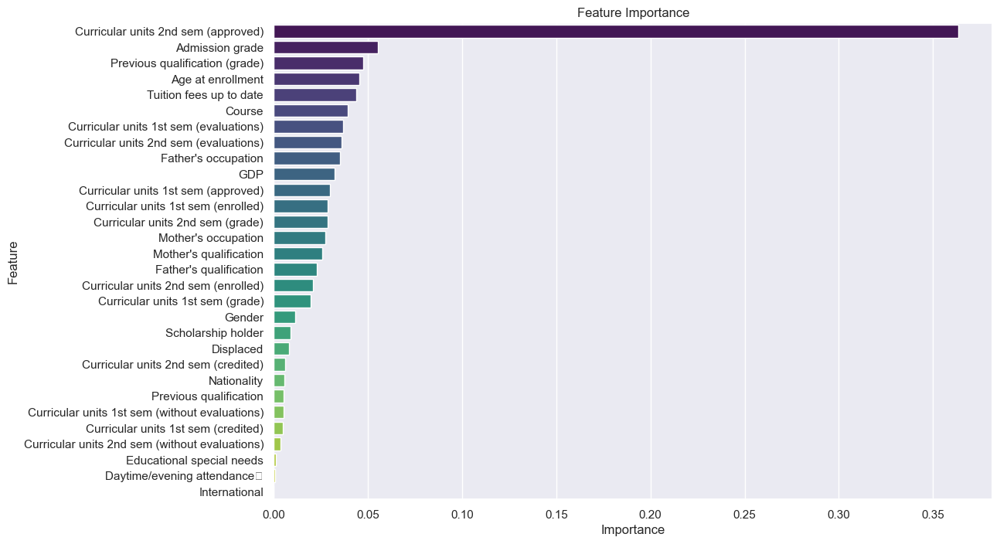

In [76]:
# Assuming 'model' is trained model (e.g., RandomForestClassifier)
feature_importances = model.feature_importances_

# Create a DataFrame to display feature importance scores
feature_importance_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': feature_importances
})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Print the feature importance DataFrame
print(feature_importance_df)

# Visualize feature importance with a bar plot
plt.figure(figsize=(12, 8))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis')
plt.title('Feature Importance')
plt.show()


In [77]:
## displays the feature importances of the model
feature_importance_df

,Feature,Importance
26,Curricular units 2nd sem (approved),0.363401
9,Admission grade,0.055482
3,Previous qualification (grade),0.047519
15,Age at enrollment,0.045556
12,Tuition fees up to date,0.043740
0,Course,0.039446
19,Curricular units 1st sem (evaluations),0.036829
25,Curricular units 2nd sem (evaluations),0.036162
8,Father's occupation,0.035284
29,GDP,0.032495


<b>2. Classification Report<br>
<b> Generate a classification report to get precision, recall, and F1-score for each class.

In [78]:

from sklearn.metrics import classification_report

# Assign best model to a clear variable
best_model = model_rf
class_report = classification_report(y_train, y_train_pred_rf)
print(class_report)



              precision    recall  f1-score   support

           0       0.31      0.32      0.31      1105
           1       0.50      0.49      0.50      1791
           2       0.16      0.16      0.16       643

    accuracy                           0.38      3539
   macro avg       0.32      0.32      0.32      3539
weighted avg       0.38      0.38      0.38      3539



<b>3. Correlation of each feature in the DataFrame  with the target variable 'Target' and then plots these correlations in a bar chart

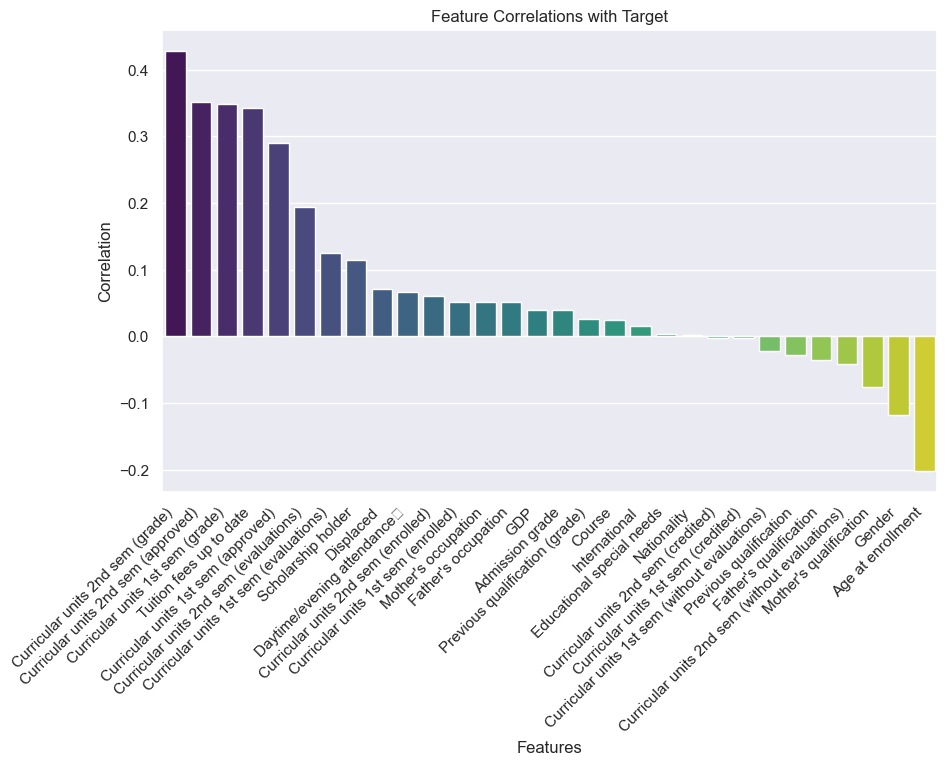

In [79]:
# Assuming 'df1' contains both features and the target variable 'Target'
correlation_with_target = df1.corr()['Target'].sort_values(ascending=False)

# Set up the matplotlib figure size
plt.figure(figsize=(10, 6))

# Plot the correlations with the target (excluding the target itself)
correlation_with_target.drop('Target').plot(kind='bar')
sns.barplot(x=correlation_with_target.drop('Target').index, y=correlation_with_target.drop('Target').values, palette='viridis')

# Add a title to the bar chart
plt.title("Feature Correlations with Target")

# Add labels to the x and y axes
plt.xlabel("Features")
plt.ylabel("Correlation")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility

# Display the bar chart
plt.show()


#  Conclusion


<b> From the above table, it is clear that the best model out all of them is the 'RandomForestClassifier' model, because it's test accuracy is the highest out of all of them, with an accuracy of 77%. This makes the 'RandomForestClassifier' model the best performing one, because it is the most likely to make an accurate prediction.

In [80]:
import platform
import os
from datetime import datetime
import getpass

# Get system information
system_info = {
    'System': platform.system(),
    'Release': platform.release(),
    'Version': platform.version(),
    'Architecture': platform.architecture(),
    'Processor': platform.processor(),
    'Python Version': platform.python_version(),
    'Username': getpass.getuser(),
    'Current Working Directory': os.getcwd(),
    'Last Update': datetime.now().strftime("%Y-%m-%d %H:%M:%S"),
}

# Display system information
for key, value in system_info.items():
    print(f"{key}: {value}")


System: Windows
Release: 10
Version: 10.0.22621
Architecture: ('64bit', 'WindowsPE')
Processor: Intel64 Family 6 Model 140 Stepping 1, GenuineIntel
Python Version: 3.9.12
Username: naiem
Current Working Directory: C:\Users\naiem\OneDrive\Desktop\CAPSTONE PROJ_ 44-688\Capstone-Project
Last Update: 2023-11-20 00:26:13
